In [1]:
import os
import pandas as pd
import re
import scanpy as sc
import scConnect as cn
cn.database.version="2020-5"

import seaborn as sns
import numpy as np
import scvelo as scv
import pyranges as pr
import matplotlib.pyplot as plt
import matplotlib
import plotly.express as px
import networkx as nx

new_style = {'grid': False}
matplotlib.rc('axes', **new_style)

sc.set_figure_params(fontsize=15, vector_friendly=False)

date = "210909"
figure="Figure1"
sc.settings.figdir=f"figures/{date}/{figure}"

matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
#sc.logging.print_versions()

# Set color maps for fish and mouse pltting
cmap_fish = px.colors.sequential.Greens
cmap_mouse = px.colors.sequential.Reds

In [2]:
# create folders nessesary
folders = [
    "Supplimentary files", 
    "preprocessing",
    "level_0",
    "level_1",
    "dmrt3",
    "compare_pop",
    "velocyto",
    "gene_lists"
       ]
for folder in folders:
    os.makedirs(f"figures/{date}/{folder}", exist_ok=True)


# Load Mouse Data
As Velocyto mapper have issues detecting manually added genes with short flanking sequences (tdTomato, eGFP and ercc genes) The counts are taken from featureCounts with the X layer as counts and the RPKM as a layer. From velocyto, we have added the spliced and unspliced layers.


In [3]:
# Load the full dataset from velocyto loom
adata_m = sc.read_loom("data/mmusculus.loom", sparse=False)

#Set RPKM as X
adata_m.X = adata_m.layers["RPKM"]
#adata_m.var_names = list(adata_m.var["var_names"])
#adata_m.obs_names = list(adata_m.obs["obs_names"])
adata_m.var_names_make_unique()
adata_m.obs_names_make_unique()


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


# Run preprocessing for Mouse
Here we run initial QC metric calculation, filtering, clustering and annotation of cell populations

In [4]:
# Find motochondrial genes
mito = sc.queries.mitochondrial_genes('mmusculus')
mito = list(mito.external_gene_name)

# add mitochondial gene annotation to adata.var
adata_m.var["mito"] = [True if gene in mito else False for gene in adata_m.var_names]
print(f"detected {adata_m.var['mito'].sum()} mito genes")

detected 37 mito genes


In [5]:
# add ercc gene annotation to adata.var
adata_m.var["ERCC"] = [True if gene.startswith("ERCC-") else False for gene in adata_m.var_names]
print(f"detected {adata_m.var['ERCC'].sum()} ERCC genes")

#Run QC with mito and ERCC variables
sc.pp.calculate_qc_metrics(adata_m, inplace=True , qc_vars=["mito", "ERCC"])

detected 92 ERCC genes


In [6]:
# Find all genes that were artificaially added and should not help drive clustering of the cells
ercc_genes = [gene for gene in adata_m.var_names if gene.startswith("ERCC-")]
added_genes = ["tdTomato", "iCre"]

# All of these will be removed from the adata object
remove_genes = ercc_genes+added_genes

In [7]:
# Transfer the added genes as observations and trasform with log1p
for gene in added_genes:
    values = adata_m.obs_vector(gene)
    adata_m.obs[gene] = np.log1p(values)

In [8]:
# Remove all ercc and added genes
adata_m = adata_m[:,[gene for gene in adata_m.var_names if gene not in remove_genes]].copy()

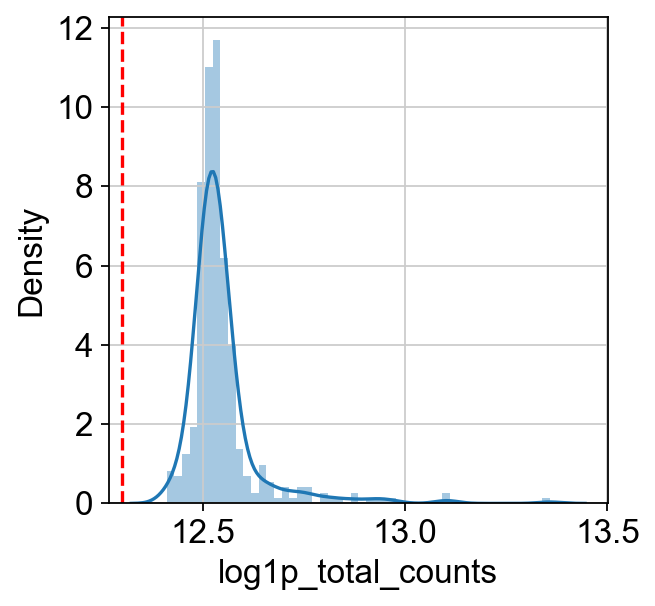

In [9]:
# filter on total counts detected per cell (log)

tc_th = 12.3
g = sns.distplot(adata_m.obs['log1p_total_counts'])
plt.axvline(tc_th, color="r", linestyle="--")

f_count = adata_m.obs_vector('log1p_total_counts') > tc_th
plt.savefig(f"figures/{date}/preprocessing/filtering_mouse_tot_counts.pdf")

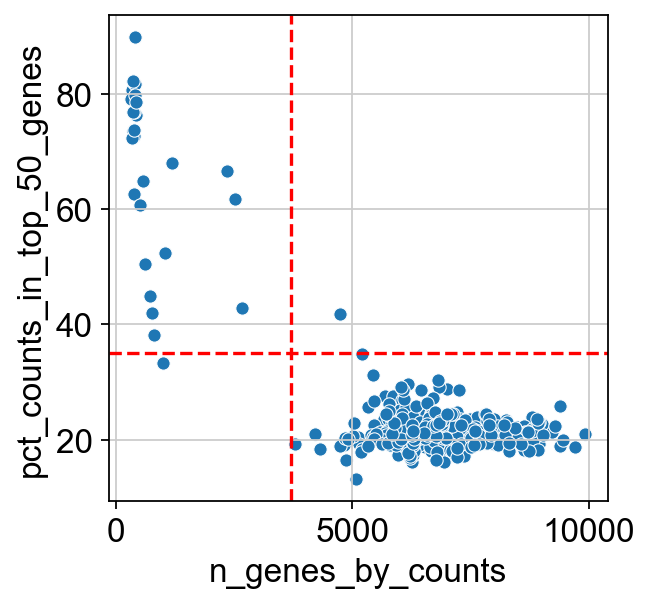

In [10]:
# filter on percent reads in top 50 genes
pt50_th = 35

# filter on number of genes expressed by cells
gpc_th = 3700

g = sns.scatterplot('n_genes_by_counts', 'pct_counts_in_top_50_genes', data=adata_m.obs)
plt.axvline(gpc_th, color="r", linestyle="--")
plt.axhline(pt50_th, color="r", linestyle="--")


f_dist = adata_m.obs_vector('pct_counts_in_top_50_genes') < pt50_th # filter cells with distributed gene counts
f_capt = adata_m.obs_vector('n_genes_by_counts') > gpc_th # filter cells with broad gene capture
plt.savefig(f"figures/{date}/preprocessing/filtering_mouse_n-gene-pct50.pdf")


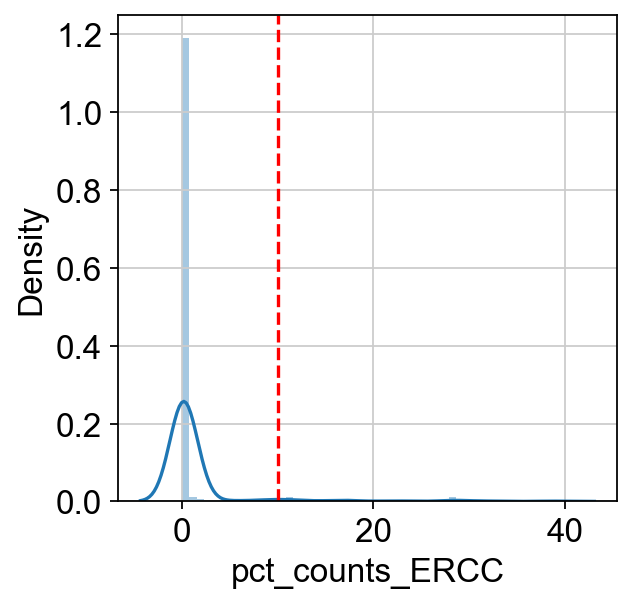

In [11]:
# filter on percent of reads mapping to ercc genes
pce_th = 10
g = sns.distplot(adata_m.obs["pct_counts_ERCC"])
plt.axvline(pce_th, color="r", linestyle="--")

f_ercc = adata_m.obs_vector("pct_counts_ERCC") < pce_th # less than 10% ERCC counts
plt.savefig(f"figures/{date}/preprocessing/filtering_mouse_ercc.pdf")

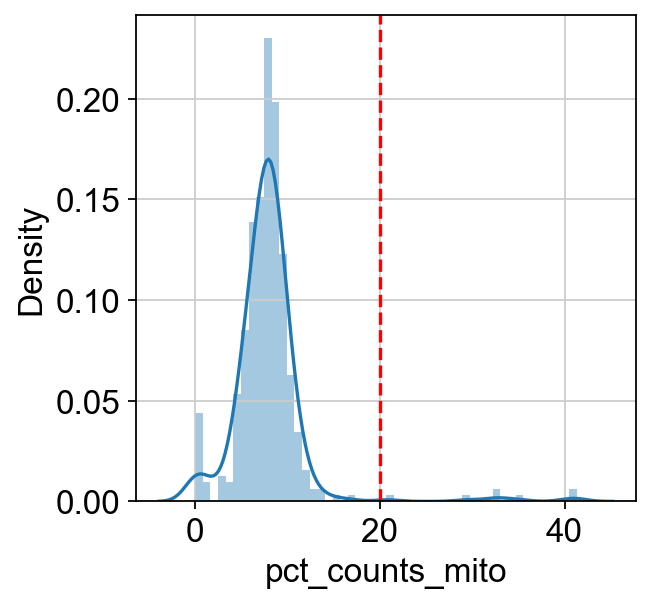

In [12]:
# filter on percent reads mapping to mitochondria genes
pcm_th = 20
g = sns.distplot(adata_m.obs["pct_counts_mito"])
plt.axvline(pcm_th, color="r", linestyle="--")
f_mito = adata_m.obs_vector("pct_counts_mito") < pcm_th
plt.savefig(f"figures/{date}/preprocessing/filtering_mouse_mito.pdf")

In [13]:
adata_m.write_loom(f"figures/{date}/Supplimentary files/mouse_unprocessed.loom")

print(f"Cells before: {adata_m.shape[0]}, genes before: {adata_m.shape[1]}")
#f_count, f_dist, f_capt, f_ercc, f_mito
f1 = np.logical_and(f_count, f_dist)
f2 = np.logical_and(f_capt, f_ercc)
f3 = np.logical_and(f2, f_mito)
f = np.logical_and(f1,f3)
adata_m = adata_m[f]
sc.pp.filter_genes(adata_m, min_counts=1)
print(f"Cells after: {adata_m.shape[0]}, genes after: {adata_m.shape[1]}")

adata_m.write_loom(f"figures/{date}/Supplimentary files/mouse_filtered.loom")

Trying to set attribute `.var` of view, copying.


Cells before: 384, genes before: 55487
Cells after: 354, genes after: 32108


In [14]:
# find number of genes detected per cell
gene_counts_m = np.sum(adata_m.X>0,axis=1)
gene_mean_m = np.mean(gene_counts_m)
gene_std_m = np.std(gene_counts_m)
print(f"mean reads/cells: {gene_mean_m}")
print(f"std reads/cell: {gene_std_m}")

mean reads/cells: 6960.765536723164
std reads/cell: 1065.0172826102919


In [15]:
# Skip normalization as we are using RPKM which has already normalized cell size
#sc.pp.normalize_total(adata_m, exclude_highly_expressed=True)

In [16]:
# Log and save in raw
sc.pp.log1p(adata_m)
#adata_m.raw = adata_m


... storing 'Chromosome' as categorical


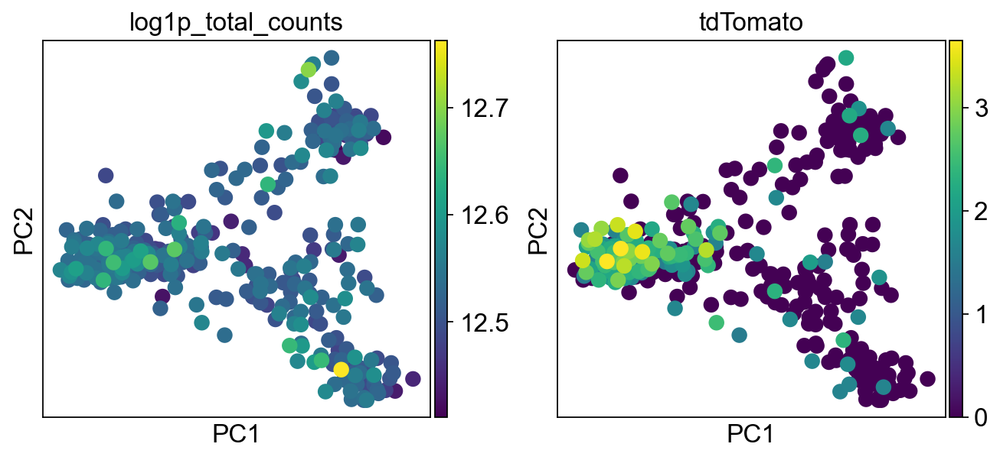

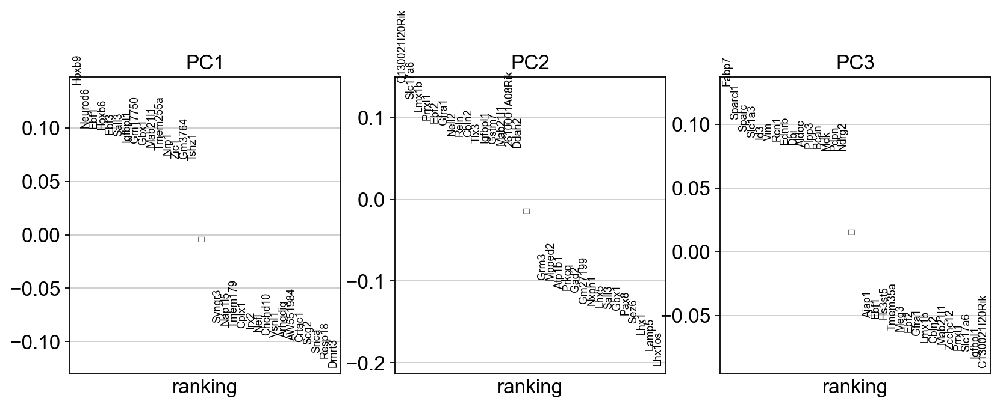

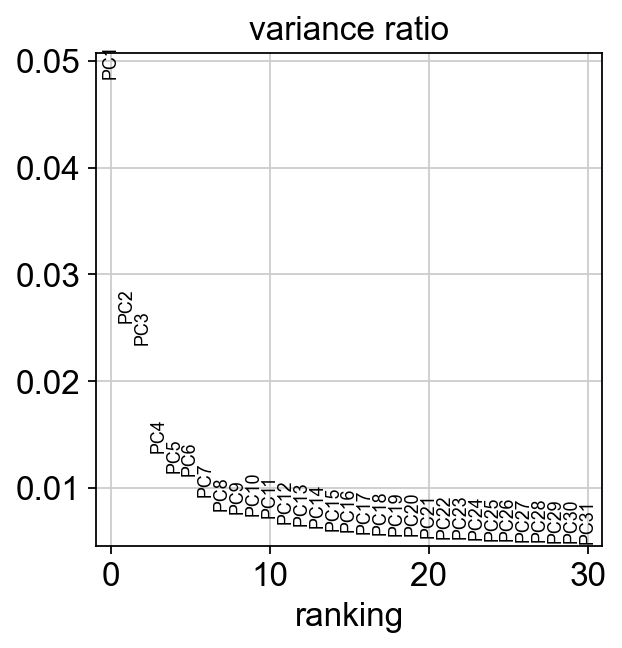

In [17]:
sc.pp.highly_variable_genes(adata_m, n_top_genes=5000)
sc.pp.pca(adata_m, use_highly_variable=True)
sc.pl.pca_overview(adata_m, color=["log1p_total_counts", "tdTomato"])

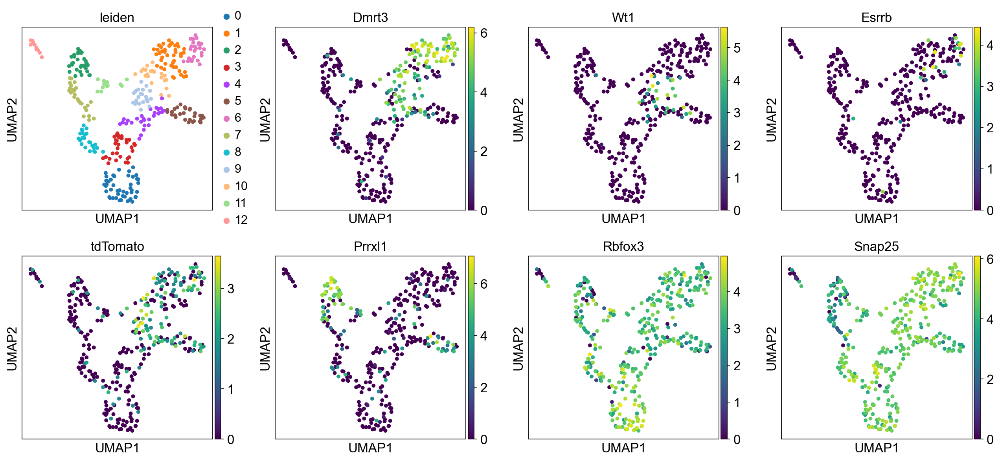

In [18]:
sc.pp.neighbors(adata_m, n_pcs=6, n_neighbors=10, method="umap")
sc.tl.leiden(adata_m, resolution=1)
sc.tl.umap(adata_m, random_state=1)
sc.pl.umap(adata_m, color=["leiden","Dmrt3", "Wt1", "Esrrb","tdTomato", "Prrxl1", "Rbfox3", "Snap25"], return_fig=True, size=80)
plt.savefig(f"figures/{date}/level_0/level_0_mouse_overview_scatterplot.pdf")

In [19]:
#function remove genes that are not present in adata to mitigate errors
def filter_dict(adata, gene_dict, verbose=True):
    filtered_dict = dict()
    for k, v in gene_dict.items():
        gene_list = list()
        for gene in v:
            # Check if gene in var_names
            if gene in list(adata.var_names):
                gene_list.append(gene)
            # Check if gene has been added as an observation
            elif gene in list(adata.obs.columns):
                gene_list.append(gene)
            else: 
                if verbose:
                    print(f"mitigated {k} gene: {gene}")
        if len(gene_list) > 0:
            filtered_dict[k] = gene_list
    return filtered_dict

In [20]:
# Search for non neuronal cells in dataset
non_neuronal_cells_zeisel = {
    "Vascular leptomeningeal cells": ["Mgp", "Slc47a1", "Dapl1"],
    "Pericytes": ["Higd1b", "Degs2", "Ndufa4l2", "Rgs5", "Flt1"],
    "Vascular endothelial cells, arterial": ["Igf2", "Sema3g", "Gkn3"]  ,
    "Astrocyte, protoplasmic": ["Slc7a10", "Mfsd2a"],
    "Astrocyte, fibrous": ["Agt", "Apoc1"],
    "Microglia": ["P2ry12", "Ccr6"],
    "Microglia, activated": ["Tmem119", "Casp8", "Ccl4", "Tnf"],
    "Perivascular macrophages": ["Pf4", "Cd74"],
}

mitigated Vascular leptomeningeal cells gene: Slc47a1
mitigated Astrocyte, fibrous gene: Apoc1
mitigated Microglia, activated gene: Ccl4
mitigated Microglia, activated gene: Tnf


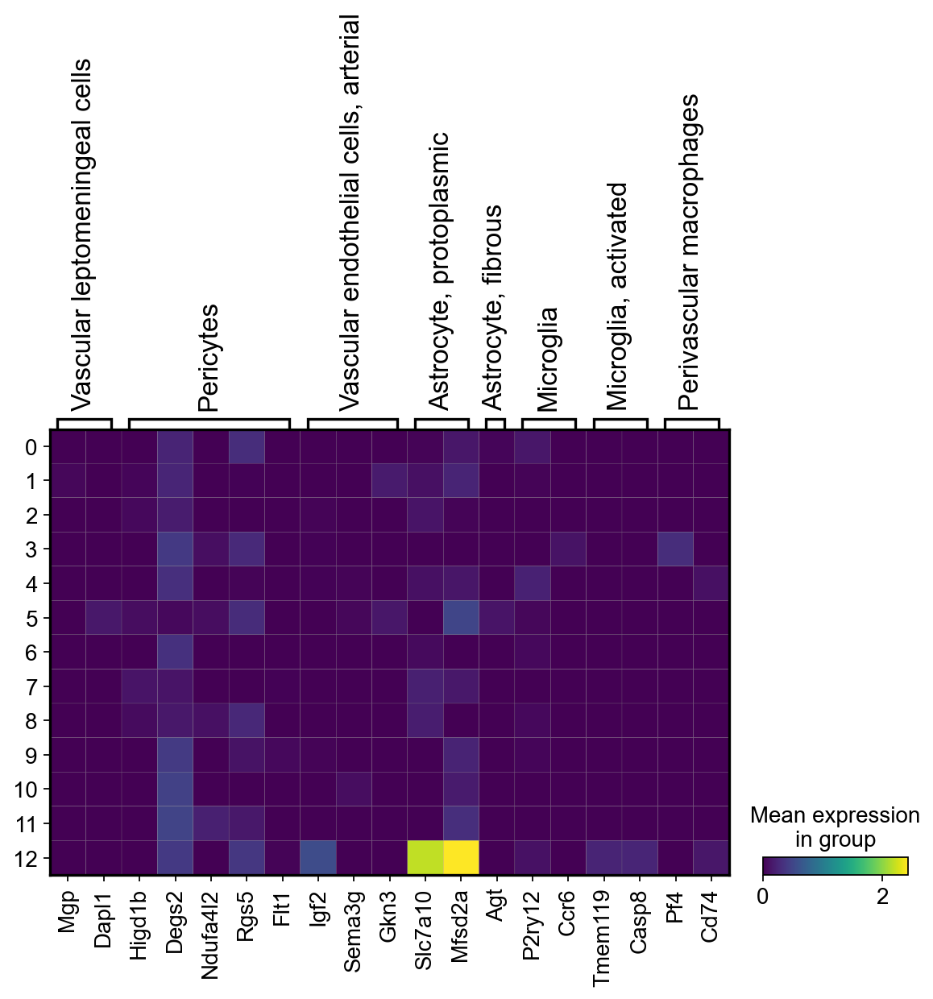

In [21]:

figure="level_0"
sc.settings.figdir=f"figures/{date}/{figure}"
sc.pl.matrixplot(adata_m, groupby="leiden", var_names=filter_dict(adata_m, non_neuronal_cells_zeisel), save="_non_neuronal_cells_mouse.pdf")

## Level 1 annotation - cell type - mouse

categories: 0, 1, 2, etc.
var_group_labels: Neuronal, Dmrt3 related, Inhibitory, etc.


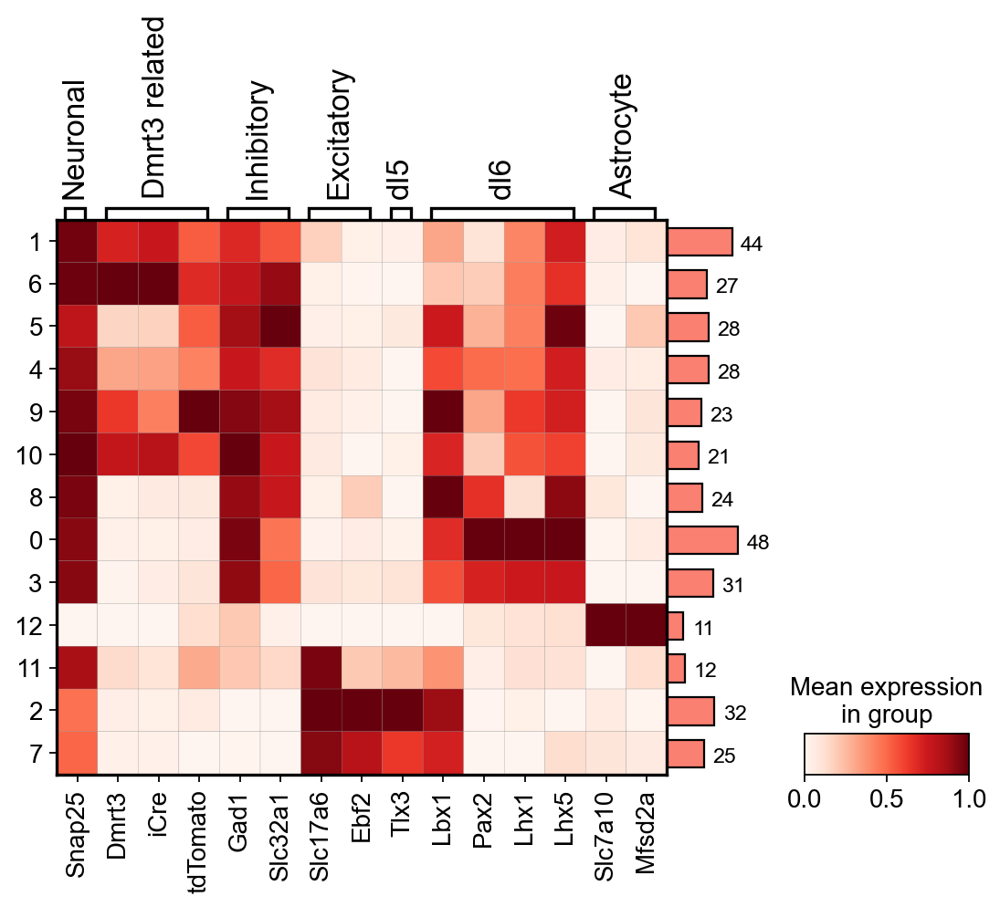

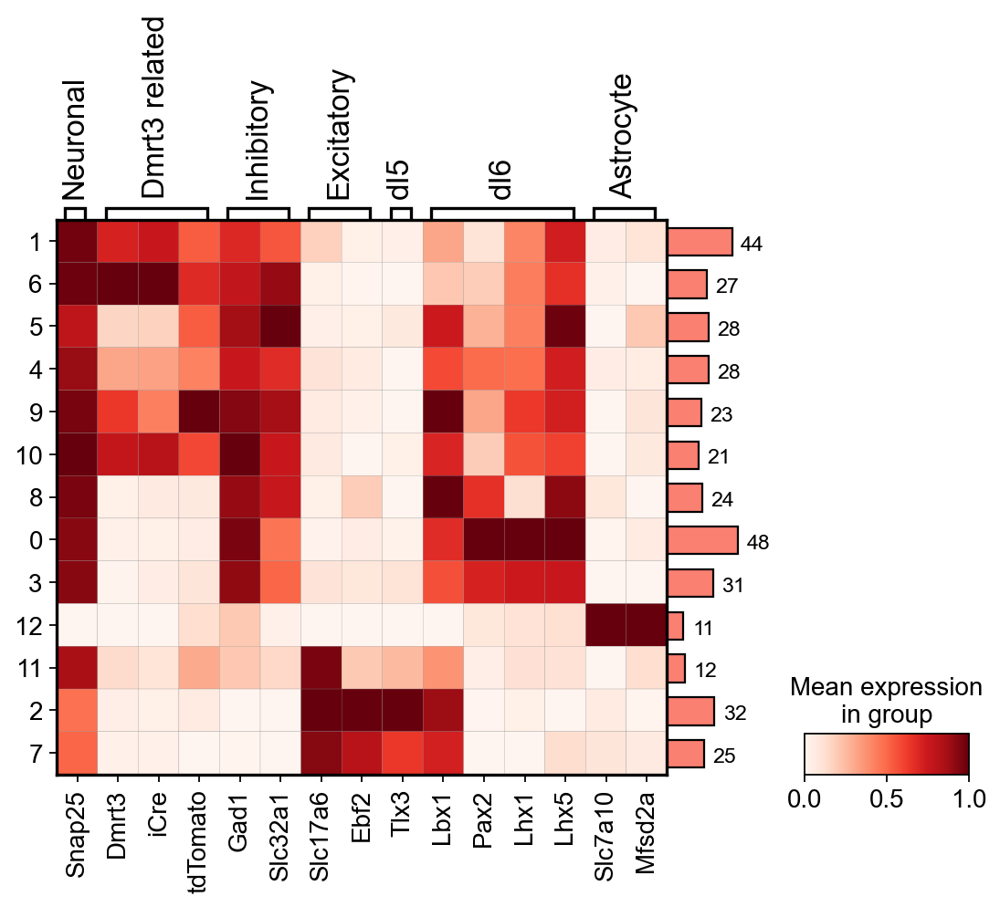

In [185]:
# genes with hits on populations
level_1_genes = {
    "Neuronal": ["Snap25"],
    "Dmrt3 related": ["Dmrt3", "iCre", "tdTomato"],
    "Inhibitory": ["Gad1", "Slc32a1"],
    "Excitatory": ["Slc17a6","Ebf2"],
    "dI5": ["Tlx3"],
    "dI6": ["Lbx1", "Pax2", "Lhx1", "Lhx5"],
    "Astrocyte": ["Slc7a10", "Mfsd2a"],
}

figure="level_0"
sc.settings.figdir=f"figures/{date}/{figure}"
mp = sc.pl.matrixplot(adata_m, groupby="leiden", var_names=filter_dict(adata_m, level_1_genes), **{"vmin":0, "vmax":1}, standard_scale="var", cmap="Reds", dendrogram=True, return_fig=True, figsize=(8,5))
mp.add_totals().show()
mp.savefig(f"figures/{date}/{figure}/matrixplot_level_0_mouse_selected_genes.pdf")



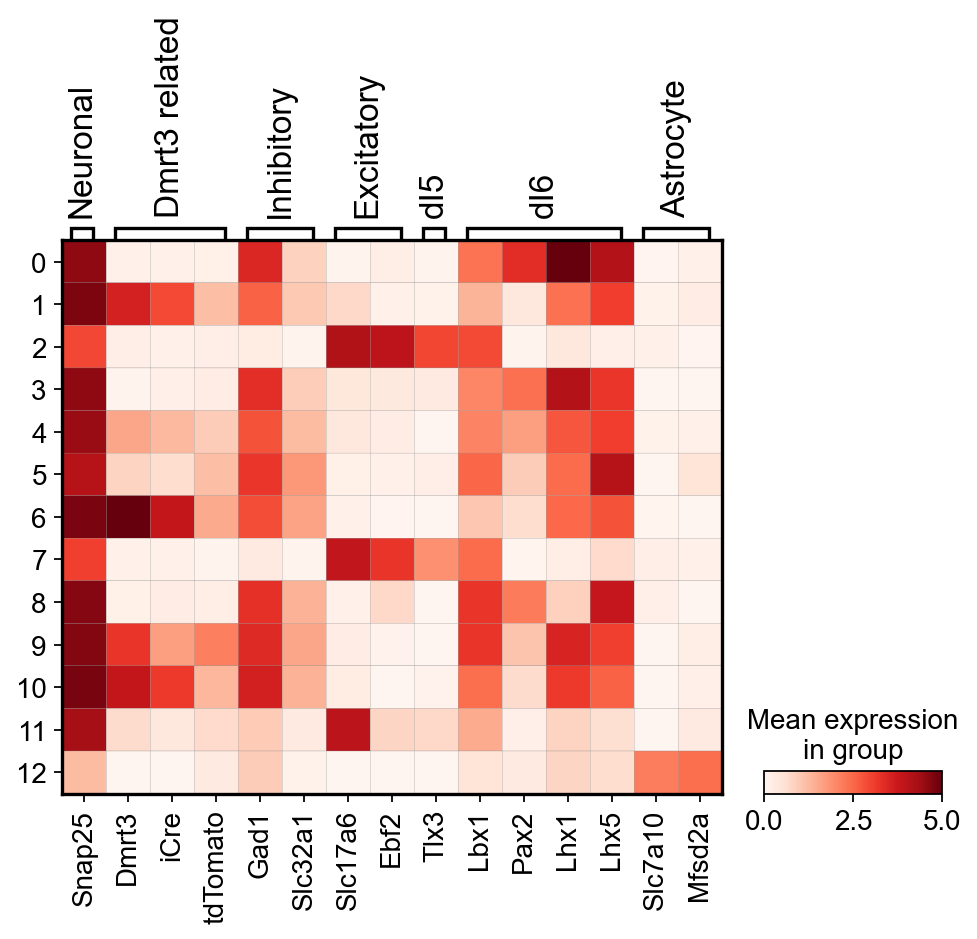

In [23]:
sc.pl.matrixplot(adata_m, groupby="leiden", var_names=filter_dict(adata_m, level_1_genes), save="_level_0_mouse_selected_genes_no_tree.pdf", **{"vmin":0, "vmax":5}, cmap="Reds")


In [24]:
# annotation of cell types (inhibitory Dmrt3 is keept for further analysis)
leiden_map = {
    "0": "dI6 Dmrt3-",
    "1": "dI6 Dmrt3+",
    "2": "Excitatory",
    "3": "dI6 Dmrt3-",
    "4": "dI6 Dmrt3+",
    "5": "dI6 Dmrt3+",
    "6": "dI6 Dmrt3+",
    "7": "Excitatory",
    "8": "dI6 Dmrt3-",
    "9": "dI6 Dmrt3+",
    "10": "dI6 Dmrt3+",
    "11": "Excitatory",
    "12": "Astrocytes"}
adata_m.obs["level_1"] = [leiden_map[leiden] for leiden in adata_m.obs["leiden"]]

... storing 'level_1' as categorical


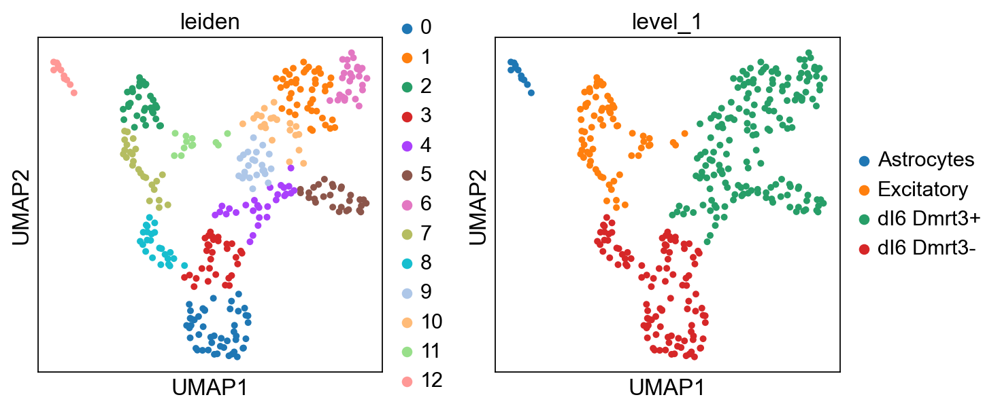

In [25]:
figure="level_1"
sc.settings.figdir=f"../figures/{date}/{figure}"
sc.pl.umap(adata_m, color=["leiden", "level_1"], save="_level_1_mouse_compare_leiden.pdf", size=80)

In [26]:
adata_m_d = adata_m[[True if group in ["dI6 Dmrt3+", "dI6 Dmrt3-"] else False for group in adata_m.obs["level_1"]]]

# Load Fish Data


In [27]:
# Load the full dataset from velocyto loom
adata_f = sc.read_loom("data/drerio.loom", sparse=False)

adata_f.X = adata_f.layers["RPKM"]
#adata_f.var_names = list(adata_f.var["var_names"])
#adata_f.obs_names = list(adata_f.obs["obs_names"])
adata_f.var_names_make_unique()
adata_f.obs_names_make_unique()
adata_f

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


AnnData object with n_obs × n_vars = 384 × 35211
    obs: 'well'
    var: 'Accession', 'Chromosome', 'gene_lenght'
    layers: 'matrix', 'RPKM', 'spliced', 'unspliced'

# Run analysis for Fish

In [28]:
# Find motochondrial genes
mito = sc.queries.mitochondrial_genes('drerio')
mito = list(mito.external_gene_name)

# add annotation of mitochondrial gene to adata.var
adata_f.var["mito"] = [True if gene in mito else False for gene in adata_f.var_names]
print(f"detected {adata_f.var['mito'].sum()} mito genes")

detected 13 mito genes


In [29]:
# add annotation for ercc gene to adata.var
adata_f.var["ERCC"] = [True if gene.startswith("ERCC-") else False for gene in adata_f.var_names]
print(f"detected {adata_f.var['ERCC'].sum()} ERCC genes")
sc.pp.calculate_qc_metrics(adata_f, inplace=True , qc_vars=["mito", "ERCC"])

detected 92 ERCC genes


In [30]:
# Find all genes that were artificaially added and should not help drive clustering of the cells
ercc_genes = [gene for gene in adata_f.var_names if gene.startswith("ERCC-")]
added_genes = ["eGFP", "Gal4"]

# All of these will be removed from the adara object
remove_genes = ercc_genes+added_genes

In [31]:
# Transfer the added genes as observations (log1p)
for gene in added_genes:
    values = adata_f.obs_vector(gene)
    adata_f.obs[gene] = np.log1p(values)

In [32]:
# Remove all ercc and added genes
adata_f = adata_f[:,[gene for gene in adata_f.var_names if gene not in remove_genes]].copy()

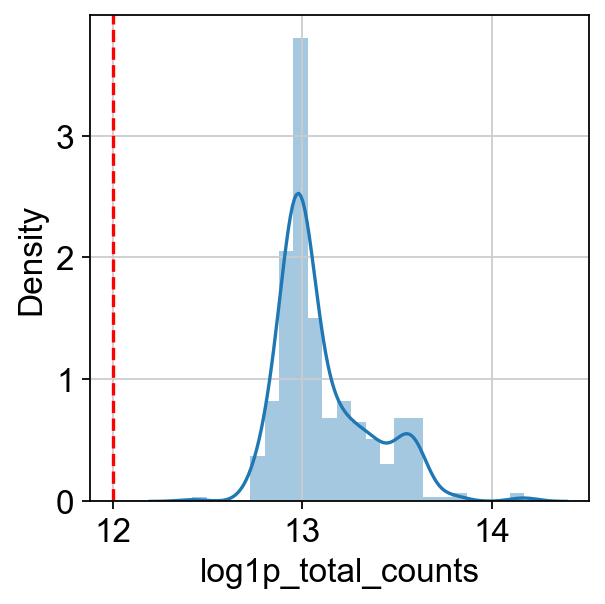

In [33]:
# filter cells based on total counts
tc_th = 12
g = sns.distplot(adata_f.obs['log1p_total_counts'])
plt.axvline(tc_th, color="r", linestyle="--")

f_count = adata_f.obs_vector('log1p_total_counts') > tc_th
plt.savefig(f"figures/{date}/preprocessing/filtering_fish_tot_counts.pdf")

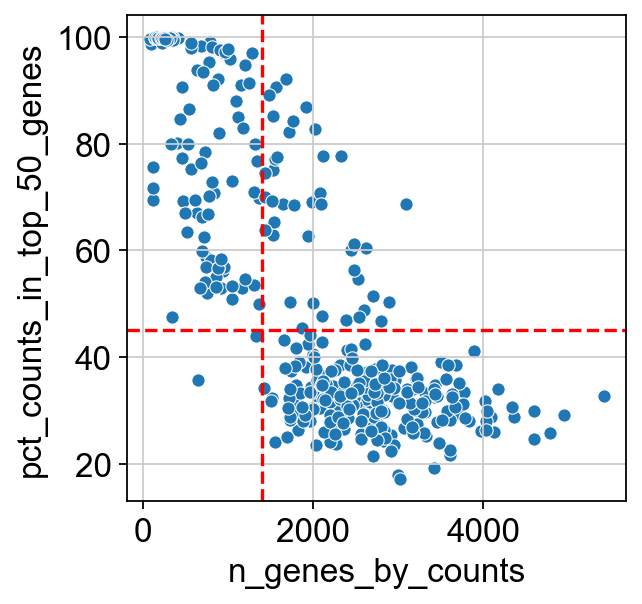

In [34]:
# filter based on percent of reads in top 50 expressed genes
pt50_th = 45 #50

# filter on number of detected genes
gpc_th = 1400 #1000
g = sns.scatterplot('n_genes_by_counts', 'pct_counts_in_top_50_genes', data=adata_f.obs)
plt.axvline(gpc_th, color="r", linestyle="--")
plt.axhline(pt50_th, color="r", linestyle="--")

f_dist = adata_f.obs_vector('pct_counts_in_top_50_genes') < pt50_th # filter cells with distributed gene counts
f_capt = adata_f.obs_vector('n_genes_by_counts') > gpc_th # filter cells with broad gene capture
plt.savefig(f"figures/{date}/preprocessing/filtering_fish_n_genes-pct50.pdf")

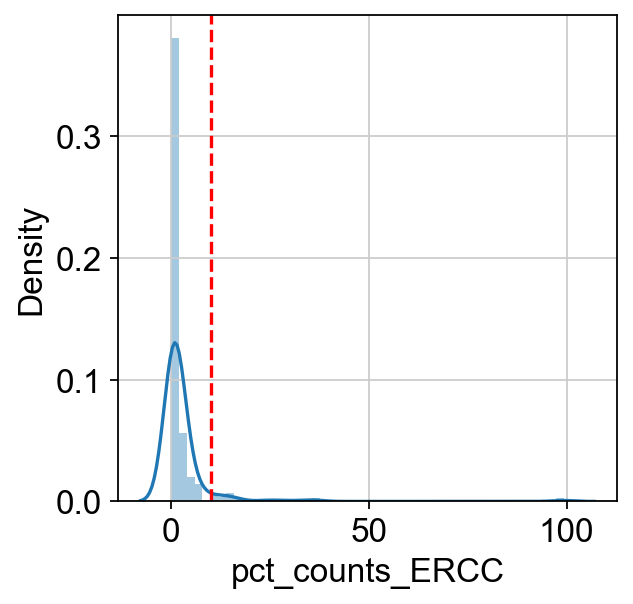

In [35]:
# filter on percent of reads that map to ercc genes
pce_th = 10
g = sns.distplot(adata_f.obs["pct_counts_ERCC"])
plt.axvline(pce_th, color="r", linestyle="--")

f_ercc = adata_f.obs_vector("pct_counts_ERCC") < pce_th # less than 10% ERCC counts
plt.savefig(f"figures/{date}/preprocessing/filtering_fish_ercc.pdf")

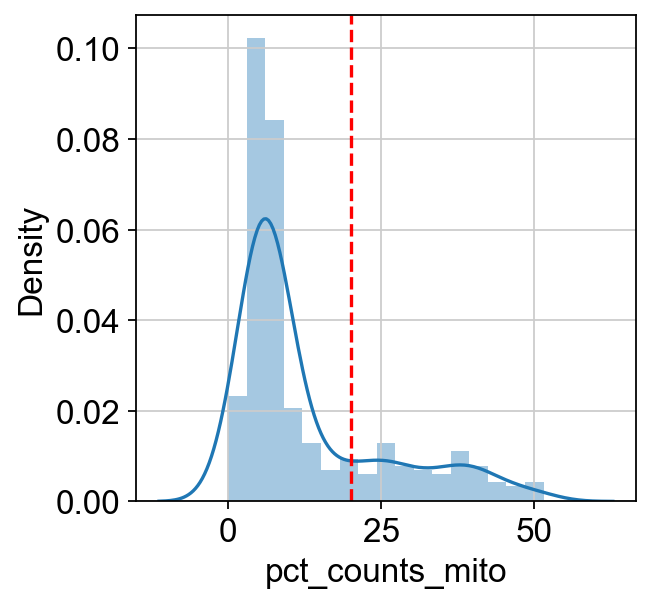

In [36]:
# filter on percent of reads that mapps to mitochondrial genes
pcm_th = 20
g = sns.distplot(adata_f.obs["pct_counts_mito"])
plt.axvline(pcm_th, color="r", linestyle="--")

f_mito = adata_f.obs_vector("pct_counts_mito") < pcm_th
plt.savefig(f"figures/{date}/preprocessing/filtering_fish_mito.pdf")

In [37]:
adata_f.write_loom(f"figures/{date}/Supplimentary files/zebrafish_unprocessed.loom")

print(f"Cells before: {adata_f.shape[0]}, genes before: {adata_f.shape[1]}")
#f_count, f_dist, f_capt, f_ercc, f_mito
f1 = np.logical_and(f_count, f_dist)
f2 = np.logical_and(f_capt, f_ercc)
f3 = np.logical_and(f2, f_mito)
f = np.logical_and(f1,f3)
adata_f = adata_f[f]
sc.pp.filter_genes(adata_f, min_counts=1)
print(f"Cells after: {adata_f.shape[0]}, genes after: {adata_f.shape[1]}")

adata_f.write_loom(f"figures/{date}/Supplimentary files/zebrafish_filtered.loom")


Trying to set attribute `.var` of view, copying.


Cells before: 384, genes before: 35117
Cells after: 233, genes after: 24568


In [38]:
gene_counts_f = np.sum(adata_f.X>0,axis=1)
gene_mean_f = np.mean(gene_counts_f)
gene_std_f = np.std(gene_counts_f)
print(f"mean counts: {gene_mean_f}")
print(f"mean counts: {gene_std_f}")


mean counts: 2698.772532188841
mean counts: 715.9290340074145


In [39]:
np.mean(adata_f.obs["n_genes_by_counts"])

2709.7296137339054

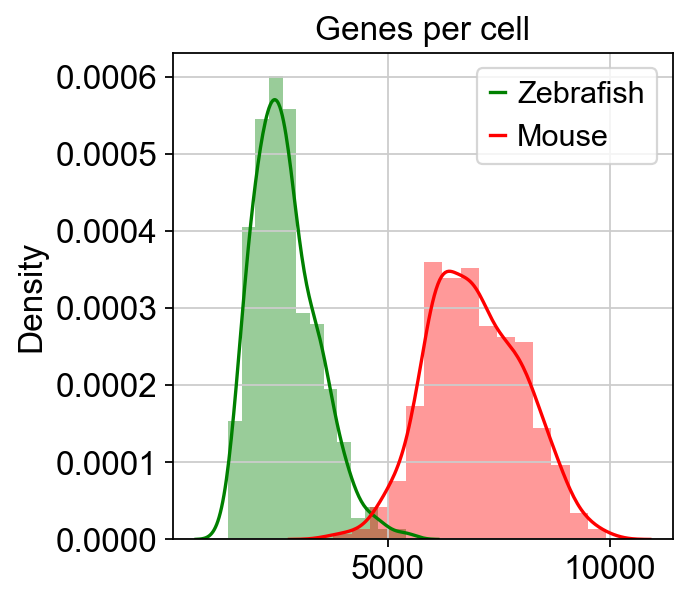

In [40]:
sns.distplot(a=gene_counts_f, label="Zebrafish", color="Green")
sns.distplot(a=gene_counts_m, label="Mouse", color="Red")
plt.legend(["Zebrafish", "Mouse"])
plt.title("Genes per cell")
plt.savefig(f"figures/{date}/preprocessing/preprossesing_gene_counts.pdf")

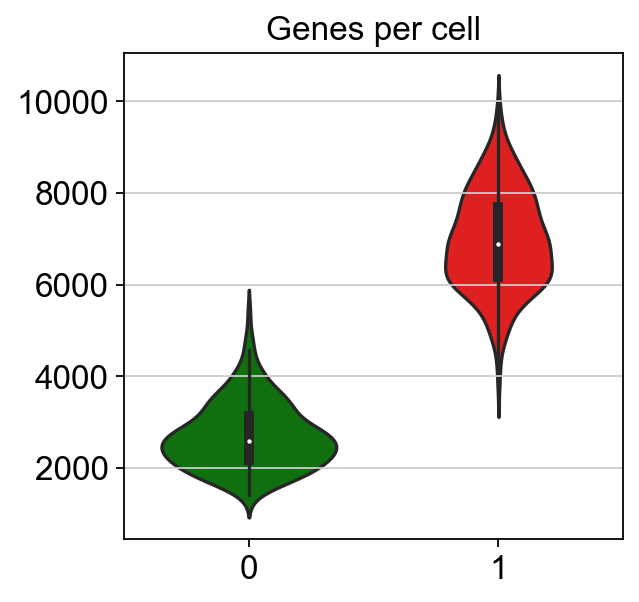

In [41]:
fish = pd.Series(gene_counts_f, name="zebrafish")
mouse = pd.Series(gene_counts_m, name="mouse")
sns.violinplot(data=[fish, mouse],width=0.7, palette=["Green", "Red"])
#plt.legend(["Zebrafish", "Mouse"])
plt.title("Genes per cell")
plt.savefig(f"figures/{date}/preprocessing/preprossesing_gene_counts_violinplot.pdf")

In [42]:
# Fix violin plot to be green and red (fish mouse) using plotly express?

In [43]:
#sc.pp.normalize_total(adata_f, exclude_highly_expressed=True)

In [44]:
# Log and save in raw
sc.pp.log1p(adata_f)
#adata_f.raw = adata_f


... storing 'Chromosome' as categorical


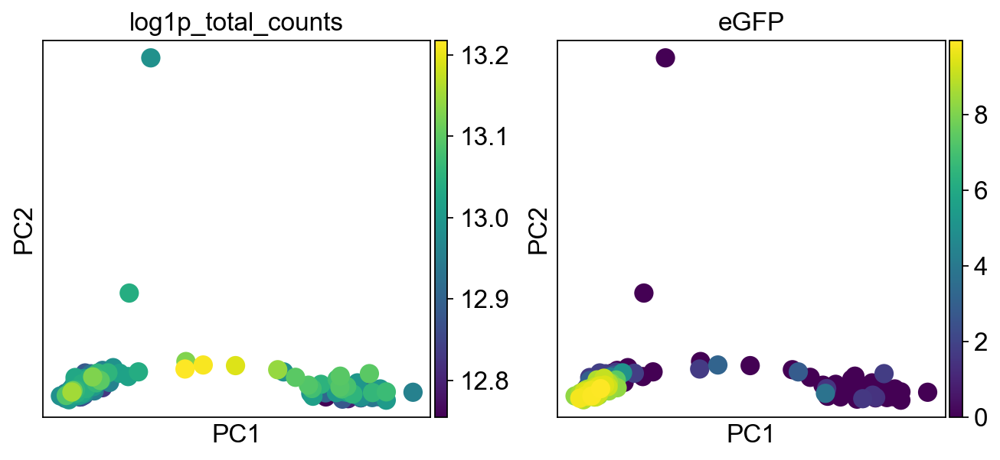

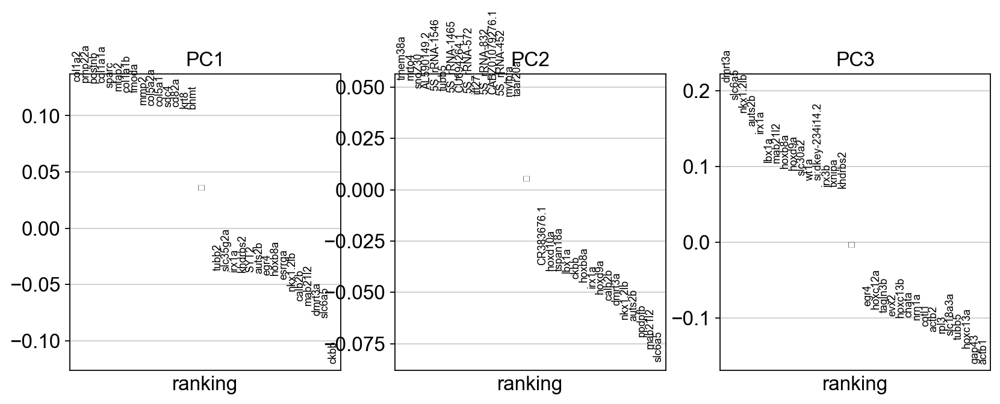

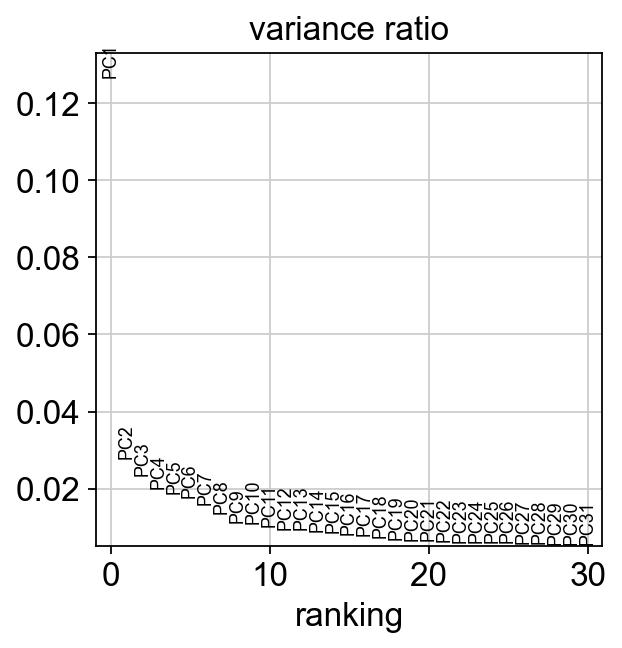

In [45]:
sc.pp.highly_variable_genes(adata_f, n_top_genes=5000)
sc.pp.pca(adata_f, use_highly_variable=True)
sc.pl.pca_overview(adata_f, color=["log1p_total_counts", "eGFP"])

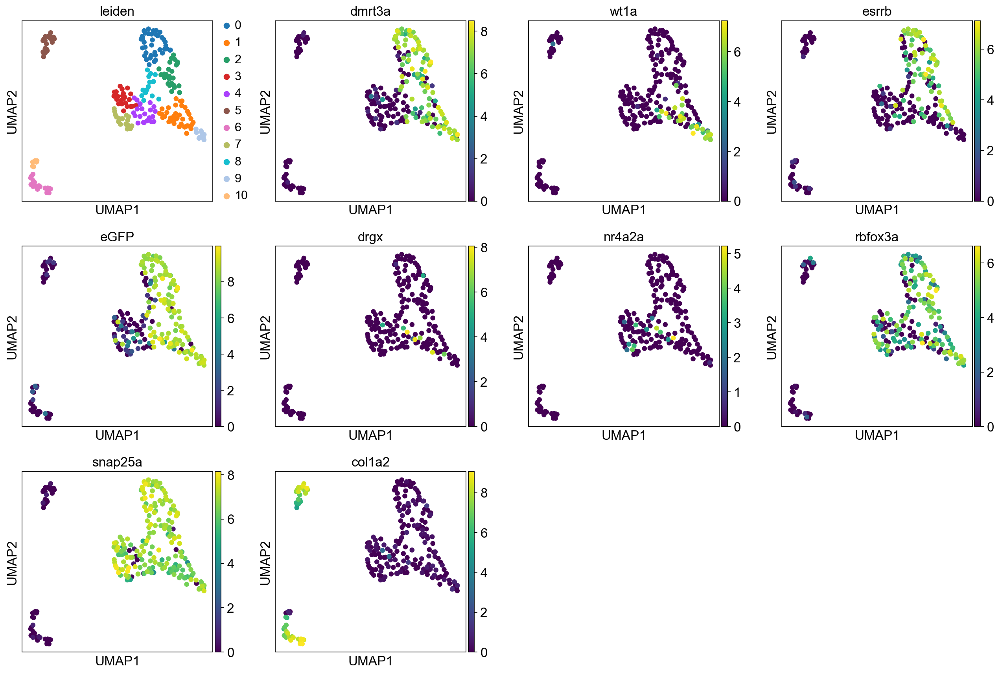

In [46]:
sc.pp.neighbors(adata_f, n_pcs=7, n_neighbors=10)
sc.tl.leiden(adata_f, resolution=1)
sc.tl.umap(adata_f, random_state=9)
sc.pl.umap(adata_f, color=["leiden","dmrt3a", "wt1a", "esrrb","eGFP","drgx","nr4a2a","rbfox3a", "snap25a", "col1a2"], return_fig=True, size=130)
plt.savefig(f"figures/{date}/level_0/level_0_fish_overview_scatterplot.pdf")

In [47]:
# this funtion takes a curated dictionary of gene sets from one species and maps it to another
def orth_var_names(var_dict, species, target):
    # extract known orth genes in mouse genome
    from scConnect.database import find_orth_gene
    
    orth_marker_ct = dict()

    for k, v in var_dict.items():
        orth_genes = []
        for gene in var_dict[k]:
            orth_gene = find_orth_gene(gene, species, target)
            if len(orth_gene) > 0:
                for gene in orth_gene:
                    orth_genes.append(gene)
        if len(orth_genes) > 0:            
            orth_marker_ct[k] = list(set(orth_genes))
    return orth_marker_ct

Full marker sets for zebrafish is available from Farnsworth et al 2019 https://www.sciencedirect.com/science/article/pii/S0012160619304919
Supplementary table 2

In [48]:
# find best correlated cell type for each cluster based on marker gene overlap
#from matplotlib import rcParams

# figure size in inches
#rcParams['figure.figsize'] = 11.7,8.27

import holoviews as hv
drerio_meta = pd.read_excel("data/Miller/Table_S2_rev.xlsx", usecols=[0,1,2,3,4,5,6,7])
drerio_genes = pd.read_excel("data/Miller/Table_S2_rev.xlsx", usecols=np.arange(8,24))

gene_dict = dict()
for i, row in drerio_genes.iterrows():
    gene_list = list()
    for gene in row:
        gene_list.append(gene)
    try:
        gene_dict[drerio_meta.loc[i]["Cell type"]] += gene_list
    except:
        gene_dict[drerio_meta.loc[i]["Cell type"]] = gene_list
for k, v in gene_dict.items():
    gene_dict[k] = v
gene_dict.pop(np.nan)
drerio_meta

,Cluster ID,Germ Layer,Tissue,Cell type,Subtype,Ident Annotation,Groupname,Day of Origin
0,0,Ectoderm,Integument,Periderm,NaN,Peri1a,Peri1,1
1,1,Ectoderm,Central Nervous System,Neuroblast,Retinal,RetProgAlla,RetProg,"1,2,5"
2,2,Ectoderm,Central Nervous System,"Neuron, differentiating",Mid-hindbrain boundary,MHBDiff12a,MHB,"1,2"
3,3,Nonspecific genes,NaN,NaN,NaN,NonspecificAlla,Nonspecific,"1,2,5"
4,4,Ectoderm,Central Nervous System,Neuroblast,Mid-hindbrain boundary,MHBProg12,MHB,"1,2"
...,...,...,...,...,...,...,...,...
216,216,Mesoderm,Connective tissue,Osteoblast,NaN,Osteo,Osteo,"2,5"
217,217,Endoderm,Liver,Hepatocyte??,Kupffer cells?,Hepato5c,Liver,5
218,218,Endoderm,Hypochord,NaN,NaN,Hypochord,Hypochord,1
219,219,Germ,Germ cell,Primordial germ cell,NaN,PGC,PGC,1


categories: 0, 1, 2, etc.
var_group_labels: Periderm, Neuroblast, Neuron, differentiating, etc.


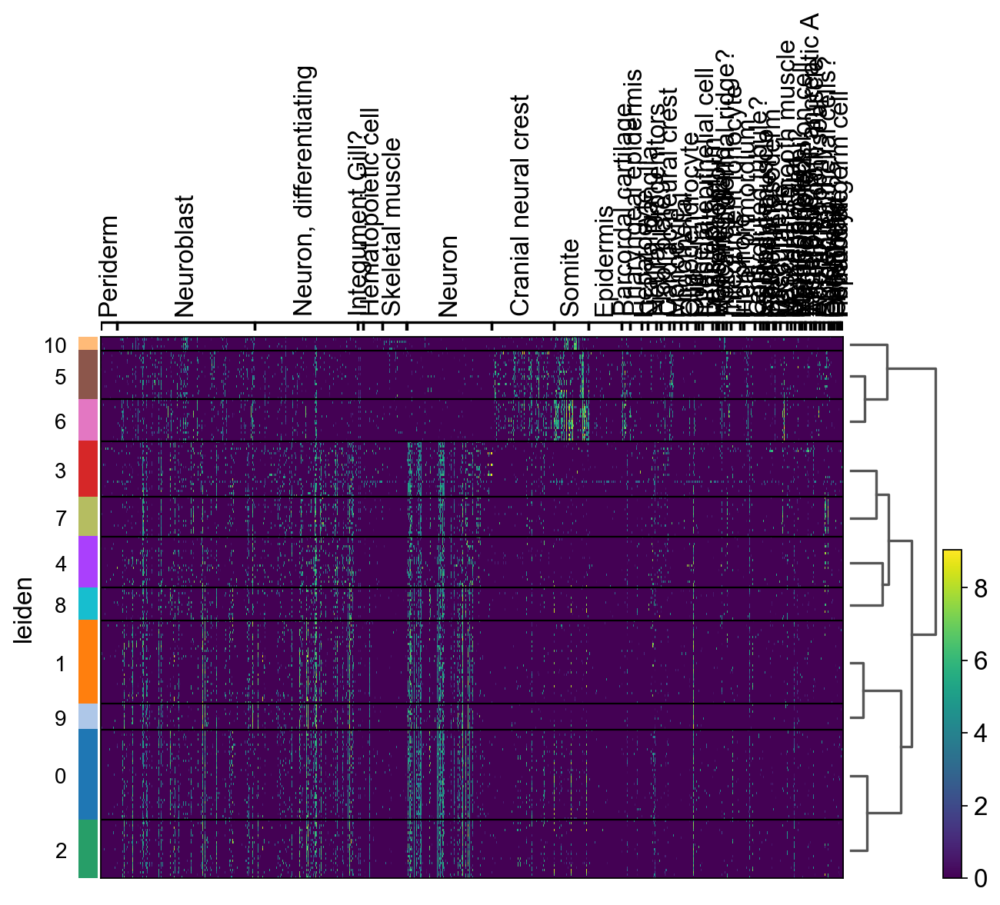

In [49]:
figure="level_0"
sc.settings.figdir=f"figures/{date}/{figure}"
sc.pl.heatmap(adata_f, var_names=filter_dict(adata_f, gene_dict, verbose=False), groupby="leiden", save="_level_0_fish_farnsworth_tissue.pdf", dendrogram=True)

In [50]:
# Focus on Somite and Cranial neural crest

drerio_meta = pd.read_excel("data/Miller/Table_S2_rev.xlsx", usecols=[0,1,2,3,4,5,6,7])
drerio_genes = pd.read_excel("data/Miller/Table_S2_rev.xlsx", usecols=np.arange(8,24))

gene_dict = dict()
for i, row in drerio_genes.iterrows():
    gene_list = list()
    for gene in row:
        gene_list.append(gene)
    if drerio_meta.loc[i]["Cell type"] in ["Somite", "Cranial neural crest"]:
        try:
            gene_dict[drerio_meta.loc[i]["Subtype"]] += gene_list
        except:
            gene_dict[drerio_meta.loc[i]["Subtype"]] = gene_list
for k, v in gene_dict.items():
    gene_dict[k] = v[0:5]
gene_dict.pop(np.nan)
drerio_meta


,Cluster ID,Germ Layer,Tissue,Cell type,Subtype,Ident Annotation,Groupname,Day of Origin
0,0,Ectoderm,Integument,Periderm,NaN,Peri1a,Peri1,1
1,1,Ectoderm,Central Nervous System,Neuroblast,Retinal,RetProgAlla,RetProg,"1,2,5"
2,2,Ectoderm,Central Nervous System,"Neuron, differentiating",Mid-hindbrain boundary,MHBDiff12a,MHB,"1,2"
3,3,Nonspecific genes,NaN,NaN,NaN,NonspecificAlla,Nonspecific,"1,2,5"
4,4,Ectoderm,Central Nervous System,Neuroblast,Mid-hindbrain boundary,MHBProg12,MHB,"1,2"
...,...,...,...,...,...,...,...,...
216,216,Mesoderm,Connective tissue,Osteoblast,NaN,Osteo,Osteo,"2,5"
217,217,Endoderm,Liver,Hepatocyte??,Kupffer cells?,Hepato5c,Liver,5
218,218,Endoderm,Hypochord,NaN,NaN,Hypochord,Hypochord,1
219,219,Germ,Germ cell,Primordial germ cell,NaN,PGC,PGC,1


mitigated Myoblast gene: msc
mitigated Arch mesenchyme from crest gene: nkx3.3
mitigated Arch mesenchyme from crest gene: tmem98


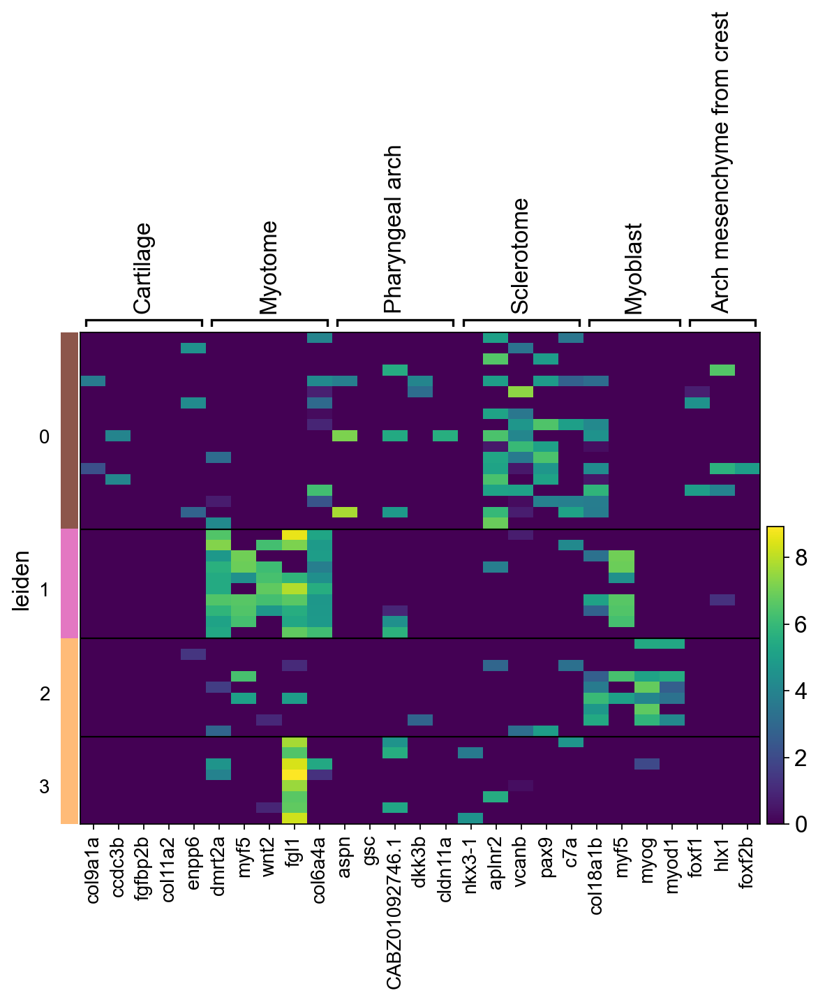

In [51]:
figure="level_0"
sc.settings.figdir=f"figures/{date}/{figure}"

non_neurons = [True if leiden in ["5", "6", "10"] else False for leiden in adata_f.obs["leiden"]]
adata_f_non = adata_f[non_neurons].copy()
# Lets subgroup this dataset to find specific cell types
sc.pp.pca(adata_f_non)
sc.pp.neighbors(adata_f_non)
sc.tl.leiden(adata_f_non)

sc.pl.heatmap(adata_f_non, var_names=filter_dict(adata_f, gene_dict), groupby="leiden", save="_level_0_fish_farnsworth_cell_type.pdf", dendrogram=False)

## Level 1 annotation - cell types - Fish

categories: 0, 1, 2, etc.
var_group_labels: Neuronal, Dmrt3 related, Inhibitory, etc.


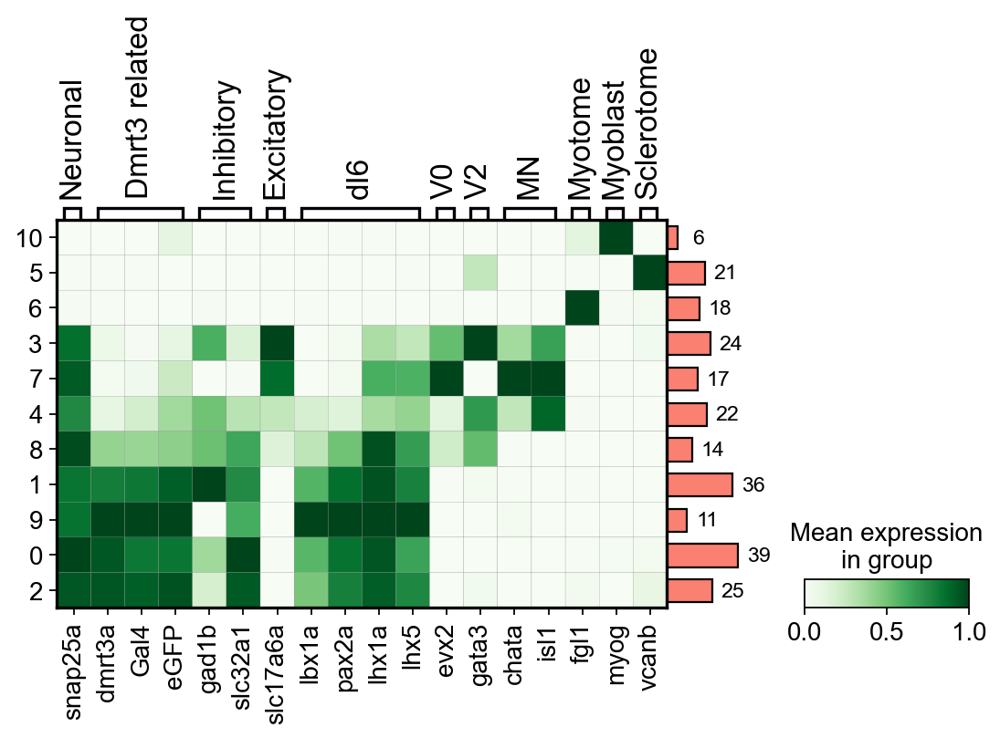

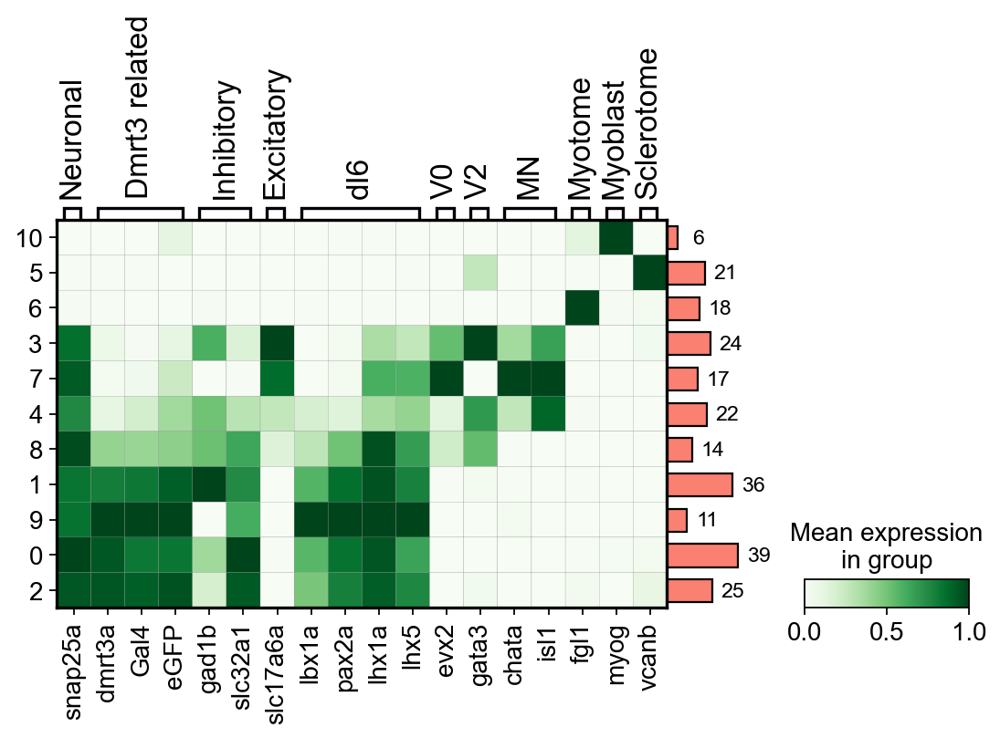

In [189]:
level_1_genes = {
    "Neuronal": ["snap25a"],
    "Dmrt3 related": ["dmrt3a","Gal4", "eGFP"],
    "Inhibitory": ["gad1b", "slc32a1"],
    "Excitatory": ["slc17a6a"],
    "dI6": ["lbx1a", "pax2a", "lhx1a", "lhx5"],
    "V0": ["evx2"],
    "V2": ["gata3"],
    "MN": [ "chata", "isl1"],
    "Myotome": ["fgl1"],
    "Myoblast": ["myog"],
    "Sclerotome": ["vcanb"]
}
figure="level_0"
sc.settings.figdir=f"figures/{date}/{figure}"
mp = sc.pl.matrixplot(adata_f, var_names=level_1_genes, groupby="leiden", **{"vmin":0, "vmax":1}, standard_scale="var", dendrogram=True, cmap="Greens", return_fig=True, figsize=(8,3.5))
mp.add_totals().show()
mp.savefig(f"figures/{date}/{figure}/matrixplot_level_0_fish_selected_genes.pdf")

In [53]:
leiden_map = {
    "0": "Inhibitory dmrt3a",
    "1": "Inhibitory dmrt3a",
    "2": "Inhibitory dmrt3a",
    "3": "Excitatory dmrt3a",
    "4": "Excitatory dmrt3a",
    "5": "Mesoderm",
    "6": "Mesoderm",
    "7": "Excitatory dmrt3a",
    "8": "Excitatory dmrt3a",
    "9": "Inhibitory dmrt3a",
    "10": "Mesoderm"
}
adata_f.obs["level_1"] = [leiden_map[leiden] for leiden in adata_f.obs["leiden"]]

... storing 'level_1' as categorical


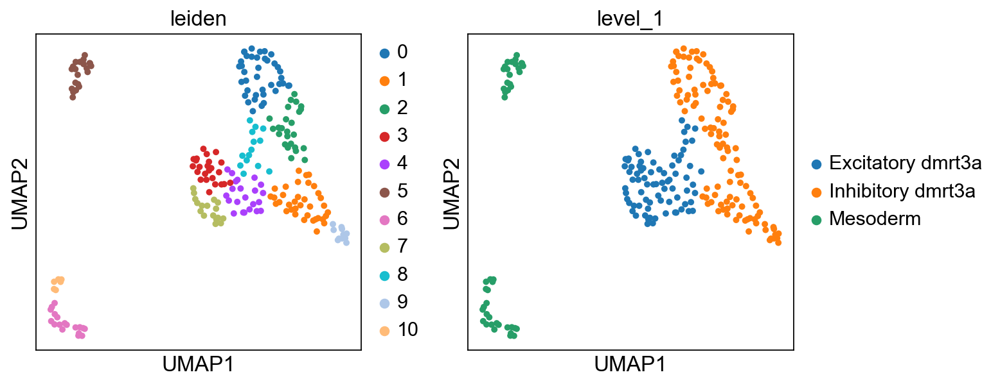

In [54]:
figure="level_1"
sc.settings.figdir=f"figures/{date}/{figure}"
sc.pl.umap(adata_f, color=["leiden", "level_1"], save="_level_1_fish_compare_leiden.pdf", size=80)

### Re clustering of Excitatory dmrt3 populations

In [55]:
adata_f_e = adata_f[[True if group=="Excitatory dmrt3a" else False for group in adata_f.obs["level_1"]]].copy()

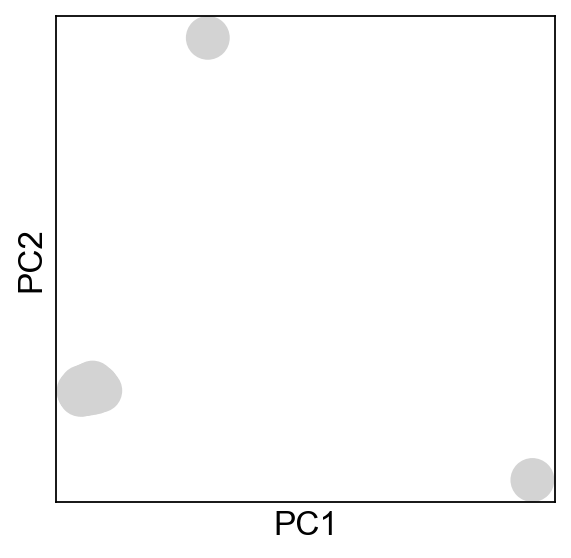

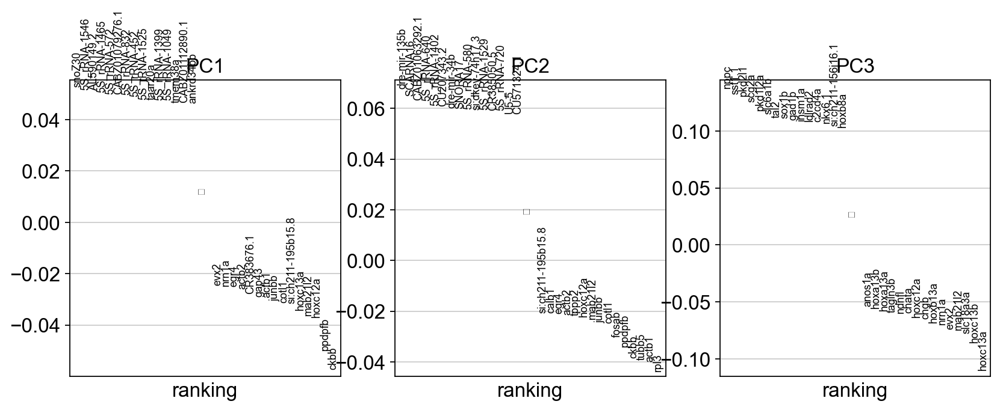

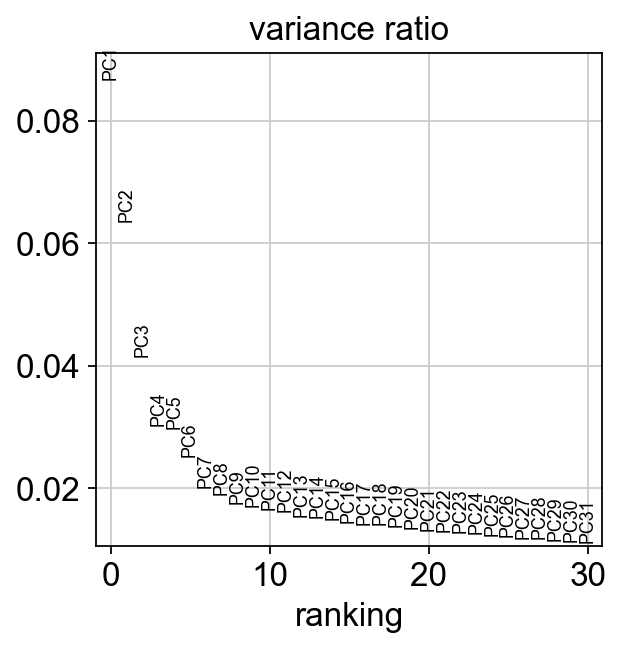

In [56]:
sc.pp.pca(adata_f_e)
sc.pl.pca_overview(adata_f_e)

In [57]:
orth_var_names({"dI6": ["Lbx1", "Pax2", "Lhx1", "Lhx5"]}, "mmusculus", "drerio")

{'dI6': ['lbx1b', 'lbx1a', 'pax2b', 'pax2a']}

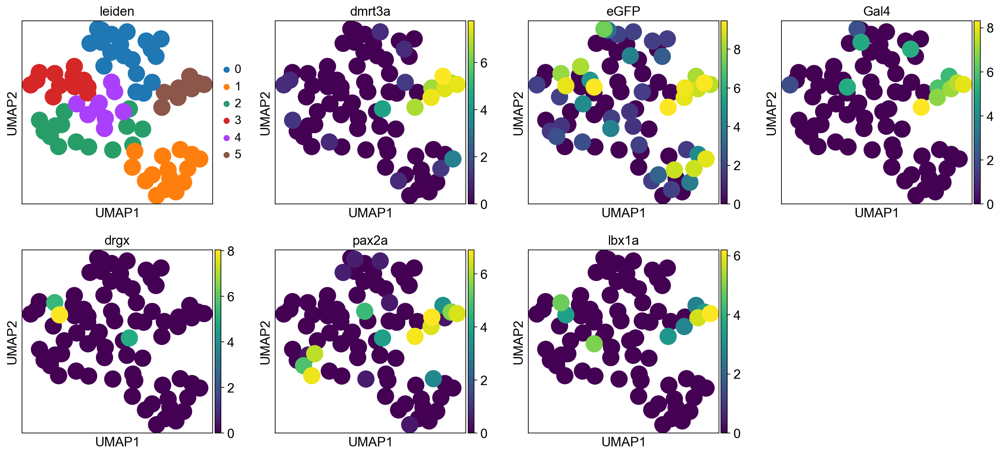

In [58]:
sc.pp.neighbors(adata_f_e, n_pcs=15, n_neighbors=10)
sc.tl.leiden(adata_f_e, resolution=1)
sc.tl.umap(adata_f_e)
sc.pl.umap(adata_f_e, color=["leiden", "dmrt3a", "eGFP", "Gal4", "drgx", 'pax2a', 'lbx1a'], save="_level_0_resorted.pdf",)

categories: 0, 1, 2, etc.
var_group_labels: Neuronal, Dmrt3 related, Inhibitory, etc.


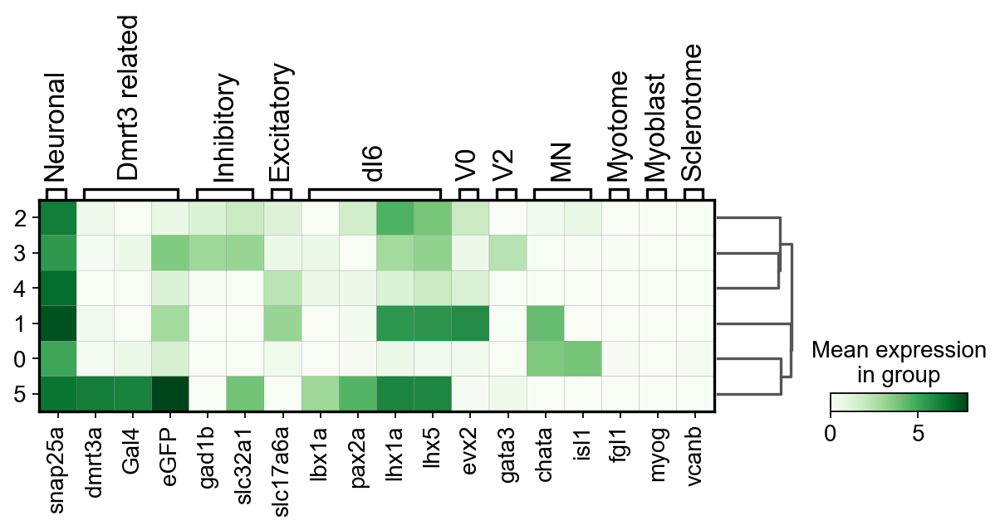

In [59]:
sc.tl.dendrogram(adata_f_e, groupby="leiden")
sc.pl.matrixplot(adata_f_e, var_names=level_1_genes, save="_level_0_resorted.pdf", groupby="leiden", dendrogram=True, cmap="Greens")

In [60]:
adata_f.obs["excitatory_leiden"] = adata_f_e.obs["leiden"]

In [61]:
new_leiden = list()
for cell in adata_f.obs_names:
    if adata_f.obs.loc[cell]["excitatory_leiden"] == "5":
        new_leiden.append("Inhibitory dmrt3a")
    else:
        new_leiden.append(adata_f.obs.loc[cell]["level_1"])
adata_f.obs["level_1"] = new_leiden
        

... storing 'level_1' as categorical


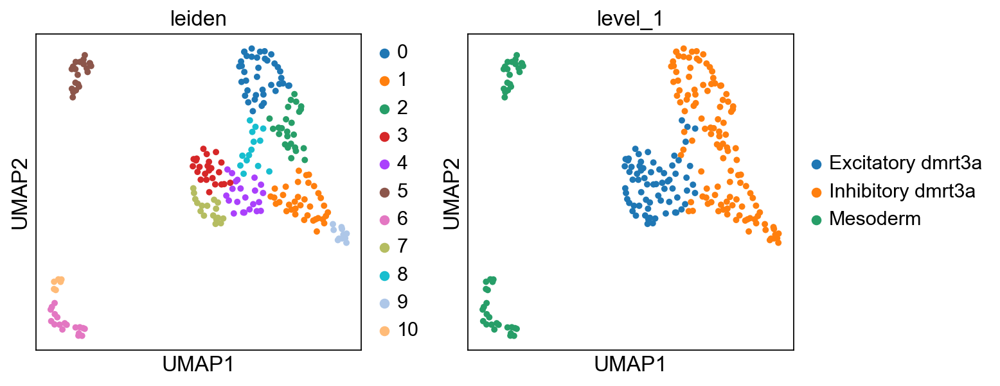

In [62]:
sc.pl.umap(adata_f, color=["leiden", "level_1"], save="_level_1_fish_compare_leiden.pdf", size=80)

In [63]:
adata_f_d = adata_f[[True if group in ["Inhibitory dmrt3a"] else False for group in adata_f.obs["level_1"]]]

We miss 3 Drgx neurons to cluster 1 and 2. Note that all have eGFP and have hence expressed dmrt3 at some point, and most sertainly have eGFP protein in them (hence correlty sorted) 

# Finding DE genes in mouse and fish
Here we try to set the resolution of the leiden algorithm to find populations that all have DE genes. If one population does not have DE genes, we lower the resolution.

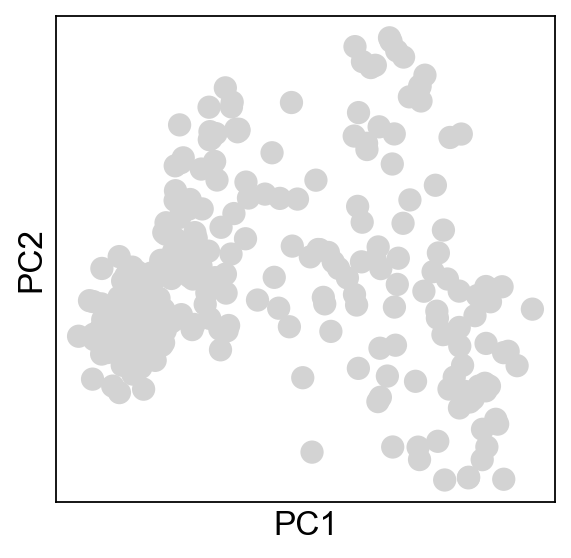

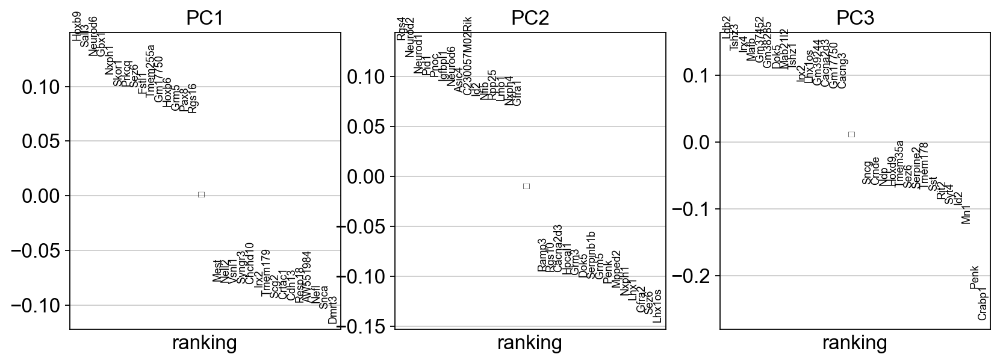

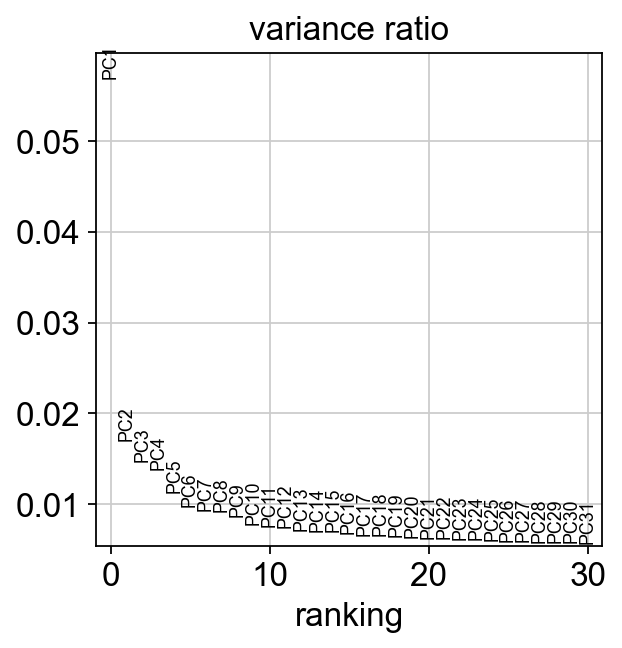

In [64]:
sc.pp.pca(adata_m_d)
sc.pl.pca_overview(adata_m_d)

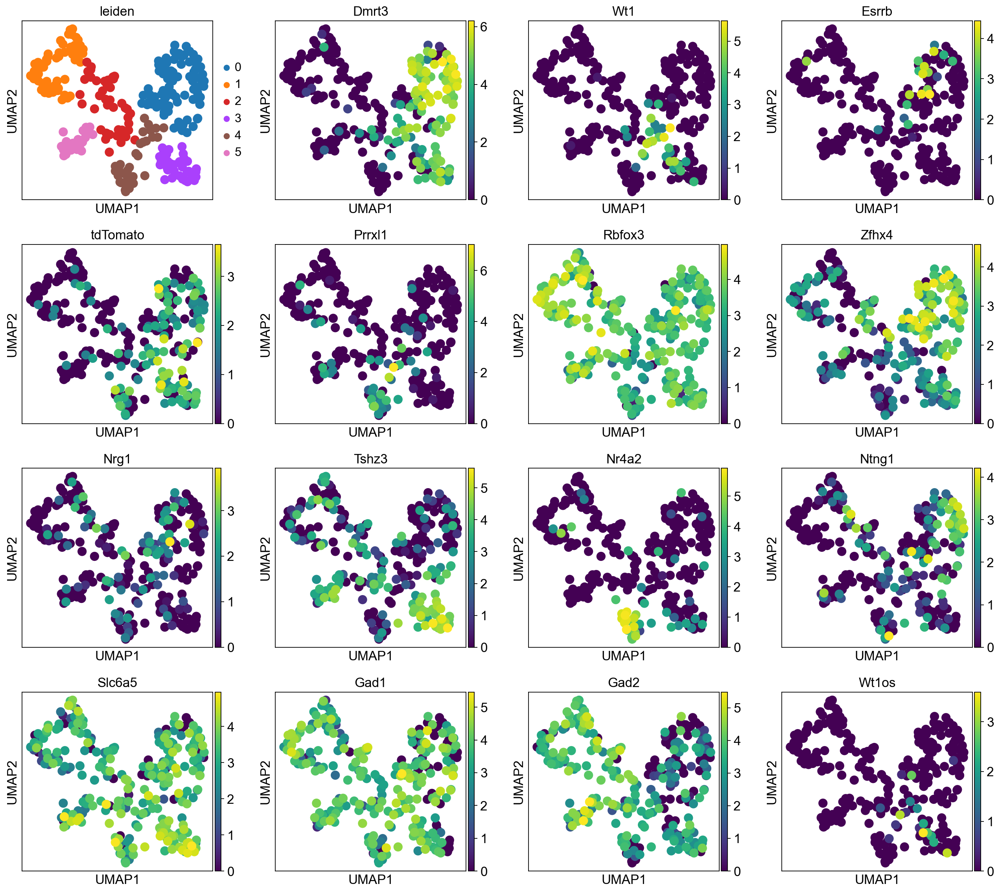

In [65]:
figure="dmrt3"
sc.settings.figdir=f"figures/{date}/{figure}"

sc.pp.neighbors(adata_m_d, n_pcs=6, n_neighbors=10)
sc.tl.leiden(adata_m_d, resolution=0.4) # 0.2 produce 4 populations and all have DE gene markers
sc.tl.umap(adata_m_d, random_state=1, min_dist=0.5)
sc.pl.umap(adata_m_d, color=["leiden","Dmrt3", "Wt1", "Esrrb","tdTomato", "Prrxl1", "Rbfox3", 'Zfhx4','Nrg1',"Tshz3", "Nr4a2", "Ntng1", "Slc6a5", "Gad1", "Gad2", "Wt1os"], save="_mouse_selected-genes.pdf")

In [66]:
th=0
wt1_gene = "Wt1"
esrrb_gene = "Esrrb"
calb_gene = "Calb2"
total = len(adata_m_d.obs_vector(wt1_gene))
wt1 = sum(adata_m_d.obs_vector(wt1_gene)>th)
esrrb = sum(adata_m_d.obs_vector(esrrb_gene)>th)
calb = sum(adata_m_d.obs_vector(calb_gene)>th)


double_wt1_esrrb = sum(np.logical_and(adata_m_d.obs_vector(esrrb_gene)>th, adata_m_d.obs_vector(wt1_gene)>th))
double_wt1_calb = sum(np.logical_and(adata_m_d.obs_vector(calb_gene)>th, adata_m_d.obs_vector(wt1_gene)>th))
double_not_wt1_esrrb = total - sum(np.logical_or(adata_m_d.obs_vector(wt1_gene)>th, adata_m_d.obs_vector(esrrb_gene)>th))
tripple_wt1_esrrb_calb = total - sum(np.logical_or(np.logical_or(adata_m_d.obs_vector(calb_gene)>th, adata_m_d.obs_vector(wt1_gene)>th), adata_m_d.obs_vector(esrrb_gene)>th))
p_wt1 = wt1/total
p_esrrb = esrrb/total
p_double_wt1_esrrb = double_wt1_esrrb/total
p_double_wt1_calb = double_wt1_calb/total
p_not_double = double_not_wt1_esrrb/total
p_calb = calb/total
p_tripple = tripple_wt1_esrrb_calb/total

print(f"Wt1: {wt1} cells, {p_wt1*100}%")
print(f"Esrrb: {esrrb} cells, {p_esrrb*100}%")
print(f"calb: {calb} cells, {p_calb*100}%")
print(f"Dmrt3: {total} cells")

print(f"double wt1 esrrb: {double_wt1_esrrb} cells, {p_double_wt1_esrrb*100}%")
print(f"double wt1 calb: {double_wt1_calb} cells, {p_double_wt1_calb*100}%")
print(f"tripple NOT wt1 calb essrb: {tripple_wt1_esrrb_calb} cells, {p_tripple*100}%")
print(f"double NOT wt1 or esrrb: {double_not_wt1_esrrb} cells, {p_not_double*100}%")
print(f"total : {total}")


Wt1: 31 cells, 11.313868613138686%
Esrrb: 20 cells, 7.2992700729927%
calb: 21 cells, 7.664233576642336%
Dmrt3: 274 cells
double wt1 esrrb: 4 cells, 1.4598540145985401%
double wt1 calb: 3 cells, 1.094890510948905%
tripple NOT wt1 calb essrb: 210 cells, 76.64233576642336%
double NOT wt1 or esrrb: 227 cells, 82.84671532846716%
total : 274


In [67]:
# find all DE genes for each group
def find_DE_genes(adata, groupby):
    sc.tl.rank_genes_groups(adata, groupby=groupby, method="t-test")

    #get a set of all groups
    groups = set(adata.obs[groupby].values)
    genes_groups = dict()
    for group in groups:
        genes = sc.get.rank_genes_groups_df(adata, group=group)

        # only select the genes with a adjusted pvalue lower than 0.05
        genes = genes["names"][genes.pvals_adj<0.05].values
        genes_groups[group] = list(genes)

    return genes_groups

## Temporal information leiden groups - mouse

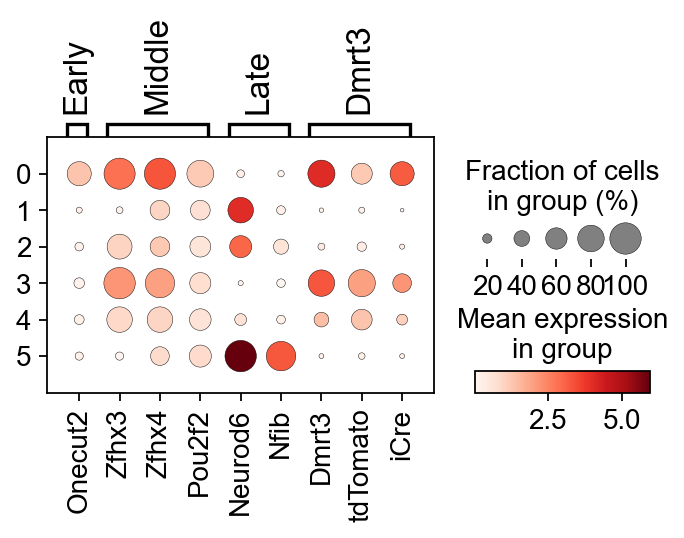

In [68]:
temporal_long = {
    "Early": ["Onecut2"],
    "Middle": ["Zfhx3", "Zfhx4", "Pou2f2"],
    "Late": ["Neurod6", "Nfib"],
    "Dmrt3": ["Dmrt3", "tdTomato", "iCre"]
}
sc.pl.dotplot(adata_m_d, groupby="leiden", var_names=filter_dict(adata_m_d, temporal_long), save="_leiden_temporal_mouse.pdf")

... storing 'celltype' as categorical


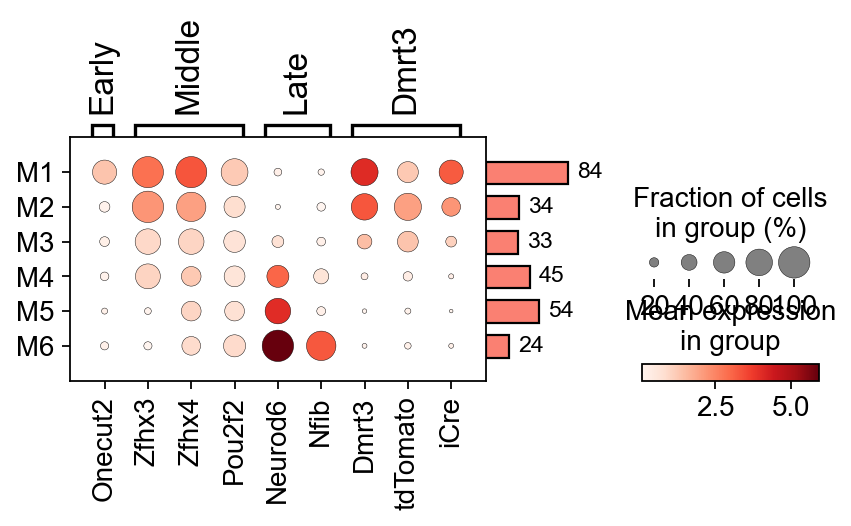

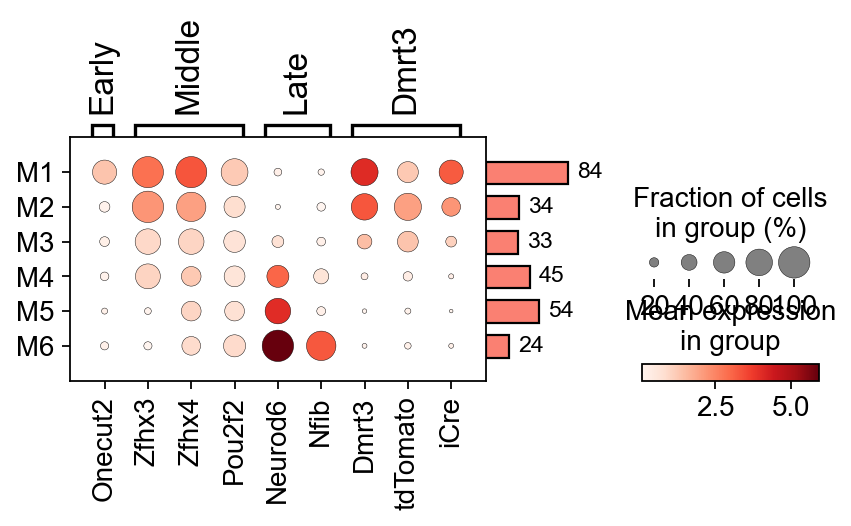

In [195]:
mouse_remapping = {
    "0": "M1",
    "3": "M2",
    "4": "M3",
    "2": "M4",
    "1": "M5",
    "5": "M6"
    }
adata_m_d.obs["celltype"] = [mouse_remapping[leiden] for leiden in adata_m_d.obs["leiden"]]
dp = sc.pl.dotplot(adata_m_d, groupby="celltype", var_names=filter_dict(adata_m_d, temporal_long), return_fig=True, figsize=(6,2))
dp.add_totals().show()
dp.savefig(f"figures/{date}/{figure}/dotplot_level_0_fish_selected_genes.pdf")

## Spatial information
Next we want to investigate to location rostra-caudally of our cell populations. We do this by analysing a set of Hox genes.

mitigated hox gene: Hoxa13


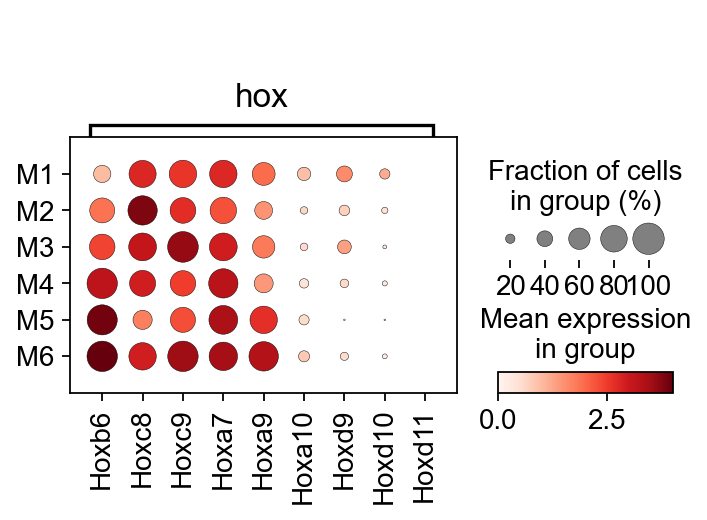

In [70]:
hox_m = {"Cervical": ["Hoxc4", "Hoxa5","Hoxb5","Hoxc5", "Hoxa6","Hoxb6", "Hoxc6", "Hoxa7", "Hoxb7" "Hoxb8"], 
         "Thorasic": ["Hoxc8", "Hoxd8", "Hoxa9", "Hoxc9"],
         "Lumbar": ["Hoxd9","Hoxa10", "Hoxc10", "Hoxd10", "Hoxa11", "Hoxc11", "Hoxd11"],
         "Sacral": ["Hoxc12", "Hoxd12", "Hoxa13", "Hoxb13", "Hoxc13", "Hoxd13"]
        }
hox_m = {"hox": ["Hoxb6", "Hoxc8", "Hoxc9","Hoxa7", "Hoxa9", "Hoxa10", "Hoxd9", "Hoxd10", "Hoxd11", "Hoxa13"]}
sc.pl.dotplot(adata_m_d, groupby="celltype", var_names=filter_dict(adata_m_d, hox_m), save="_celltype_hox_mouse.pdf")

In [71]:
de_genes = find_DE_genes(adata_m_d, "celltype")
for k, v in de_genes.items():
    print(f"group {k} has {len(v)} DE genes, top is {v[0:3]}")

group M1 has 1531 DE genes, top is ['Zfhx3', 'Meis2', 'Zfhx4']
group M4 has 276 DE genes, top is ['Hoxb8', 'Hoxb7', 'Hoxb9']
group M6 has 3207 DE genes, top is ['Neurod6', 'Neurod2', 'Zeb2']
group M3 has 994 DE genes, top is ['Pid1', 'Sst', 'Slit2']
group M2 has 1037 DE genes, top is ['Irx4', 'Tshz3', 'Ldb2']
group M5 has 2934 DE genes, top is ['Sall3', 'Npy', 'Nxph1']


In [72]:
#Number of cells per cell type
adata_m_d.obs["celltype"].value_counts()

M1    84
M5    54
M4    45
M2    34
M3    33
M6    24
Name: celltype, dtype: int64

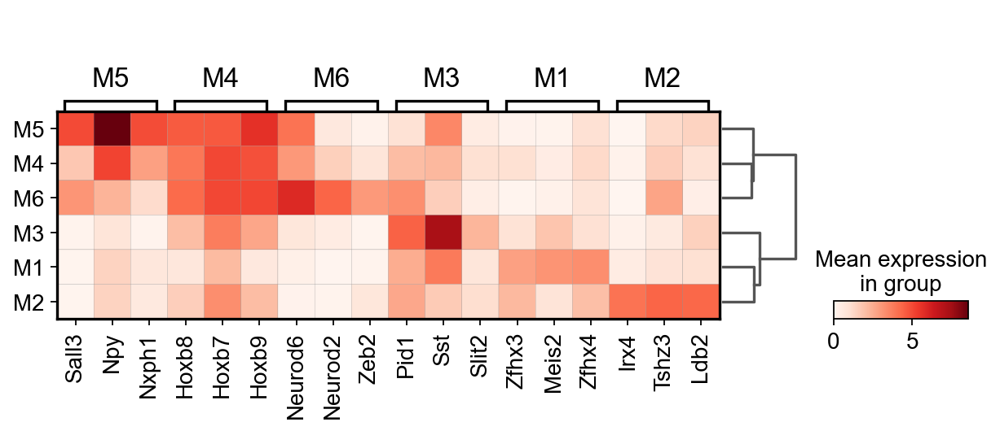

In [73]:
sc.tl.rank_genes_groups(adata_m_d, groupby="celltype", method="t-test")
sc.pl.rank_genes_groups_matrixplot(adata_m_d, groupby="celltype", n_genes=3, cmap="Reds", save="mouse_DE_genes.pdf")

Here we plot distribution of some interesting genes

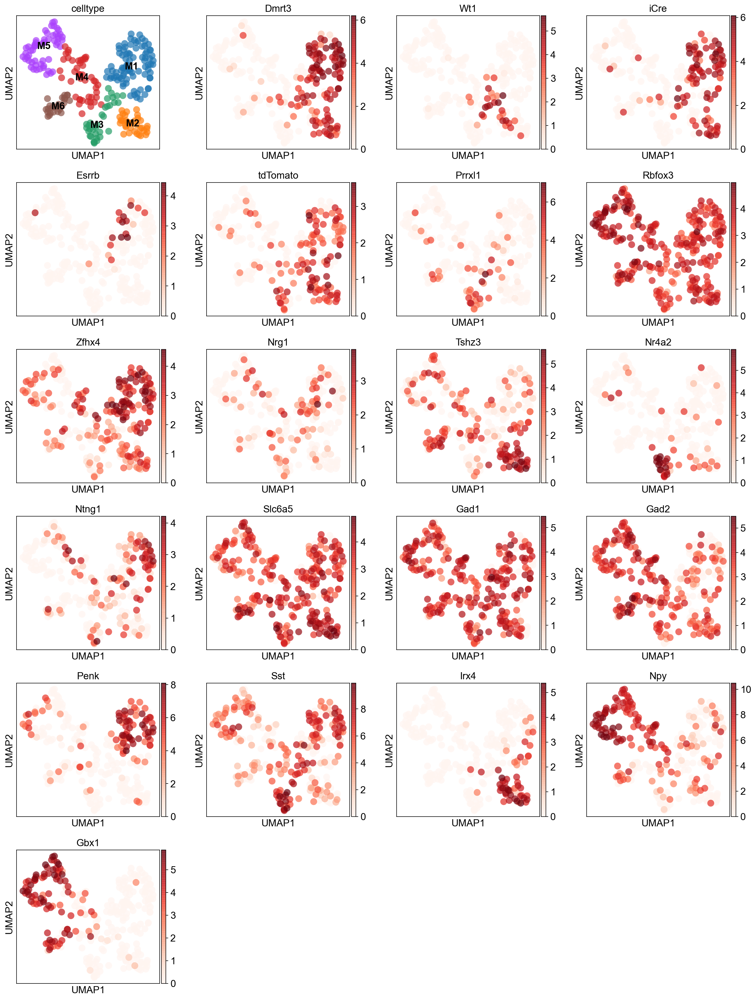

In [74]:
sc.pl.umap(adata_m_d, color=["celltype","Dmrt3", "Wt1", "iCre", "Esrrb","tdTomato", "Prrxl1", "Rbfox3", 'Zfhx4','Nrg1',"Tshz3", "Nr4a2", "Ntng1", "Slc6a5", "Gad1", "Gad2","Penk", "Sst", "Irx4", "Npy", "Gbx1"], save="_celltype_mouse_selected-genes.pdf", legend_loc="on data", cmap="Reds", alpha=0.7)

In [75]:
#find_DE_genes(adata_m_d, groupby="celltype")

In [76]:
def print_percent_expressing(adata, genes, th=0):
    """Prints percent of cells expressing the gene
    
    genes: Takes a list of genes or one str of a gene.
    th: is the expression level which a gene has to surpase to be considered expressed"""
    if isinstance(genes, str):
        genes = list(genes)
    for gene in genes:
        total_cells = adata.shape[0]
        expressing_genes = sum(adata[:, adata.var_names == gene].X>th)[0]
        percent = expressing_genes/total_cells*100
        print(f"{gene} is expressed in {expressing_genes} out of {total_cells}: {percent}%")
    

In [77]:
print("Gabaergic:")
gaba_m = ["Gad2", "Slc6a1"]
print_percent_expressing(adata_m_d, gaba_m)

print("glycenergic:")
glycine_m = ["Slc6a5", "Slc6a9"]
print_percent_expressing(adata_m_d, glycine_m)

Gabaergic:
Gad2 is expressed in 214 out of 274: 78.1021897810219%
Slc6a1 is expressed in 228 out of 274: 83.21167883211679%
glycenergic:
Slc6a5 is expressed in 252 out of 274: 91.97080291970804%
Slc6a9 is expressed in 88 out of 274: 32.11678832116788%


## DE genes Fish

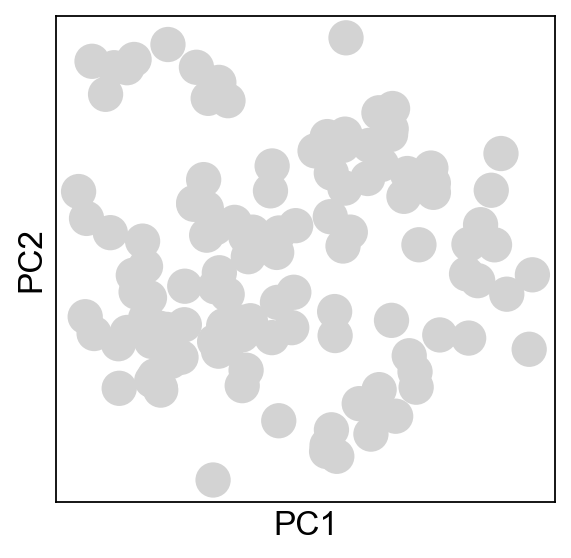

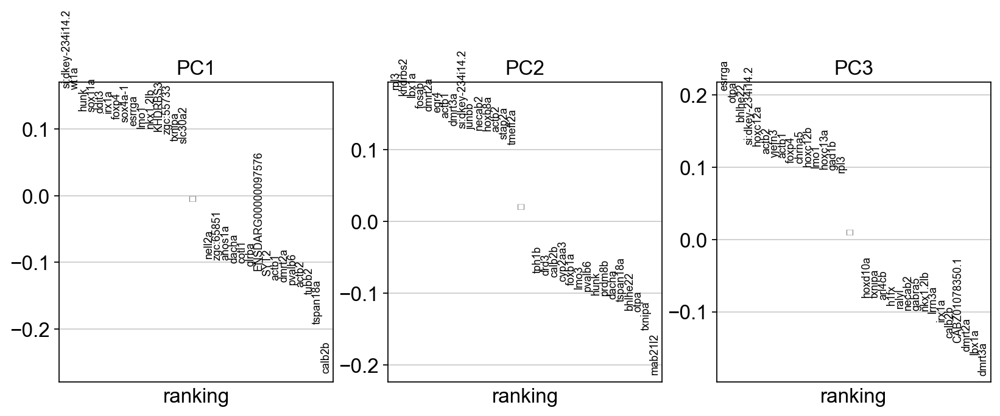

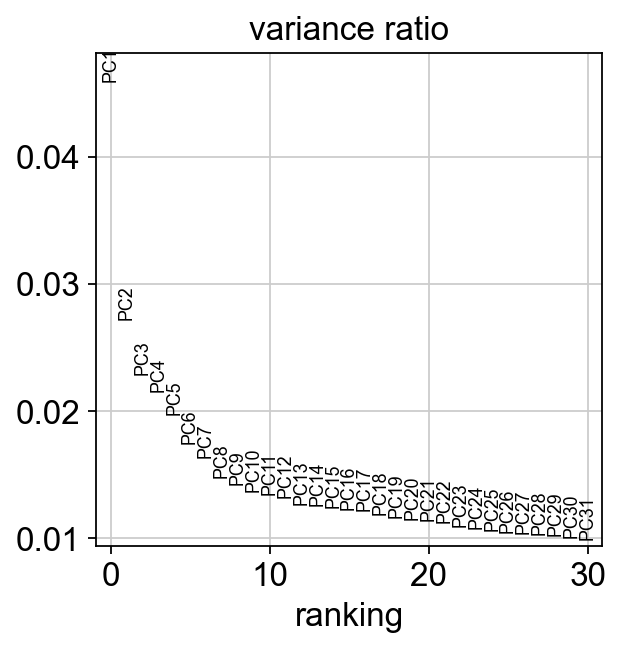

In [78]:
sc.pp.pca(adata_f_d)
sc.pl.pca_overview(adata_f_d)

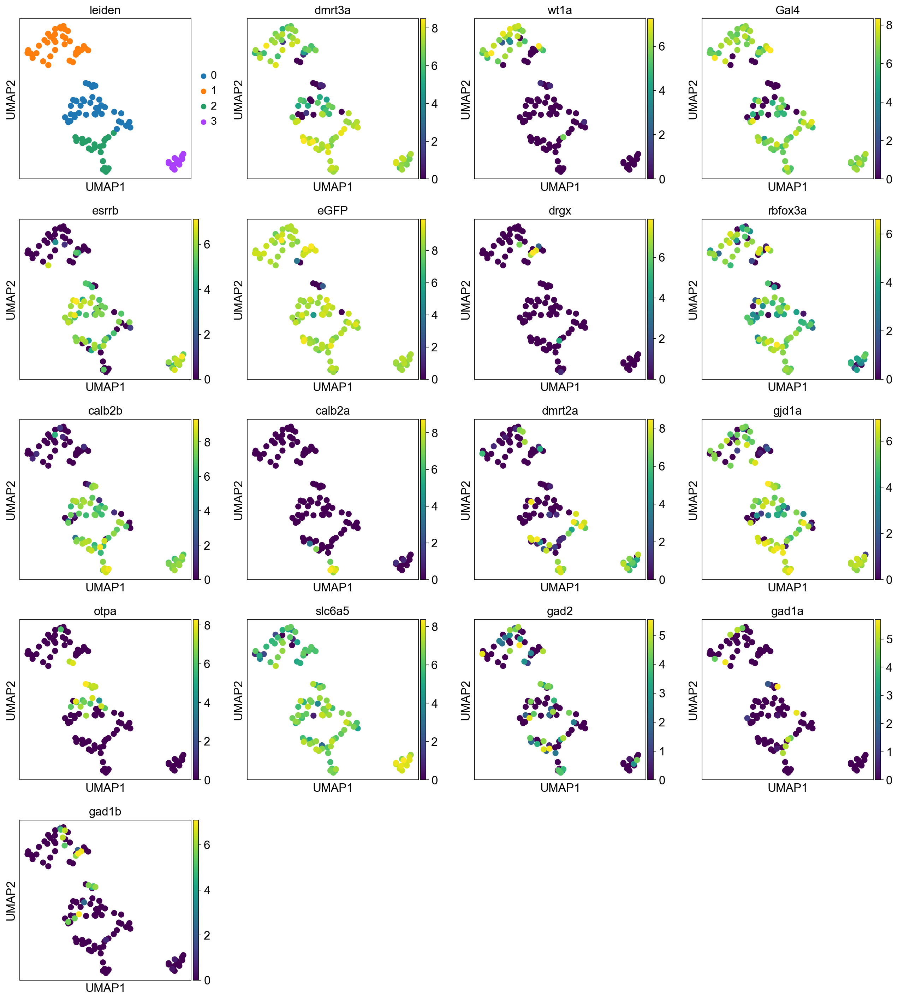

In [79]:
figure="dmrt3"
sc.settings.figdir=f"figures/{date}/{figure}"

sc.pp.neighbors(adata_f_d, n_pcs=9, n_neighbors=10)
sc.tl.leiden(adata_f_d, resolution=0.4) # 0.2 produce 2 clusters with DE gene markers
sc.tl.umap(adata_f_d, random_state=0, min_dist=0.2)
sc.pl.umap(adata_f_d, color=["leiden","dmrt3a", "wt1a", "Gal4", "esrrb","eGFP","drgx","rbfox3a", "calb2b","calb2a","dmrt2a","gjd1a","otpa", "slc6a5", "gad2", "gad1a", "gad1b"], save="_leiden_fish_selected-genes.pdf", size=240)

In [80]:
th=0
wt1_gene = "wt1a"
esrrb_gene = "esrrb"
calb_gene = "calb2b"
total = len(adata_f_d.obs_vector(wt1_gene))
wt1 = sum(adata_f_d.obs_vector(wt1_gene)>th)
esrrb = sum(adata_f_d.obs_vector(esrrb_gene)>th)
calb = sum(adata_f_d.obs_vector(calb_gene)>th)


double_wt1_esrrb = sum(np.logical_and(adata_f_d.obs_vector(esrrb_gene)>th, adata_f_d.obs_vector(wt1_gene)>th))
double_wt1_calb = sum(np.logical_and(adata_f_d.obs_vector(calb_gene)>th, adata_f_d.obs_vector(wt1_gene)>th))
double_not_wt1_esrrb = total - sum(np.logical_or(adata_f_d.obs_vector(wt1_gene)>th, adata_f_d.obs_vector(esrrb_gene)>th))
tripple_wt1_esrrb_calb = total - sum(np.logical_or(np.logical_or(adata_f_d.obs_vector(calb_gene)>th, adata_f_d.obs_vector(wt1_gene)>th), adata_f_d.obs_vector(esrrb_gene)>th))
p_wt1 = wt1/total
p_esrrb = esrrb/total
p_double_wt1_esrrb = double_wt1_esrrb/total
p_double_wt1_calb = double_wt1_calb/total
p_not_wt1_esrrb = double_not_wt1_esrrb/total
p_calb = calb/total
p_tripple = tripple_wt1_esrrb_calb/total

print(f"Wt1: {wt1} cells, {p_wt1*100}%")
print(f"Esrrb: {esrrb} cells, {p_esrrb*100}%")
print(f"calb: {calb} cells, {p_calb*100}%")
print(f"Dmrt3: {total} cells")

print(f"double wt1 esrrb: {double_wt1_esrrb} cells, {p_double_wt1_esrrb*100}%")
print(f"double wt1 calb: {double_wt1_calb} cells, {p_double_wt1_calb*100}%")
print(f"tripple NOT wt1 calb essrb: {tripple_wt1_esrrb_calb} cells, {p_tripple*100}%")
print(f"double NOT wt1 or esrrb: {double_not_wt1_esrrb} cells, {p_not_wt1_esrrb*100}%")
print(f"Total: {total}")




Wt1: 33 cells, 27.73109243697479%
Esrrb: 68 cells, 57.14285714285714%
calb: 78 cells, 65.54621848739495%
Dmrt3: 119 cells
double wt1 esrrb: 5 cells, 4.201680672268908%
double wt1 calb: 8 cells, 6.722689075630252%
tripple NOT wt1 calb essrb: 7 cells, 5.88235294117647%
double NOT wt1 or esrrb: 23 cells, 19.327731092436977%
Total: 119


## Temporal information leiden groups - fish

In [81]:
orth_var_names(temporal_long, "mmusculus", "drerio")

{'Early': ['onecut2'],
 'Middle': ['zfhx3', 'pou2f2a', 'zfhx4'],
 'Late': ['neurod6a', 'neurod6b'],
 'Dmrt3': ['dmrt3a']}

In [82]:
temporal_long_f = {
    'Early': ['onecut2'],
    'Middle': ['zfhx3','zfhx4', 'pou2f2a'],
    'Late': ['neurod2', 'neurod6a'],
    "Dmrt3": ["dmrt3a", "eGFP", "Gal4"]
}

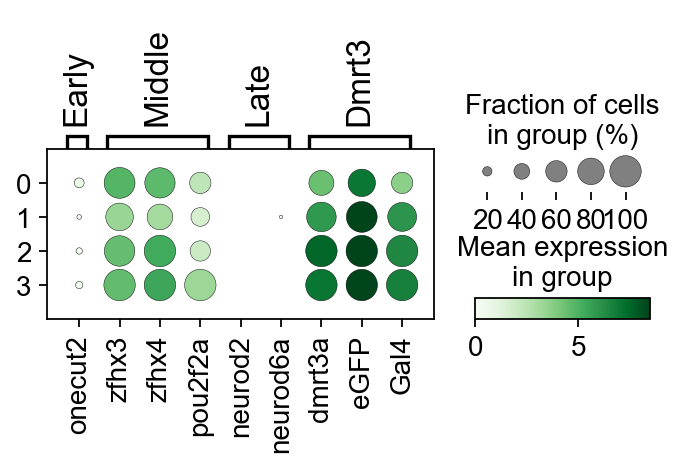

In [83]:
sc.pl.dotplot(adata_f_d, groupby="leiden", var_names=filter_dict(adata_f_d, temporal_long_f), save="_leiden_temporal_fish.pdf",cmap="Greens")

... storing 'celltype' as categorical


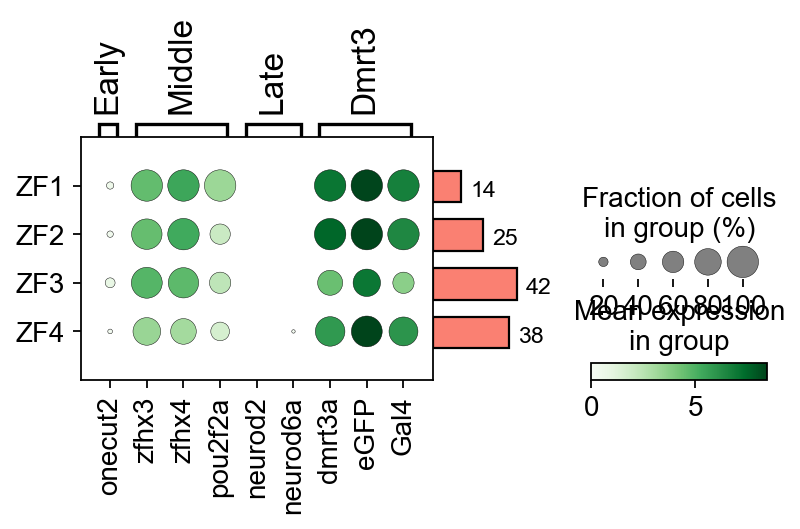

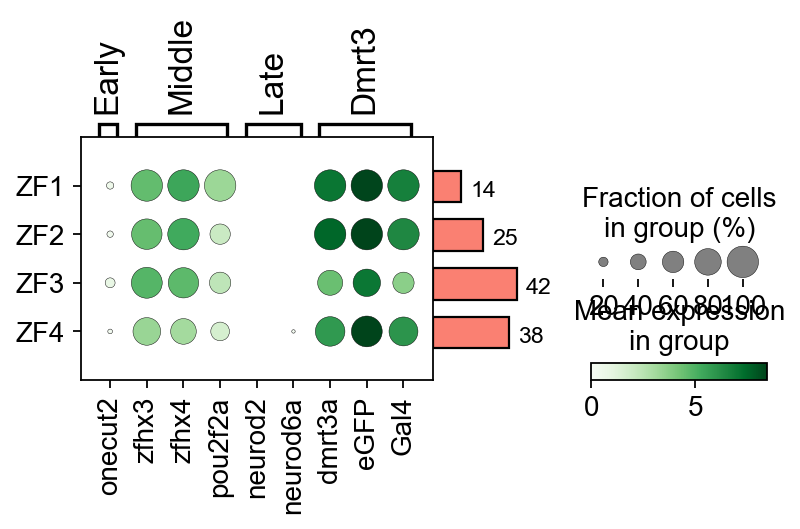

In [198]:
fish_remapping = {
    "3": "ZF1",
    "2": "ZF2",
    "0": "ZF3",
    "1": "ZF4"
}
adata_f_d.obs["celltype"] = [fish_remapping[leiden] for leiden in adata_f_d.obs["leiden"]]
dp = sc.pl.dotplot(adata_f_d, groupby="celltype", var_names=filter_dict(adata_f_d, temporal_long_f),cmap="Greens", return_fig=True, figsize=(5.5,2))
dp.add_totals().show()
dp.savefig(f"figures/{date}/{figure}/dotplot_celltype_temporal_fish.pdf")

## Spatial information
Next we will identify the rostro-caudal location of the cell types using the hox genes.

In [85]:
orth_var_names(hox_m, "mmusculus", "drerio")

{'hox': ['hoxc11b',
  'hmx4',
  'hoxb6a',
  'hoxc8a',
  'hoxd11a',
  'hoxc9a',
  'hoxd9a',
  'hoxd10a']}

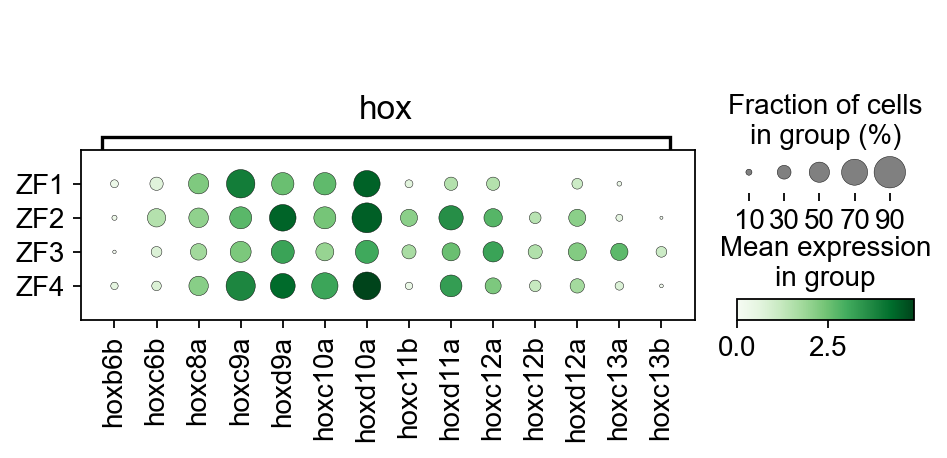

In [86]:
hox_f = {
    'Cervical': ['hoxb6a','hoxc6b','hoxc4a','hoxb5b','hoxb5a','hoxa5a','hoxc5a','hoxc6a'],
    'Thorasic': ['hmx4', 'hoxc9a', 'hoxc8a'],
    'Lumbar': ['hoxd11a', 'hoxc11b', 'hoxd10a', 'hoxa11a', 'hoxc11a', 'hoxc10a', 'hoxd9a'],
    'Sacral': ['hoxc12a', 'hoxd12a', 'hoxc13a', 'hoxc13b', 'hoxb13a', 'hoxc12b']}
hox_f = {"hox": ["hoxb6b", "hoxc6b", "hoxc8a", "hoxc9a", "hoxd9a", "hoxc10a", "hoxd10a", "hoxc11b", "hoxd11a", "hoxc12a", "hoxc12b", "hoxd12a", "hoxc13a", "hoxc13b"]}
sc.pl.dotplot(adata_f_d, groupby="celltype", var_names=filter_dict(adata_f_d, hox_f), save="_celltype_hox_fish.pdf",cmap="Greens")

In [87]:
de_genes = find_DE_genes(adata_f_d, "celltype")
for k, v in de_genes.items():
    print(f"group {k} has {len(v)} DE genes, top: {v[0:3]}")

group ZF1 has 573 DE genes, top: ['dacha', 'pcdh17', 'cox6b1']
group ZF4 has 407 DE genes, top: ['si:dkey-234i14.2', 'wt1a', 'tshz2']
group ZF3 has 31 DE genes, top: ['stxbp5l', 'bhlhe22', 'otpa']
group ZF2 has 102 DE genes, top: ['atp2b4', 'dmrt3a', 'calb2b']


In [88]:
#Number of cells per cell type
adata_f_d.obs["celltype"].value_counts()

ZF3    42
ZF4    38
ZF2    25
ZF1    14
Name: celltype, dtype: int64

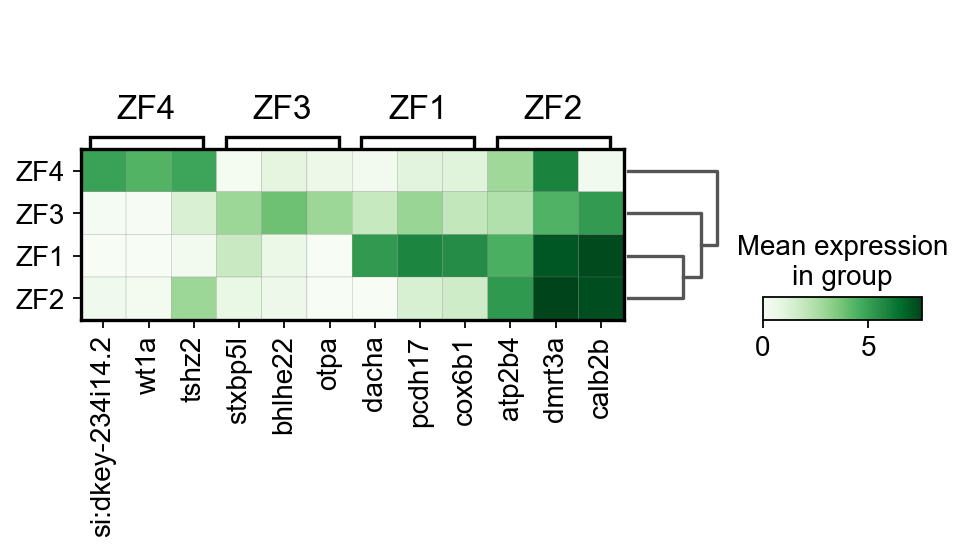

In [89]:
figure="dmrt3"
sc.settings.figdir=f"figures/{date}/{figure}"

sc.tl.dendrogram(adata_f_d, groupby="celltype")
sc.tl.rank_genes_groups(adata_f_d, groupby="celltype", method="t-test")
sc.pl.rank_genes_groups_matrixplot(adata_f_d, n_genes=3, groupby="celltype", save="_celltype_DE-genes_fish.pdf", cmap="Greens")

Finally, lets plot selected genes of interest on the UMAP projecection.

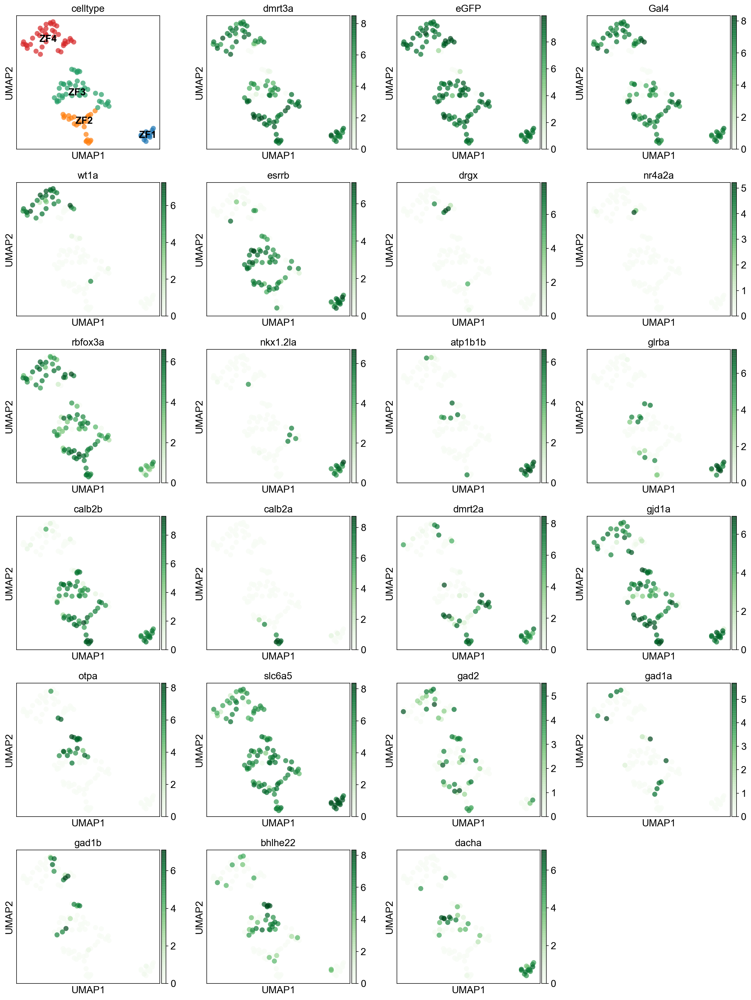

In [192]:
sc.pl.umap(adata_f_d, color=["celltype","dmrt3a","eGFP", "Gal4", "wt1a", "esrrb","drgx","nr4a2a","rbfox3a", "nkx1.2la", "atp1b1b", "glrba", "calb2b","calb2a","dmrt2a","gjd1a","otpa", "slc6a5", "gad2", "gad1a", "gad1b", "bhlhe22", "dacha"], save="_celltype_fish_selected-genes.pdf", legend_loc="on data", size=240, cmap="Greens", alpha=0.7)

In [91]:
print("Gabaergic:")
gaba_f = ["gad2", "slc6a1a", "slc6a1b"]
print_percent_expressing(adata_f_d, gaba_f)
print("glycinergic:")
glycine_f = ["slc6a5", "slc6a9"]
print_percent_expressing(adata_f_d, glycine_f)

Gabaergic:
gad2 is expressed in 51 out of 119: 42.857142857142854%
slc6a1a is expressed in 17 out of 119: 14.285714285714285%
slc6a1b is expressed in 8 out of 119: 6.722689075630252%
glycinergic:
slc6a5 is expressed in 115 out of 119: 96.63865546218487%
slc6a9 is expressed in 43 out of 119: 36.134453781512605%


# Impute electrophysiological propterties
[Tripathy et. al.](https://journals.plos.org/ploscompbiol/article?rev=2&id=10.1371/journal.pcbi.1005814) identified gene sets correlated to electrophysiological reading. Here we will use these gene sets to impute the Ephys properties of cells.



In [231]:
from sklearn.preprocessing import binarize
#from matplotlib.colors import DivergingNorm

In [232]:
figure="ephys"
sc.settings.figdir=f"figures/{date}/{figure}"

In [233]:
ephys = pd.read_excel("data/pcbi.1005814.s009.xlsx")

In [234]:
ephys

,§,EphysProp,GeneSymbol,GeneName,GeneEntrezID,DiscProbeID,DiscCorr,DiscUncorrPval,DiscFDR,AIBSCorr,AIBSUncorrPval,AIBSFDR,AIBSMeanExpr (log2 TPM+1),AIBSConsistent
0,1,AHPamp,Epha4,Eph receptor A4,13838,1421929_at,-0.78,1.723547e-06,0.001349,-0.34,0.29,0.545807,5.43,1
1,2,AHPamp,Lmo4,LIM domain only 4,16911,1420981_a_at,-0.76,3.366948e-06,0.001349,-0.45,0.15,0.381322,5.49,1
2,3,AHPamp,Add2,adducin 2 (beta),11519,1421975_a_at,-0.75,4.302396e-06,0.001349,-0.50,0.10,0.319423,4.94,1
3,4,AHPamp,Lingo1,leucine rich repeat and Ig domain containing 1,235402,1428118_at,-0.75,4.810197e-06,0.001349,-0.65,0.03,0.197613,4.39,1
4,5,AHPamp,Ppp3r1,"protein phosphatase 3, regulatory subunit B, a...",19058,1433591_at,-0.75,3.684435e-06,0.001349,-0.60,0.04,0.226066,7.40,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
999,1000,Vrest,H2-M3,"histocompatibility 2, M region locus 3",14991,1421358_at,0.69,1.992915e-05,0.003888,0.36,0.25,0.614572,2.80,1
1000,1001,Vrest,Prmt2,protein arginine N-methyltransferase 2,15468,1416844_at,0.71,8.265400e-06,0.002705,0.55,0.07,0.470760,7.38,1
1001,1002,Vrest,Plin2,perilipin 2,11520,1448318_at,0.72,5.843659e-06,0.002249,0.03,0.94,0.976315,1.72,1
1002,1003,Vrest,Nsdhl,NAD(P) dependent steroid dehydrogenase-like,18194,1416222_at,0.76,1.722909e-06,0.001197,0.52,0.09,0.484469,5.07,1


In [235]:
def score_ephys(adata, source="Disc", fdr=0.01):
    
    for p in set(ephys["EphysProp"]):
        prop = ephys[ephys["EphysProp"]==p]

        scores = list()
        for gene in prop.iterrows():
            g = gene[1].GeneSymbol
            c = gene[1][source+"Corr"]
            _fdr = gene[1][source+"FDR"]
            if _fdr < fdr:
                try:
                    s = adata.obs_vector(g)
                    score = s*c
                    scores.append(score)
                except:
                    print(f"gene {g} not in dataset, skipped")
                    
        if len(scores) > 0:
            imputed_score = pd.DataFrame(scores).mean().values
        else:
            imputed_score = 0
            
        adata.obs[p] = imputed_score
            

    

In [236]:
score_ephys(adata_m_d, source="Disc", fdr=0.1)

gene Ccdc132 not in dataset, skipped
gene Gucy1b3 not in dataset, skipped
gene Cecr6 not in dataset, skipped
gene 2021-09-07 00:00:00 not in dataset, skipped
gene Fam188a not in dataset, skipped
gene Rgs14 not in dataset, skipped
gene Gucy1b3 not in dataset, skipped
gene Large not in dataset, skipped
gene Mfsd4 not in dataset, skipped
gene Ar not in dataset, skipped
gene Gucy1b3 not in dataset, skipped
gene Hn1 not in dataset, skipped
gene Pdcd2 not in dataset, skipped
gene H2afj not in dataset, skipped
gene Zfp191 not in dataset, skipped
gene 1110004E09Rik not in dataset, skipped
gene Gucy1b3 not in dataset, skipped
gene Fam178a not in dataset, skipped
gene Fam134b not in dataset, skipped
gene Dos not in dataset, skipped
gene H2afy not in dataset, skipped
gene 6330416G13Rik not in dataset, skipped
gene Wbscr27 not in dataset, skipped


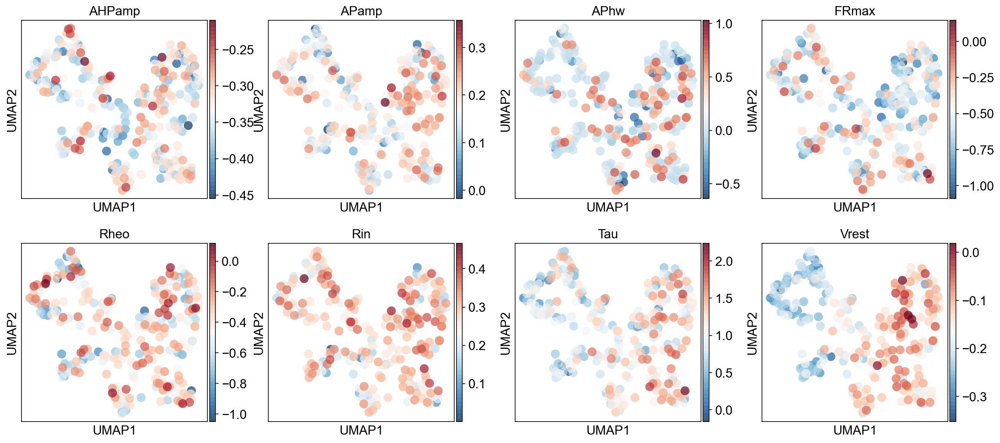

In [237]:
sc.pl.umap(adata_m_d, color=[
    'AHPamp',
    'APamp',
    'APhw',
    'FRmax',
    'Rheo',
    'Rin',
    'Tau',
    'Vrest'],
    color_map="RdBu_r",
    alpha=0.7,
    save="_mouse.pdf",
)

In [238]:
df = adata_m_d.obs[["celltype",
    'AHPamp',
    'APamp',
    'APhw',
    'FRmax',
    'Rheo',
    'Rin',
    'Tau',
    'Vrest']]
df

,celltype,AHPamp,APamp,APhw,FRmax,Rheo,Rin,Tau,Vrest
A1,M1,-0.326094,0.169228,0.576735,-0.768318,-0.336044,0.163236,1.072643,-0.114683
A2,M1,-0.375439,0.258446,0.537645,-0.762477,-0.226224,0.340776,1.120597,-0.102495
A3,M1,-0.324366,0.220132,0.000000,-0.695403,-0.610690,0.355635,1.036110,-0.024038
A4,M5,-0.294468,0.109918,0.000000,-0.109160,-0.491323,0.219517,0.941538,-0.198062
A5,M3,-0.286338,0.144959,-0.099462,-0.491244,-0.684468,0.256863,1.203196,-0.076730
...,...,...,...,...,...,...,...,...,...
P13,M1,-0.346090,0.221359,0.918991,-0.620802,-0.493338,0.382051,1.516988,-0.125170
P15,M4,-0.352324,0.124743,0.000000,-0.225446,-0.345754,0.065147,0.891432,-0.073731
P17,M2,-0.389713,0.195643,0.000000,-0.537088,-0.347557,0.216083,1.102664,-0.147803
P18,M5,-0.397433,0.160788,0.592170,-0.436854,-1.032617,0.281761,1.494457,-0.304152


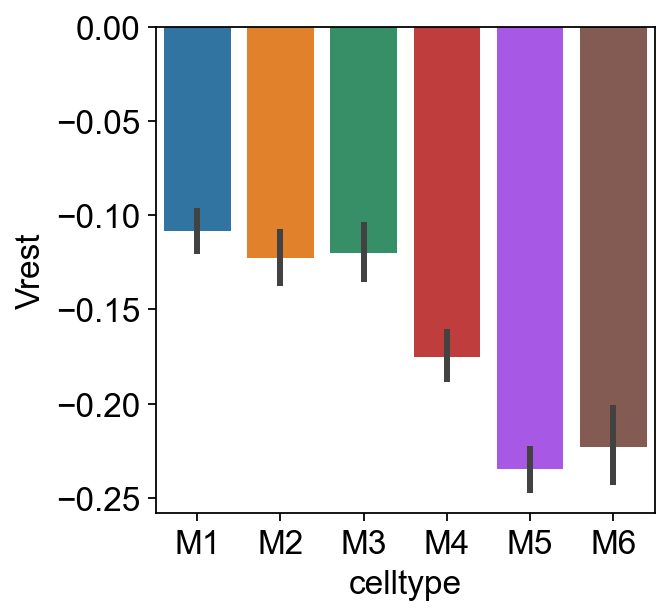

In [239]:
sns.barplot(data = df, x="celltype", y="Vrest", ci=95)
plt.grid(b=False)
plt.savefig(f"figures/{date}/{figure}/Vrest.pdf")

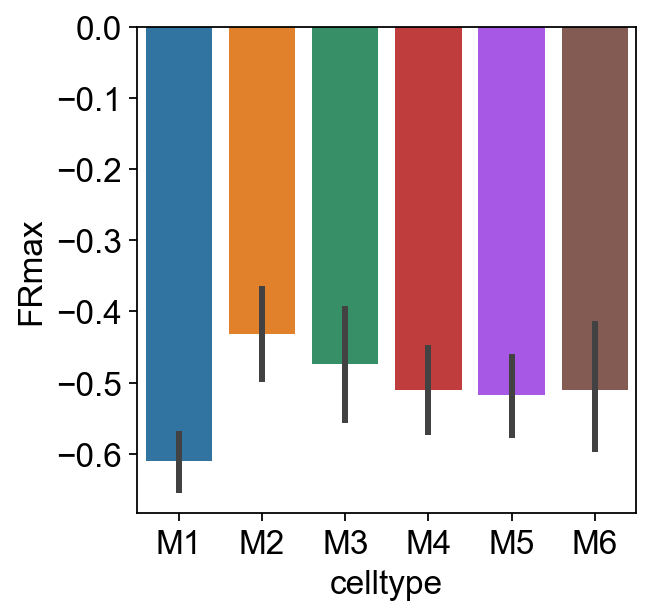

In [240]:
sns.barplot(data = df, x="celltype", y="FRmax", ci=95)
plt.grid(b=False)
plt.savefig(f"figures/{date}/{figure}/FRmax.pdf")

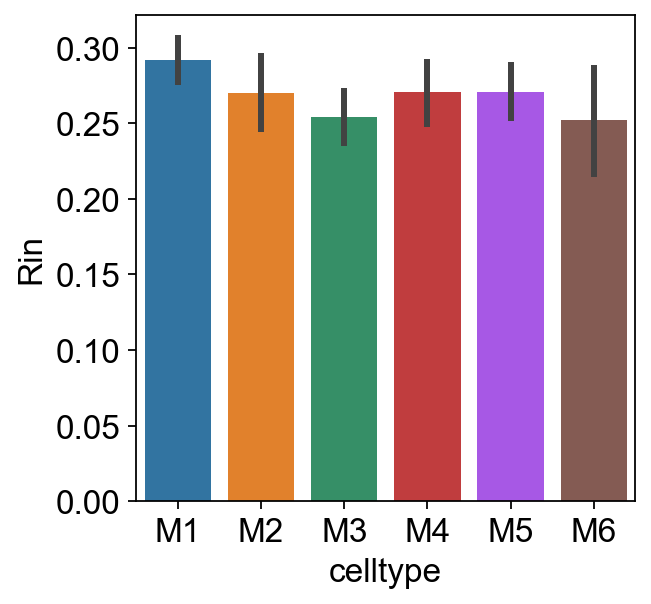

In [241]:
sns.barplot(data = df, x="celltype", y="Rin", ci=95)
plt.grid(b=False)
plt.savefig(f"figures/{date}/{figure}/Rin.pdf")

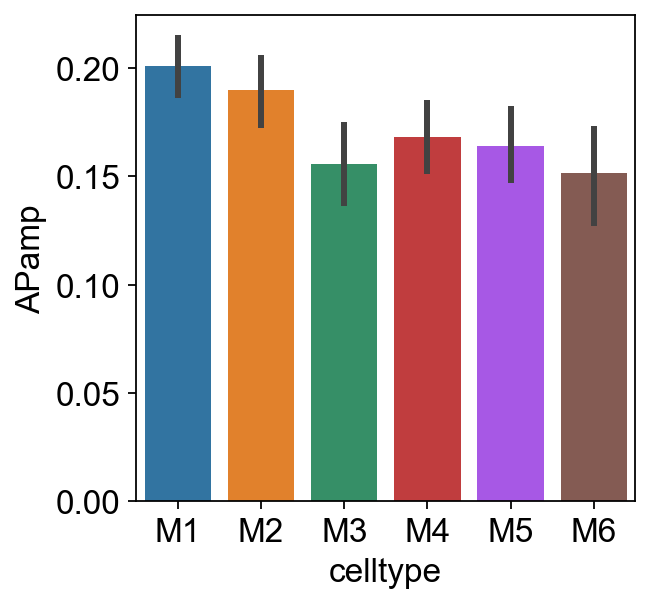

In [242]:
sns.barplot(data = df, x="celltype", y="APamp", ci=95)
plt.grid(b=False)
plt.savefig(f"figures/{date}/{figure}/APamp.pdf")

In [243]:
df.to_excel(f"figures/{date}/ephys/ephys.xlsx")

# DE genes
Here we extract all DE genes detected for the mouse and fish dmrt3 cell types, and for the initial leiden groups detected from the original datasets

In [104]:
with pd.ExcelWriter(f"figures/{date}/Supplimentary files/DE_genes.xlsx") as writer:
    sc.tl.rank_genes_groups(adata_f_d, groupby="celltype")
    for group in list(set(adata_f_d.obs["celltype"])):
        de = sc.get.rank_genes_groups_df(adata_f_d, group=group)
        de.to_excel(writer, sheet_name=group)
        
    sc.tl.rank_genes_groups(adata_m_d, groupby="celltype")    
    for group in list(set(adata_m_d.obs["celltype"])):
        de = sc.get.rank_genes_groups_df(adata_m_d, group=group)
        de.to_excel(writer, sheet_name=group)

In [105]:
# Export all DE genes for each group
sc.tl.rank_genes_groups(adata_m, groupby="leiden") # method="t-test_overestim_var"

with pd.ExcelWriter(f"figures/{date}/Supplimentary files/DE_genes_all_group_mouse.xlsx") as writer:
    for group in adata_m.obs["leiden"].unique():
        de = sc.get.rank_genes_groups_df(adata_m, group=str(group), pval_cutoff=0.05)
        de.to_excel(writer, sheet_name=group)


In [106]:
# Export all DE genes for each group
sc.tl.rank_genes_groups(adata_f, groupby="leiden") #  method="t-test_overestim_var"

with pd.ExcelWriter(f"figures/{date}/Supplimentary files/DE_genes_all_group_fish.xlsx") as writer:
    for group in adata_f.obs["leiden"].unique():
        de = sc.get.rank_genes_groups_df(adata_f, group=str(group), pval_cutoff=0.05)
        de.to_excel(writer, sheet_name=group)


# Compare similarity between groups found in fish and mouse dataset

In [107]:

def correlate_groups(
    from_adata, 
    to_adata, 
    species, 
    target, 
    groupby="leiden", 
    method = "score_genes", 
    top_genes=3, 
    de_method="t-test"):
    """
    Finds a similarity score from clusters in one dataset of one species, to clusters in another species

    from_adata and to_adata should have leiden groups available
    species and target is species annotations such as "mmusculus", or "drerio"
    Method can be:
    score_genes
    score_genes_sc
    marker_gene_overlap
    """

    # I store functions here to keep everything together
    
    # find all DE genes for each group
    def find_DE_genes(adata):
        sc.tl.rank_genes_groups(adata, groupby=groupby, method=de_method)

        #get a set of all groups
        groups = set(adata.obs[groupby].values)
        genes_groups = dict()
        for group in groups:
            genes = sc.get.rank_genes_groups_df(adata, group=group)

            # only select the genes with a adjusted pvalue lower than 0.05 and positive score
            genes = genes["names"][np.logical_and(genes.pvals_adj<0.05, genes.scores > 0)].values
            if len(genes) < top_genes:
                print(f"Note: Only {len(genes)} DE genes were detected for {group}")
            genes_groups[group] = list(genes)[0:top_genes]  #only investigate top x DE genes

        return genes_groups
    
    
    # this funtion takes a curated dictionary of genes from species and mapps what is possible to target
    def orth_var_names(var_dict, species, target):
        from scConnect.database import find_orth_gene

        orth_marker_ct = dict()

        for k, v in var_dict.items():
            orth_genes = []
            for gene in var_dict[k]:
                orth_gene = find_orth_gene(gene, species, target)
                if len(orth_gene) > 0:
                    for gene in orth_gene:
                        orth_genes.append(gene)
                        
            if len(orth_genes) > 0:            
                orth_marker_ct[k] = list(dict.fromkeys(orth_genes)) # to keep the same order (most DE gene first)
        
        print(orth_marker_ct)
        return orth_marker_ct

    
    
    print(f"Running {method} using {top_genes} top genes and DE method {de_method}")
    # start by finding DE genes
    print(f"Finding DE genes for {species}...")
    de = find_DE_genes(from_adata)
    print(f"Finding DE genes for {target}...")
    de_to = find_DE_genes(to_adata)
    
    # Find orthologous de genes
    print(f"Finding orthologous genes in {target}...")
    orth_de = orth_var_names(de, species, target)
    
    
    
    # Uses the gene scoring function in scanpy
    if method == "score_genes":
        # produce gene scores for each de set in species and store this in target dataset
        for k, v in orth_de.items():
            # score genes function will add a score for each cell in the original adata
            sc.tl.score_genes(to_adata, gene_list=v, score_name=f"{k}_score", ctrl_size=1000)

        # find the mean score among cells of the same group
        to_groups = set(list(to_adata.obs[groupby]))
        group_dict = dict()
        for to_group in to_groups:
            scores_dict = dict()
            for from_group in orth_de.keys():
                score = to_adata[to_adata.obs[groupby] == to_group].obs[f"{from_group}_score"].mean()
                scores_dict[from_group] = score
            group_dict[to_group] = scores_dict


        df = pd.DataFrame(group_dict)
        df.rename_axis(f"From {species}", axis = 0, inplace=True)
        df.rename_axis(f"To {target}", axis = 1, inplace=True)
    
    
    
    
        # Uses the gene scoring function in scanpy
    if method == "score_genes_sc":
        # produce gene scores for each de set in species and store this in target dataset
        for k, v in orth_de.items():
            # score genes function will add a score for each cell in the original adata
            sc.tl.score_genes(to_adata, gene_list=v, score_name=f"{k}_score", ctrl_size=1000, n_bins=25)
        
        
        return to_adata
    
    # Uses the marker gene overlap function in scanpy
    if method == "marker_gene_overlap":
        df = sc.tl.marker_gene_overlap(to_adata, orth_de, adj_pval_threshold=0.05, method="overlap_coef")
        df.rename_axis(f"From {species}", axis = 0, inplace=True)
        df.rename_axis(f"To {target}", axis = 1, inplace=True)

        
        
        
    # Use the gene expression in to_adata for the top number of DE genes in from_adata
    if method == "gene_expression":
        from_groups_dict = dict()
        to_groups = list(dict.fromkeys(to_adata.obs[groupby]))
        for from_group, genes in orth_de.items():
            to_groups_dict = dict()
            
            for to_group in to_groups:
                to_group_adata = to_adata[to_adata.obs[groupby] == to_group]
                genes_dict = dict()
                
                for gene in genes:
                    try:
                        gene_expression = to_group_adata[:,gene].X.mean()
                        gene_expression = float(gene_expression)
                    except: 
                        print(f"{gene} is not present in the to_adata.var_names")
                        gene_expression = 0                        
                    genes_dict[gene] = gene_expression
                to_groups_dict[to_group] = genes_dict
            from_groups_dict[from_group] = to_groups_dict
        
        df_dict = dict()
        for k in from_groups_dict.keys():
            df= pd.DataFrame(from_groups_dict[k])
            df.rename_axis("gene", axis=0)
            df_dict[k] = df
        df = df_dict
                
    return df

In [108]:
figure="compare_pop"
sc.settings.figdir=f"figures/{date}/{figure}"


## Score genes single cells



In [109]:
import plotly.express as px
import matplotlib
from matplotlib.colors import DivergingNorm
#from matplotlib.colors import CenteredNorm as DivergingNorm

In [110]:
adata_m_f = correlate_groups(adata_m_d, adata_f_d, "mmusculus", "drerio", 
                             groupby="celltype", 
                             method="score_genes_sc", 
                             de_method="t-test", 
                             top_genes=10)

Running score_genes_sc using 10 top genes and DE method t-test
Finding DE genes for mmusculus...
Finding DE genes for drerio...
Note: Only 5 DE genes were detected for ZF3
Finding orthologous genes in drerio...
{'M1': ['zfhx3', 'meis2a', 'zfhx4', 'mn1a', 'mn1b', 'olfm2a', 'olfm2b', 'tubb2', 'dmrt3a', 'penka', 'penkb', 'nefma', 'nefmb', 'nrp2b', 'nrp2a'], 'M4': ['hoxb8b', 'hoxb8a', 'hoxb7a', 'hoxb9a', 'pknox2', 'pcdh19', 'sez6b', 'sez6a', 'runx1t1', 'gad2', 'nrp1a'], 'M6': ['neurod6b', 'neurod6a', 'neurod2', 'zeb2a', 'neurod1', 'hoxb8b', 'hoxb8a', 'skor1b', 'skor1a', 'TCF4', 'nrxn3a'], 'M3': ['pid1', 'sst1.2', 'sst1.1', 'slit2', 'erbb4a', 'erbb4b', 'ERBB4', 'rpp25a', 'rpp25b', 'dachc', 'dachd', 'epha6', 'pcdh9', 'pcdh11'], 'M2': ['irx4a', 'irx4b', 'tshz3a', 'tshz3b', 'ldb2a', 'ldb2b', 'irx2a', 'march1', 'meis1b', 'cacna2d3', 'CACNA2D3', 'pbx3b'], 'M5': ['sall3b', 'sall3a', 'npy', 'nxph1', 'sez6b', 'sez6a', 'gbx1', 'runx1t1', 'hoxb8b', 'hoxb8a', 'kank1a', 'grm5a', 'grm5b', 'iqsec3b', 'iq

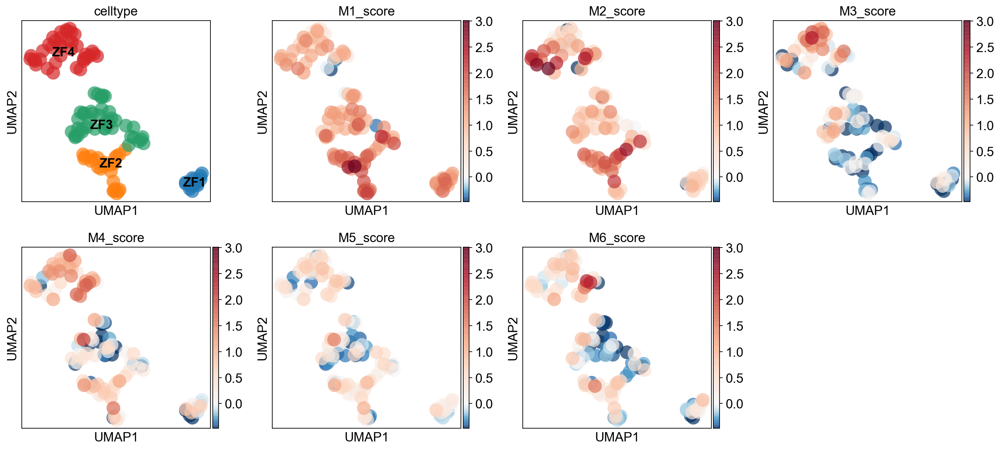

In [111]:
groups = list(set(adata_m_d.obs["celltype"]))
groups.sort()
groups = [f"{group}_score" for group in groups]

sc.pl.umap(adata_m_f, color=["celltype"] + groups, color_map="RdBu_r", norm=DivergingNorm(0), alpha=0.7, save="_score_genes_sc_mouse_to_fish_n_10.pdf", legend_loc="on data")

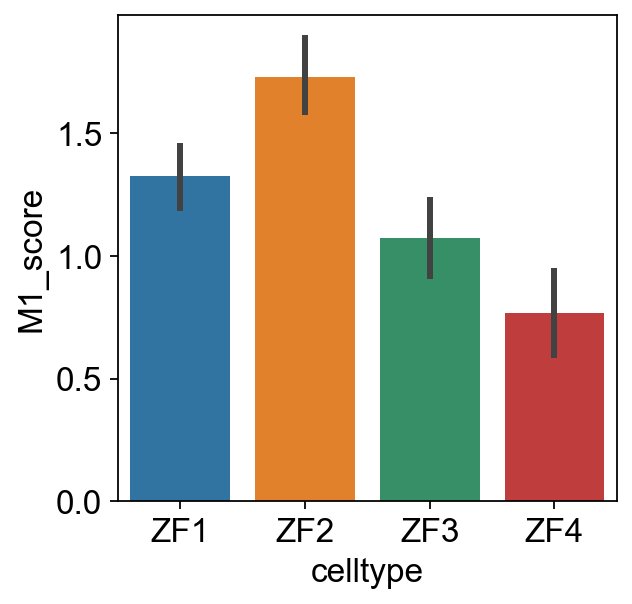

In [112]:
df  = adata_m_f.obs[["celltype"]+groups]
sns.barplot(data=df, x="celltype", y="M1_score", ci=95)
plt.grid(b=False)
plt.savefig(f"figures/{date}/{figure}/m_f_M1.pdf")

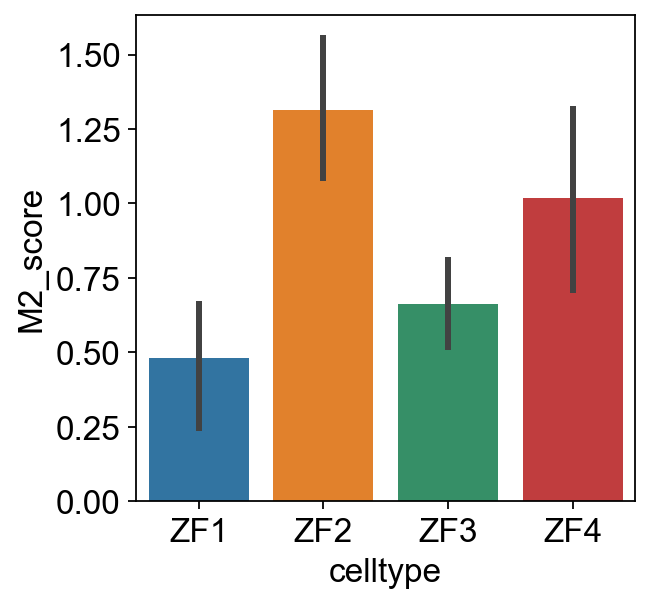

In [113]:

sns.barplot(data=df, x="celltype", y="M2_score", ci=95)
plt.grid(b=False)
plt.savefig(f"figures/{date}/{figure}/m_f_M2.pdf")

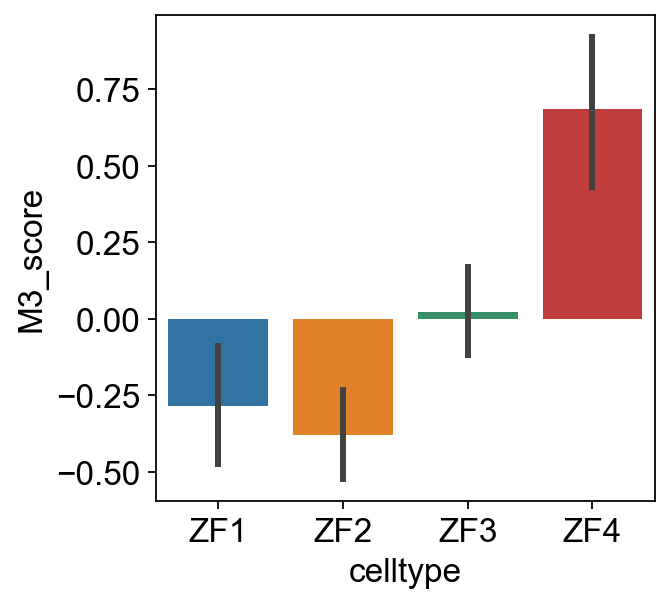

In [114]:

sns.barplot(data=df, x="celltype", y="M3_score", ci=95)
plt.grid(b=False)
plt.savefig(f"figures/{date}/{figure}/m_f_M3.pdf")

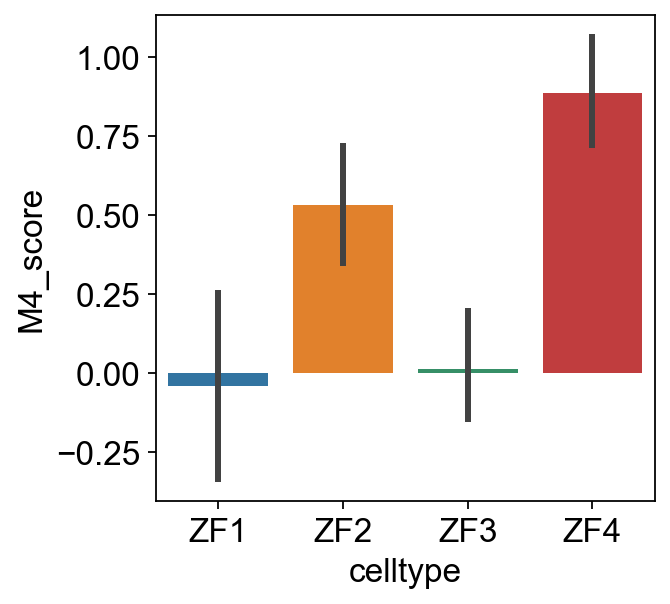

In [115]:

sns.barplot(data=df, x="celltype", y="M4_score", ci=95)
plt.grid(b=False)
plt.savefig(f"figures/{date}/{figure}/m_f_M4.pdf")

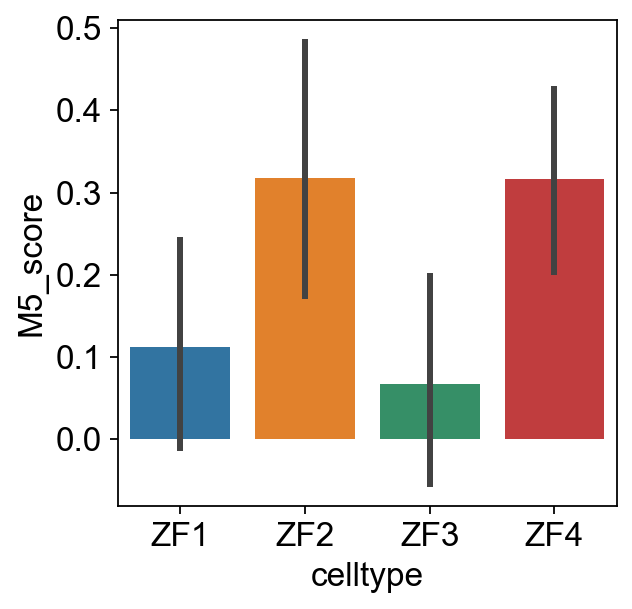

In [116]:
sns.barplot(data=df, x="celltype", y="M5_score", ci=95)
plt.grid(b=False)
plt.savefig(f"figures/{date}/{figure}/m_f_M5.pdf")

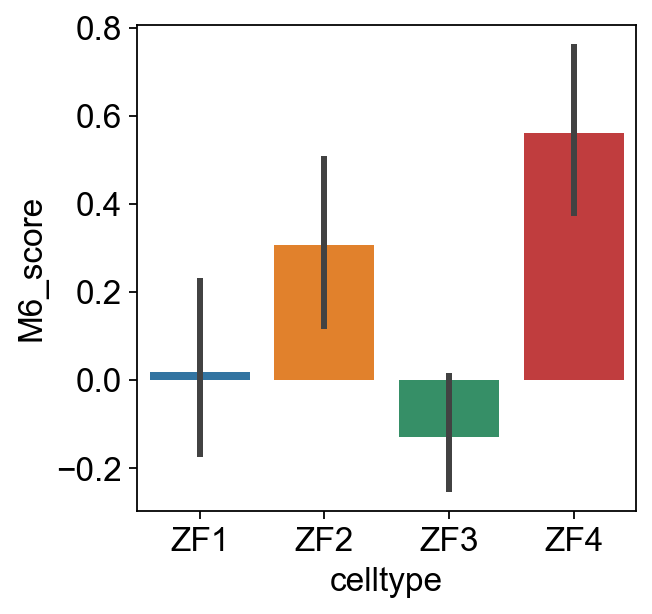

In [117]:
sns.barplot(data=df, x="celltype", y="M6_score", ci=95)
plt.grid(b=False)
plt.savefig(f"figures/{date}/{figure}/m_f_M6.pdf")

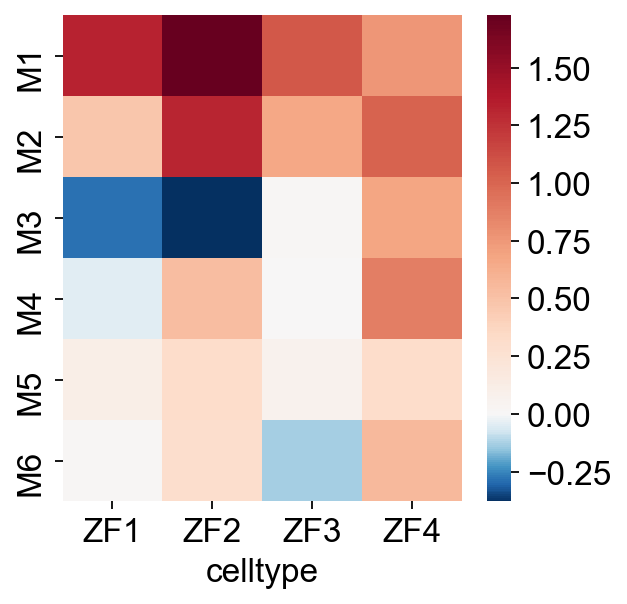

In [118]:
m_f_sc_score  = adata_m_f.obs[["celltype"]+groups]
m_f_sc_score = m_f_sc_score.pivot_table(index ="celltype")
m_f_sc_score.columns = [column.split("_")[0] for column in m_f_sc_score.columns]
sns.heatmap(m_f_sc_score.T, cmap="RdBu_r", norm=DivergingNorm(0))
plt.savefig(f"figures/{date}/compare_pop/score_gene_sc_mouse_to_fish_n_10.pdf", bbox_inches="tight")

In [119]:
adata_f_m = correlate_groups(adata_f_d, adata_m_d, "drerio", "mmusculus", 
                             groupby="celltype", 
                             method="score_genes_sc", 
                             de_method="t-test", 
                             top_genes=10)

Running score_genes_sc using 10 top genes and DE method t-test
Finding DE genes for drerio...
Note: Only 5 DE genes were detected for ZF3
Finding DE genes for mmusculus...
Finding orthologous genes in mmusculus...
{'ZF1': ['Pcdh17', 'Cox6b2', 'AI593442', 'Cyct', 'Pkm', 'Ahcyl1', 'Slc25a12'], 'ZF4': ['Wt1', 'Tshz2', 'Sox11', 'Foxp4', 'Ppdpf', 'Zbtb46', 'Hoxb8'], 'ZF3': ['Stxbp5l', 'Bhlhe22', 'Otp', 'Lmo3'], 'ZF2': ['Atp2b4', 'Dmrt3', 'Calb2', 'Rbfox3', 'Ppp3r1', 'Slc8a2', 'Ywhag', 'Snap25']}


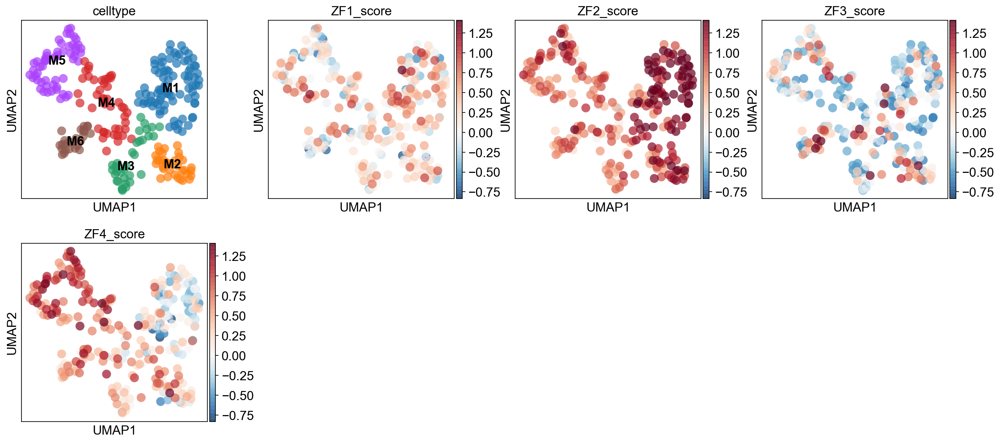

In [120]:
groups = list(set(adata_f_d.obs["celltype"]))
groups.sort()
groups = [f"{group}_score" for group in groups]

sc.pl.umap(adata_f_m, color=["celltype"]+groups, color_map="RdBu_r", norm=DivergingNorm(0), alpha=0.7, save="_score_genes_sc_fish_to_mouse_n_10.pdf", legend_loc="on data")


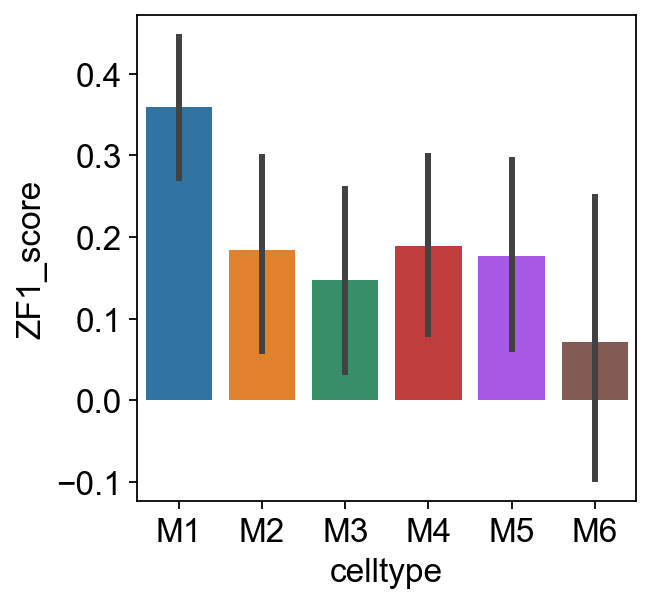

In [121]:
df  = adata_f_m.obs[["celltype"]+groups]

sns.barplot(data=df, x="celltype", y="ZF1_score", ci=95)
plt.grid(b=False)
plt.savefig(f"figures/{date}/{figure}/f_m_ZF1.pdf")

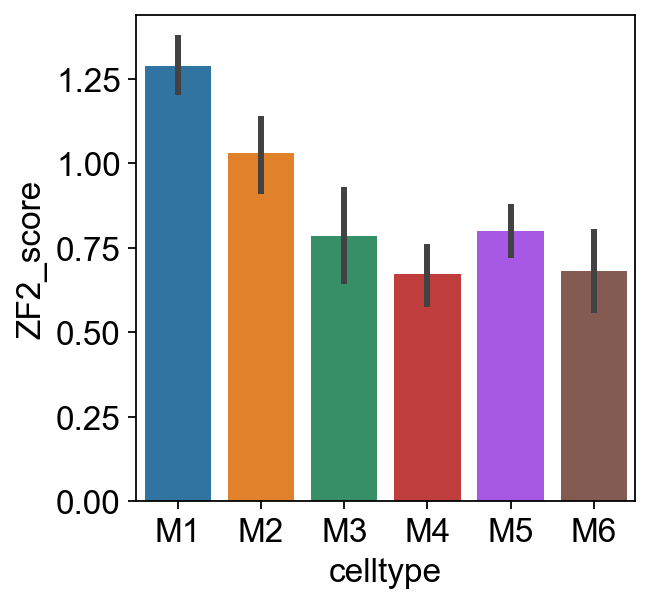

In [122]:
sns.barplot(data=df, x="celltype", y="ZF2_score", ci=95)
plt.grid(b=False)
plt.savefig(f"figures/{date}/{figure}/f_m_ZF2.pdf")

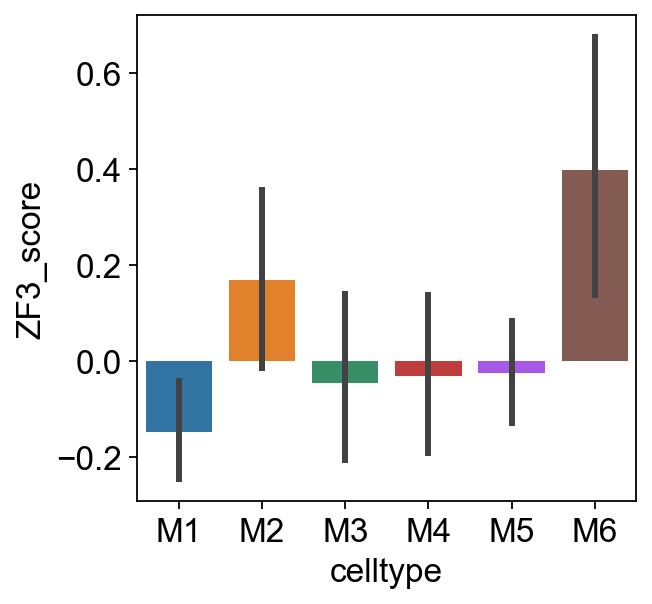

In [123]:
sns.barplot(data=df, x="celltype", y="ZF3_score", ci=95)
plt.grid(b=False)
plt.savefig(f"figures/{date}/{figure}/f_m_ZF3.pdf")

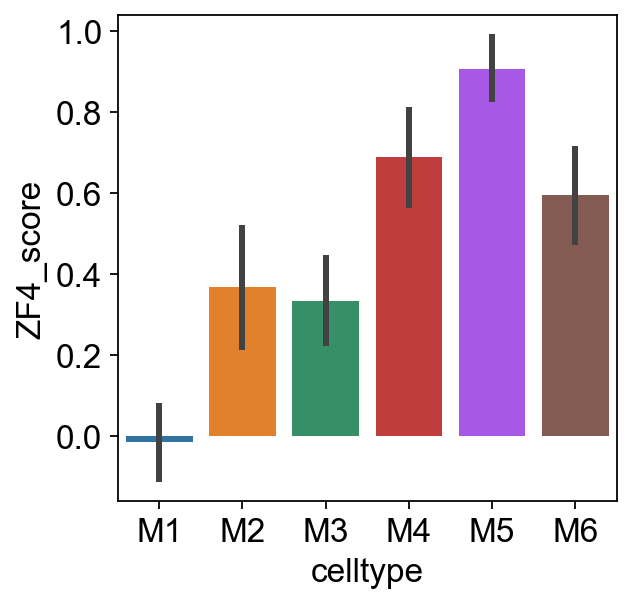

In [124]:
sns.barplot(data=df, x="celltype", y="ZF4_score", ci=95)
plt.grid(b=False)
plt.savefig(f"figures/{date}/{figure}/f_m_ZF4.pdf")

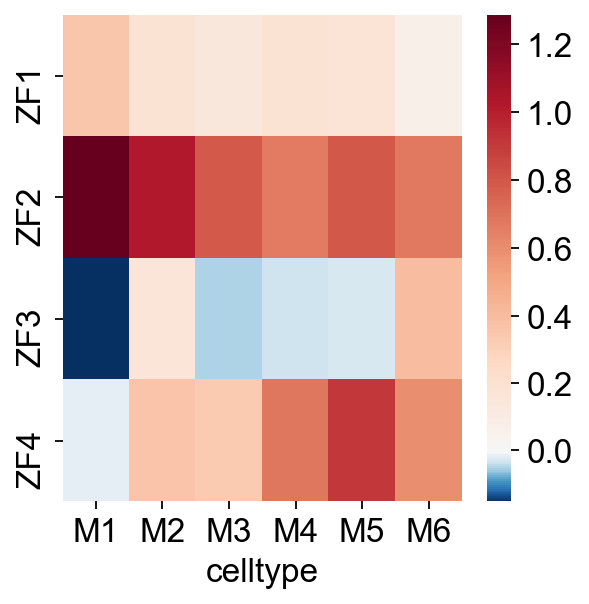

In [125]:
f_m_sc_score  = adata_f_m.obs[["celltype"]+groups]
f_m_sc_score = f_m_sc_score.pivot_table(index ="celltype")
f_m_sc_score.columns = [column.split("_")[0] for column in f_m_sc_score.columns]
sns.heatmap(f_m_sc_score.T, cmap="RdBu_r", norm=DivergingNorm(0))
plt.savefig(f"figures/{date}/compare_pop/score_gene_sc_fish_to_mouse_n_10.pdf", bbox_inches="tight")

# velocyto analysis

### Mouse velocyto

In [126]:
from importlib import reload
scv = reload(scv)

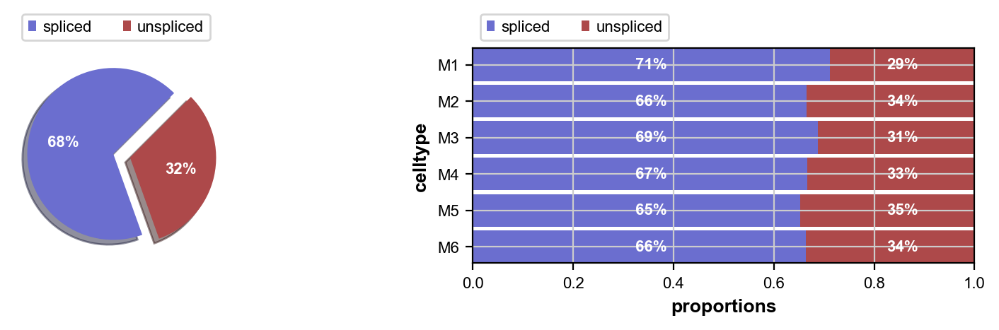

In [127]:
scv.pl.proportions(adata_m_d, groupby="celltype")

In [128]:
figure="velocyto"
scv.settings.figdir=f"figures/{date}/{figure}"
scv.pp.moments(adata_m_d)
sc.tl.diffmap(adata_m_d, n_comps=20)

Normalized count data: spliced, unspliced.
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [129]:
#scv.tl.recover_dynamics(adata_m_d, n_jobs=12, n_top_genes=1000)

In [130]:
scv.tl.velocity(adata_m_d, mode='stochastic')

computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


In [131]:
scv.tl.velocity_graph(adata_m_d)

computing velocity graph
    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


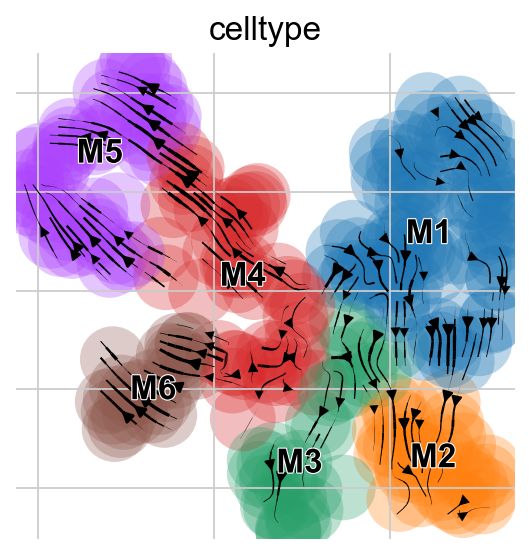

In [132]:
scv.pl.velocity_embedding_stream(adata_m_d, basis = "umap", color=["celltype"],  legend_loc="on data", show=True)# figsize=(10,10),
#plt.grid(b=False)
#plt.savefig(f"../figures/{date}/velocyto/celltype_mouse_velocyto.png", bbox_inches="tight", dpi=300)

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_diffmap', embedded velocity vectors (adata.obsm)


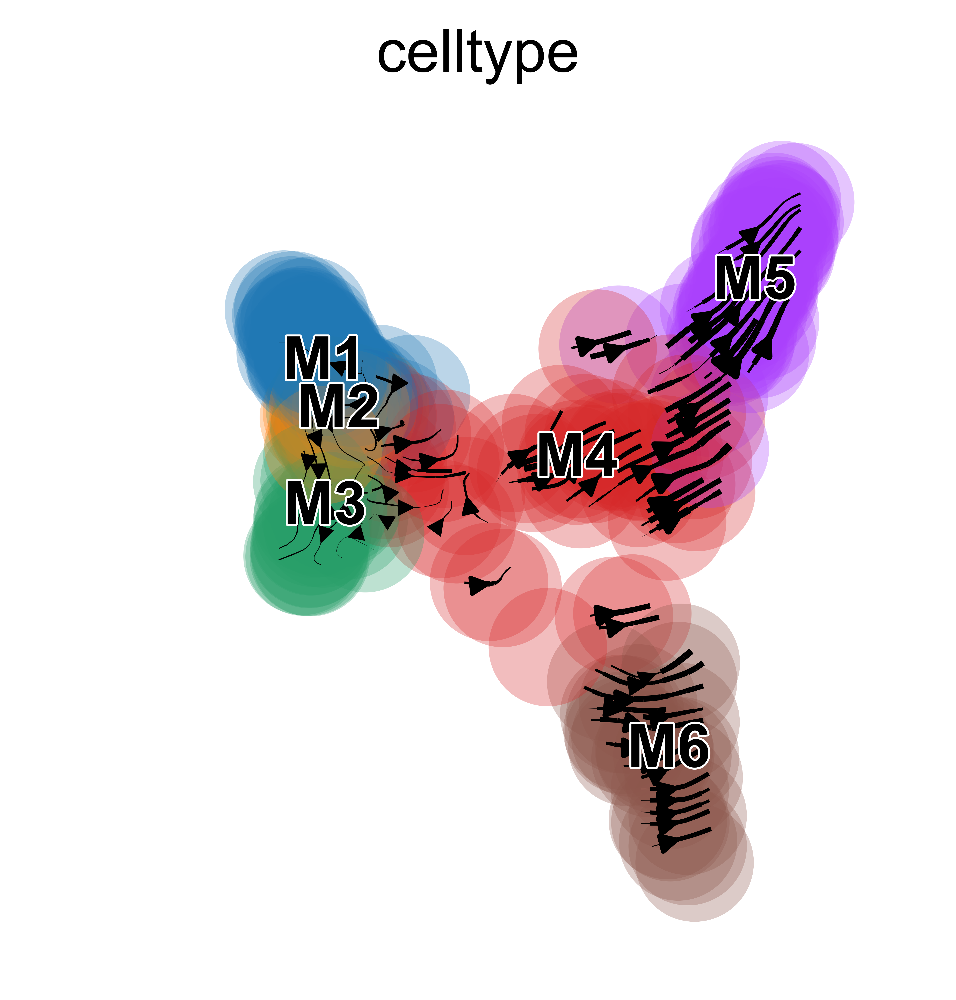

In [133]:
scv.pl.velocity_embedding_stream(
     adata_m_d, 
     basis = "diffmap", 
     color=["celltype"],  
     legend_loc="on data",
     dpi=700,
     xlim=[-0.15,0.15],
     ylim=[-0.25,0.15],
     frameon=False,
     show=False)
plt.grid(b=False)

plt.savefig(f"figures/{date}/velocyto/celltype_mouse_velocyto.png", bbox_inches="tight", dpi=700)
plt.show()

### Fish velocyto

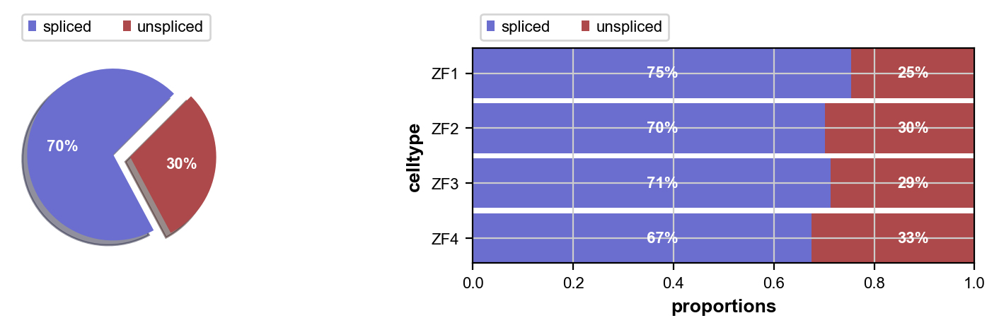

In [134]:
scv.pl.proportions(adata_f_d, groupby="celltype")

In [135]:
scv.pp.moments(adata_f_d)
sc.tl.diffmap(adata_f_d, n_comps=20)

Normalized count data: spliced, unspliced.
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [136]:
#scv.tl.recover_dynamics(adata_f_d, n_jobs=12, n_top_genes=1000)

In [137]:
scv.tl.velocity(adata_f_d, mode='stochastic')

computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


In [138]:
scv.tl.velocity_graph(adata_f_d)

computing velocity graph
    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


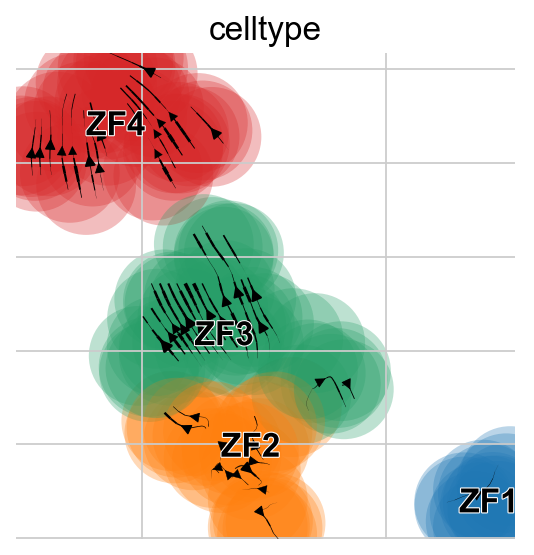

In [139]:
scv.pl.velocity_embedding_stream(adata_f_d, basis = "umap", color=["celltype"],  legend_loc="on data", show=True)# figsize=(10,10),
#plt.grid(b=False)
#plt.savefig(f"../figures/{date}/velocyto/celltype_mouse_velocyto.png", bbox_inches="tight", dpi=300)

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_diffmap', embedded velocity vectors (adata.obsm)


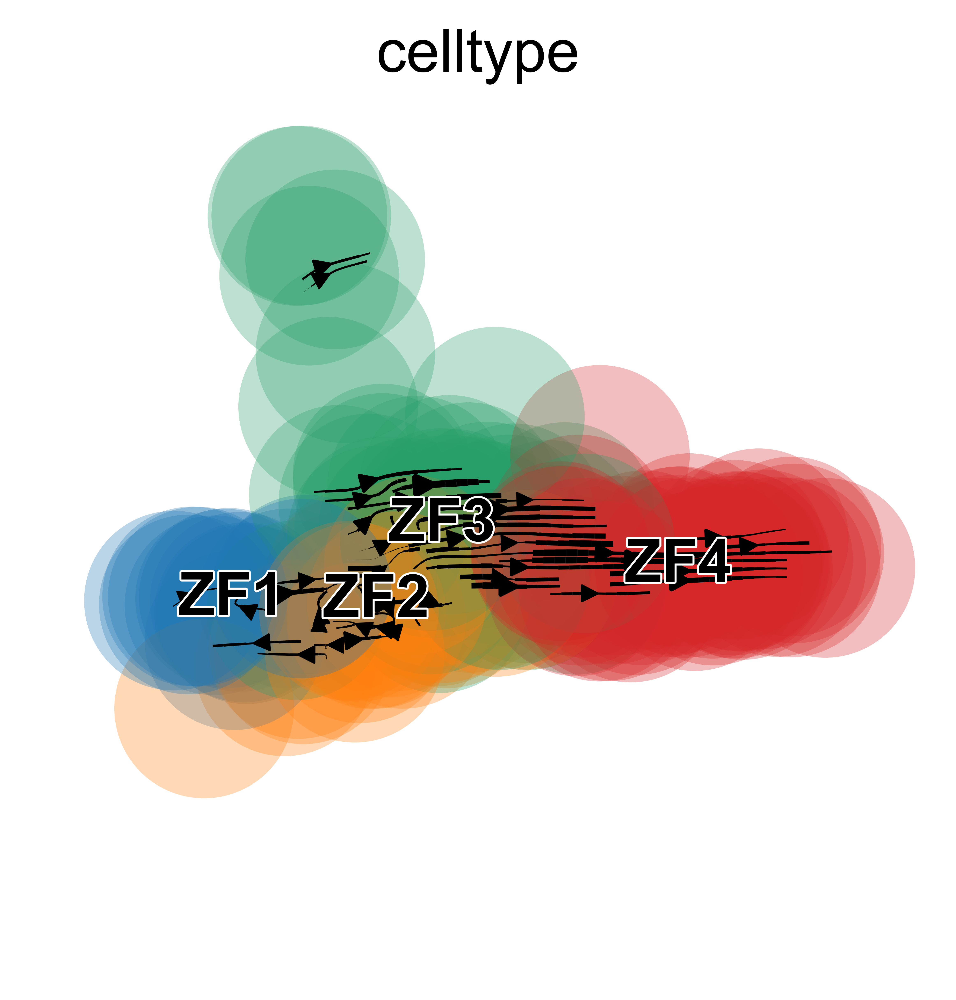

In [140]:
scv.pl.velocity_embedding_stream(
     adata_f_d, 
     basis = "diffmap", 
     color=["celltype"],  
     legend_loc="on data",
     dpi=700,
     xlim=[-0.25,0.25],
     ylim=[-0.50,0.55],
     frameon=False,
     show=False)
plt.grid(b=False)

plt.savefig(f"figures/{date}/velocyto/celltype_fish_velocyto.png", bbox_inches="tight", dpi=700)
plt.show()

# Gene Expression Dot plots

Lets plot specific genes for each cell type. We will investigate:
* Heritage
* Axon guidance
* Transcription factors
* Functional genes

In [141]:
# Add this to all dotplots to ensure same scaling of gene expression and dot sizes
extra_plot_setting = dict(vmin=0, vmax=7, dot_min=0, dot_max=1)

## Heritage

In [142]:
heritage = ["Pou4f1", "Foxd3", "Tlx3", "Lmx1b", "Prrxl1", "Ptf1a", "Lbx1", "Pax2", 
                 "Lhx1", "Lhx5", "Wt1", "Bhlhe22", "Dbx2", "Dbx1", "Evx1", "Evx2", "Pitx2", "Nr4a2", "Prdm8", "En1", "Vsx2", "Gata2",
                 "Gata3", "Sox1", "Olig3", "Prox1", "Sim1", "Mnx1", "Isl1"]

heritage_m =  {v:[v] for v in heritage}
heritage_f = orth_var_names(heritage_m, "mmusculus", "drerio")
heritage_f

{'Pou4f1': ['pou4f1'],
 'Foxd3': ['foxd3'],
 'Tlx3': ['tlx3b', 'TLX3'],
 'Lmx1b': ['lmx1ba', 'lmx1bb'],
 'Prrxl1': ['drgx'],
 'Ptf1a': ['ptf1a'],
 'Lbx1': ['lbx1b', 'lbx1a'],
 'Pax2': ['pax2b', 'pax2a'],
 'Wt1': ['wt1a', 'wt1b'],
 'Bhlhe22': ['bhlhe22'],
 'Dbx2': ['CABZ01093502.2'],
 'Dbx1': ['dbx1b'],
 'Evx1': ['evx1'],
 'Evx2': ['evx2'],
 'Pitx2': ['pitx2'],
 'Nr4a2': ['nr4a2a', 'nr4a2b'],
 'Prdm8': ['prdm8b', 'si:dkeyp-41f9.4'],
 'En1': ['en1a', 'en1b'],
 'Vsx2': ['vsx2'],
 'Gata2': ['gata2a'],
 'Gata3': ['gata3'],
 'Sox1': ['sox1a', 'sox1b'],
 'Olig3': ['olig3'],
 'Prox1': ['prox1a'],
 'Sim1': ['sim1a'],
 'Mnx1': ['mnx1'],
 'Isl1': ['isl1']}

In [143]:
heritage_f = {
    'Pou4f1': ['pou4f1'],
    'Foxd3': ['foxd3'],
    'Tlx3': ['TLX3', 'tlx3b'],
    'Lmx1b': ['lmx1bb', 'lmx1ba'],
    'Prrxl1': ['drgx'],
    'Ptf1a': ['ptf1a'],
    'Lbx1': ['lbx1b', 'lbx1a'],
    'Pax2': ['pax2b', 'pax2a'],
    'Lhx1': ['lhx1a'],
    'Lhx5': ['lhx5'],
    'Wt1': ['wt1a', 'wt1b'],
    'Bhlhe22': ['bhlhe22'],
    'Dbx2': ['CABZ01093502.2'],
    'Dbx1': ['dbx1a', 'dbx1b'],
    'Evx1': ['evx1'],
    'Evx2': ['evx2'],
    'Pitx2': ['pitx2'],
    'Nr4a2': ['nr4a2b', 'nr4a2a'],
    'Prdm8': ['prdm8b'],
    'En1': ['en1b'],
    'Vsx2': ['vsx2'],
    'Gata2': ['gata2b', 'gata2a'],
    'Gata3': ['gata3'],
    'Sox1': ['sox1b', 'sox1a'],
    'Olig3': ['olig3'],
    'Prox1': ['prox1a'],
    'Sim1': ['sim1a'],
    'Mnx1': ['mnx1'],
    'Isl1': ['isl1']}

mitigated Ptf1a gene: Ptf1a
mitigated Dbx1 gene: Dbx1
mitigated Sim1 gene: Sim1
mitigated Mnx1 gene: Mnx1


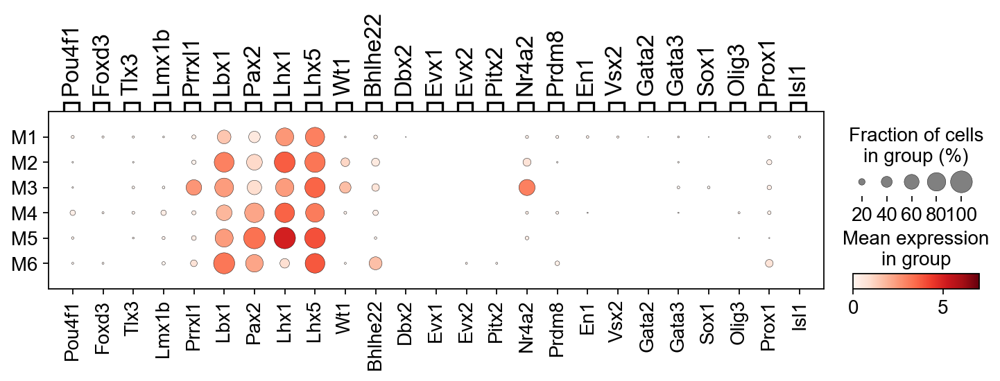

In [144]:
figure="gene_lists"
sc.settings.figdir=f"figures/{date}/{figure}"
sc.pl.dotplot(adata_m_d, groupby="celltype", var_names=filter_dict(adata_m_d, heritage_m), save="celltype_heritage_mouse.pdf", mean_only_expressed=False, **extra_plot_setting)

mitigated Ptf1a gene: Ptf1a
mitigated Dbx1 gene: Dbx1
mitigated Sim1 gene: Sim1
mitigated Mnx1 gene: Mnx1


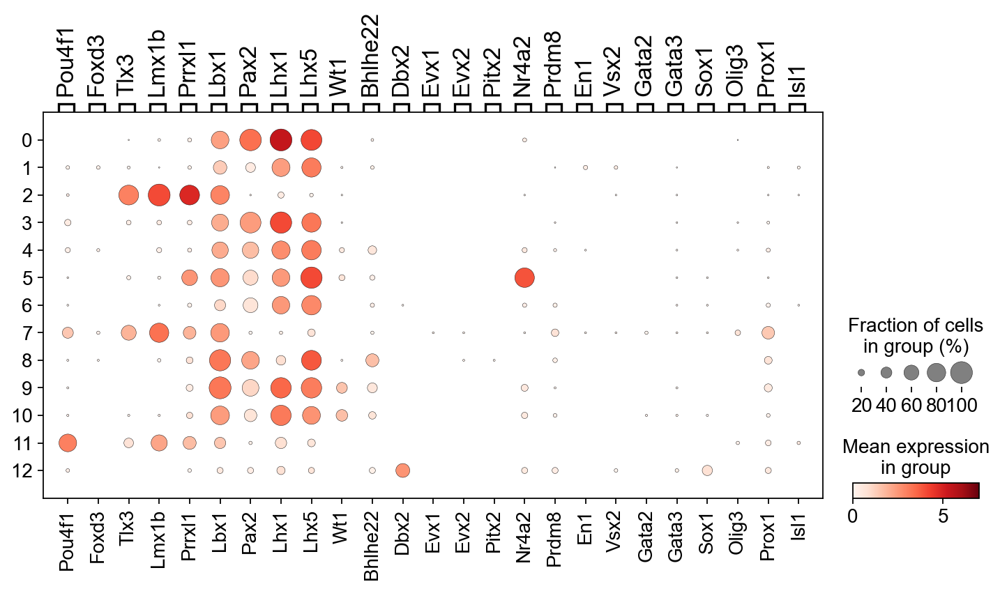

In [145]:

sc.settings.figdir=f"figures/{date}/{figure}"
sc.pl.dotplot(adata_m, groupby="leiden", var_names=filter_dict(adata_m, heritage_m), save="level_0_heritage_mouse.pdf", **extra_plot_setting)

mitigated Tlx3 gene: TLX3
mitigated Ptf1a gene: ptf1a
mitigated Dbx2 gene: CABZ01093502.2
mitigated Dbx1 gene: dbx1a
mitigated Evx1 gene: evx1


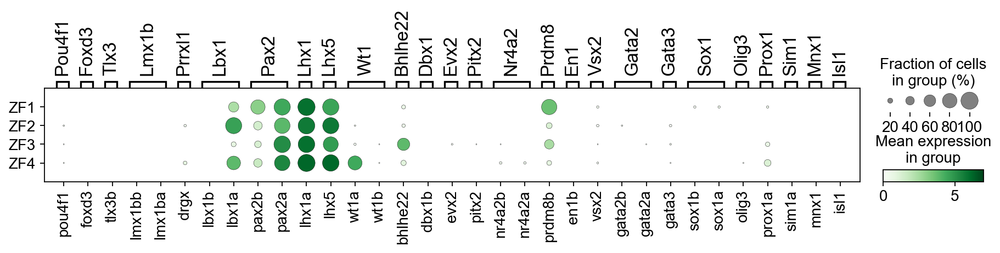

In [146]:
sc.pl.dotplot(adata_f_d, groupby="celltype", var_names=filter_dict(adata_f_d, heritage_f), mean_only_expressed=False, save="celltype_heritage_fish.pdf", **extra_plot_setting, cmap="Greens")

mitigated Tlx3 gene: TLX3
mitigated Ptf1a gene: ptf1a
mitigated Dbx2 gene: CABZ01093502.2
mitigated Dbx1 gene: dbx1a
mitigated Evx1 gene: evx1


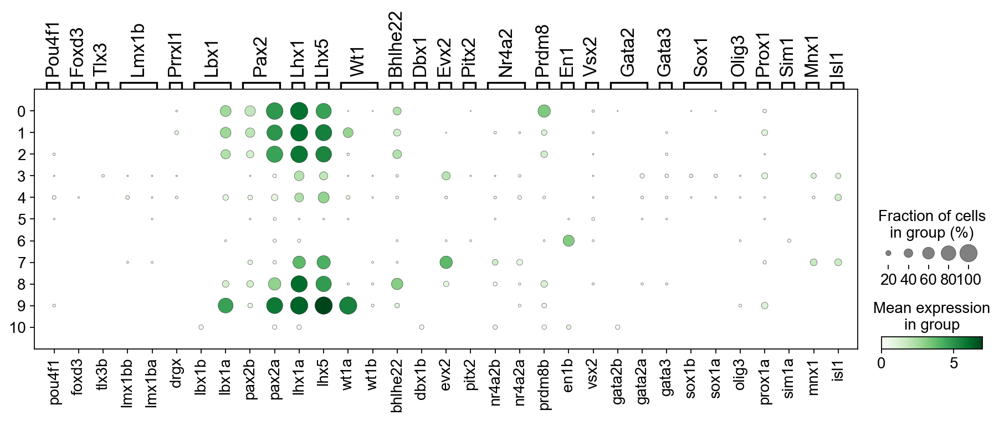

In [147]:
sc.pl.dotplot(adata_f, groupby="leiden", var_names=filter_dict(adata_f_d, heritage_f), save="level_0_heritage_fish.pdf", **extra_plot_setting, cmap="Greens")

## Axon guidance

In [148]:
axon = ['Robo1', 'Robo2', 'Robo3', 'Slit1', 'Slit2', 'Slit3', 'Slitrk1', 'Slitrk2', 'Slitrk3', 'Slitrk4', 'Slitrk5', 'Dcc', 'Ucn5a', 'Ucn5b', 'Neo1', 'Nrp1', 'Nrp2', 'Plxna1', 'Plxna2', 'Plxna4', 'Sema3f', 'Sema3b', 'Sema6a', 'Ptch1', 
        'Gli1', 'Gli2', 'Gli3', 'Ywhae', 'Hhip', 'Fzd3', 'Gdi1',
 'Ndfip1', 'Ndfip2', 'Epha4', 'Efnb3', 'Ephb2', 'L1cam', 'Ncam1', 'Cntn2', 'Dscam', 'Dscaml1', 'Dip2a',
 'Dip2b', 'Dip2c', 'Nrg2', 'Nrg3', 'Ntf3', 'Nppc', 'Npr2',  'Pac1', '"Celsr3"']
    

axon_m = {v:[v] for v in axon}
axon_f = orth_var_names(axon_m, "mmusculus", "drerio")
axon_f

{'Robo1': ['robo1'],
 'Robo2': ['robo2'],
 'Robo3': ['robo3', 'zgc:77784'],
 'Slit1': ['slit1b', 'slit1a'],
 'Slit2': ['slit2'],
 'Slit3': ['slit3'],
 'Slitrk2': ['slitrk2'],
 'Slitrk3': ['slitrk3b', 'slitrk3a'],
 'Slitrk4': ['slitrk4'],
 'Slitrk5': ['slitrk5b', 'slitrk5a'],
 'Dcc': ['dcc'],
 'Neo1': ['neo1b', 'neo1a'],
 'Nrp1': ['nrp1a'],
 'Nrp2': ['nrp2b', 'nrp2a'],
 'Plxna1': ['plxna1a', 'PLXNA1'],
 'Plxna2': ['plxna2'],
 'Sema3f': ['sema3fb', 'sema3fa'],
 'Sema3b': ['sema3b'],
 'Sema6a': ['sema6a'],
 'Ptch1': ['ptch1'],
 'Gli1': ['gli1'],
 'Gli2': ['gli2a'],
 'Gli3': ['gli3'],
 'Ywhae': ['ywhae1'],
 'Hhip': ['hhip'],
 'Fzd3': ['fzd3a', 'fzd3b'],
 'Gdi1': ['gdi1'],
 'Ndfip1': ['ndfip1', 'ndfip1l'],
 'Ndfip2': ['ndfip2'],
 'Epha4': ['epha4a', 'epha4l'],
 'Efnb3': ['efnb3a', 'efnb3b'],
 'Ephb2': ['ephb2a', 'ephb2b'],
 'L1cam': ['l1cama'],
 'Ncam1': ['ncam1a', 'ncam1b'],
 'Cntn2': ['robo4'],
 'Dscam': ['dscama', 'dscamb'],
 'Dscaml1': ['dscaml1'],
 'Dip2a': ['dip2a'],
 'Dip2b': ['dip2b

In [149]:
axon_f = {'Robo1': ['robo1'],
 'Robo2': ['robo2'],
 'Robo3': ['robo3'],
 'Slit1': ['slit1a'],
 'Slit2': ['slit2'],
 'Slit3': ['slit3'],
 'Slitrk2': ['slitrk2'],
 'Slitrk3': ['slitrk3b'],
 'Slitrk4': ['slitrk4'],
 'Slitrk5': ['slitrk5a', 'slitrk5b'],
 'Dcc': ['dcc'],
 'Unc5a':['unc5a'],
 'Unc5b':['unc5b'], 
 'Neo1': ['neo1a'],
 'Nrp1': ['nrp1a'],
 'Nrp2': ['nrp2a'],
 'Plxna1': ['plxna1a', 'PLXNA1'],
 'Plxna2': ['plxna2'],
 'Plxna4': ['plxna4'],
 'Sema3f': ['sema3fa'],
 'Sema3b': ['sema3b'],
 'Sema6a': ['CABZ01118575.1', 'sema6a'],
 'Ptch1': ['ptch1'],
 'Gli1': ['gli1'],
 'Gli2': ['gli2b'],
 'Gli3': ['gli3'],
 'Ywhae': ['ywhae1'],
 'Hhip': ['hhip'],
 'Fzd3': ['fzd3a'],
 'Gdi1': ['gdi1'],
 'Ndfip1': ['ndfip1'],
 'Ndfip2': ['ndfip2'],
 'Epha4': ['epha4a'],
 'Efnb3': ['efnb3a'],
 'Ephb2': ['ephb2b'],
 'L1cam': ['l1cama'],
 'Ncam1': ['ncam1a'],
 'Dscam': ['dscamb'],
 'Dscaml1': ['dscaml1'],
 'Dip2a': ['dip2a'],
 'Dip2b': ['dip2ba'],
 'Dip2c': ['dip2ca'],
 'Nrg2': ['nrg2b'],
 'Nrg3': ['nrg3b'],
 'Ntf3': ['ntf3'],
 'Nppc': ['nppc'],
 'Npr2': ['npr1a']}

mitigated Ucn5a gene: Ucn5a
mitigated Ucn5b gene: Ucn5b
mitigated Pac1 gene: Pac1
mitigated "Celsr3" gene: "Celsr3"


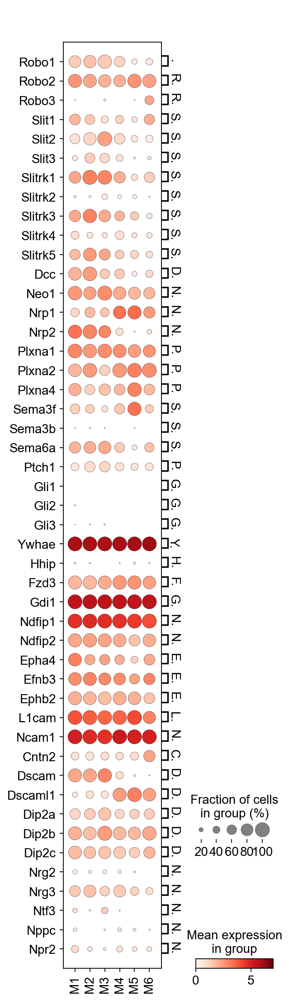

In [150]:
figure="gene_lists"
sc.settings.figdir=f"figures/{date}/{figure}"
sc.pl.dotplot(adata_m_d, groupby="celltype", var_names=filter_dict(adata_m_d, axon_m), save="celltype_axon_guidance_mouse.pdf", **extra_plot_setting, swap_axes=True)

mitigated Slitrk5 gene: slitrk5a
mitigated Dcc gene: dcc
mitigated Plxna1 gene: PLXNA1
mitigated Sema6a gene: CABZ01118575.1
mitigated Sema6a gene: sema6a
mitigated L1cam gene: l1cama


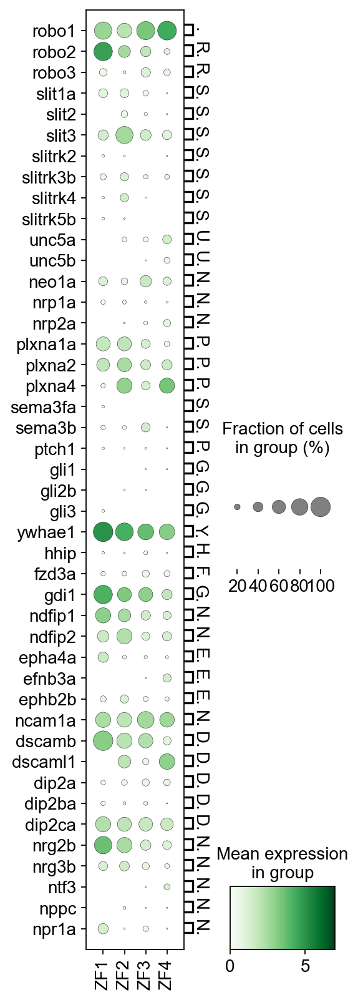

In [267]:

sc.settings.figdir=f"figures/{date}/{figure}"
sc.pl.dotplot(adata_f_d, groupby="celltype", var_names=filter_dict(adata_f_d, axon_f), save="celltype_axon_guidance_fish.pdf", **extra_plot_setting, cmap="Greens", swap_axes=True, figsize=(3.2,12))

## Neurotransmittors

In [152]:
#NT
nt_f = {"GABA": ["gad2", "slc32a1"],
      "Glycine": ["slc6a5"],
      "Glutamate": ["slc17a6a","slc17a6b"]}
      
      
nt_m = {"GABA": ["Gad2", "Slc32a1"],
      "Glycine": ["Slc6a5"],
      "Glutamate": ["Slc17a6"],
       "Others":["Cadps2", "Cplx2", "Dtnbp1", "Lin7a", "Prrt2", "Rims3", "Rph3a", "Slc1a1", "Slc25a22", "Slc36a1", "Slc5a7", "Slc6a17", "Slc6a19", "Stx1a", "Stx2", "Stx4a", "Sv2a", "Syn2", "Syn3", "Syt1", "Syt7", "Syt12", "Syt9", "Trim9", "Vamp2", "Vamp8"]}


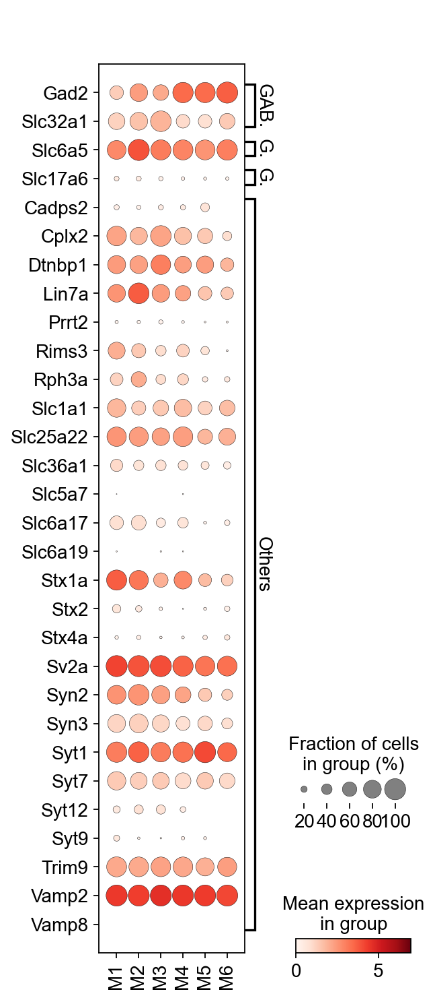

In [153]:
sc.pl.dotplot(adata_m_d, groupby="celltype", var_names=filter_dict(adata_m_d, nt_m), save="celltype_neurotransmitter_mouse.pdf", **extra_plot_setting, swap_axes=True)

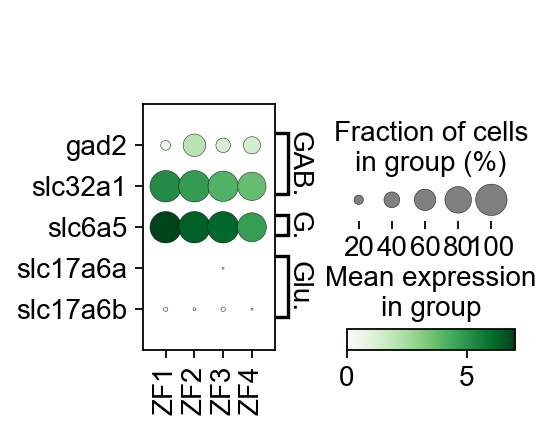

In [154]:
sc.pl.dotplot(adata_f_d, groupby="celltype", var_names=filter_dict(adata_f_d, nt_f), save="celltype_neurotransmitter_fish.pdf", **extra_plot_setting, cmap="Greens", swap_axes=True)

## Transcription factors

In [155]:
tf_m = [
    'Prrxl1',
    'Lbx1',
    'Pax2',
    'Lhx1',
    'Lhx5',
    'Dmrt3',
    'Wt1',
    'Bhlhe22',
    'Prdm8',
    'Nr4a2',
    'Irx3',
    'Irx5',
    'Gbx1',
    'Gbx2',
    'Pax8',
    'Hoxb6',
    'Hoxb8',
    'Hoxc8',
    'Hoxa9',
    'Hoxd9',
    'Hoxd10'
    ]

#tf = ["lmx1a", "msx1a", "msx2a", "pax3a", "wnt1", "irx3a", "irx5a", "pax6a", "pax7a",
#      "gsx2", "ascl1a", "gbx2", "gsx1", "dbx1a", "sp8a", "nkx6.2", "nkx6.1",
#      "foxn4", "olig2", "nkx2.2a", "nkx2.9", "foxa2", "ferd3l", "arxa", "shha", "lmx1a", "pou4f1",
#      "lhx2b", "lhx9", "barhl1a", "barhl2", "atoh1a", "foxd3", "lhx1a", "lhx5", "isl1",
#      "drgx", "otpa", "pax8", "lbx2", "pax2a", "gbx1", "bhlhe22", "ptf1a", "dmrt3a", "wt1a",
#      "evx1", "evx2", "pitx2", "en1a", "vsx2", "sox14", "sox21a", "vsx1", "tal1", "gata2a",
#      "gata3", "isl2a", "mnx1", "slc10a4", "aldh1a2", "arhgap36", "sim1a", "olig3", "dbx2", "prdm12a", "tlx3a", "lhx3", "slc18a3"]
tf_m = {v:[v] for v in tf_m}

tf_f = orth_var_names(tf_m, "mmusculus", "drerio")
tf_f

{'Prrxl1': ['drgx'],
 'Lbx1': ['lbx1b', 'lbx1a'],
 'Pax2': ['pax2b', 'pax2a'],
 'Dmrt3': ['dmrt3a'],
 'Wt1': ['wt1a', 'wt1b'],
 'Bhlhe22': ['bhlhe22'],
 'Prdm8': ['prdm8b', 'si:dkeyp-41f9.4'],
 'Nr4a2': ['nr4a2a', 'nr4a2b'],
 'Irx3': ['irx3a', 'irx3b'],
 'Irx5': ['irx5a', 'irx5b'],
 'Gbx1': ['gbx1'],
 'Gbx2': ['gbx2'],
 'Pax8': ['pax8'],
 'Hoxb6': ['hoxb6a'],
 'Hoxb8': ['hoxb8b', 'hoxb8a'],
 'Hoxc8': ['hoxc8a'],
 'Hoxa9': ['hmx4'],
 'Hoxd9': ['hoxd9a'],
 'Hoxd10': ['hoxd10a']}

In [156]:
tf_f = {'Prrxl1': ['drgx'],
 'Lbx1': ['lbx1a'],
 'Pax2': ['pax2a'],
 'Lhx1':['lhx1a'],
 'Lhx5':['lhx5'],
 'Dmrt3': ['dmrt3a'],
 'Wt1': ['wt1a'],
 'Bhlhe22': ['bhlhe22'],
 'Prdm8': ['prdm8b'],
 'Nr4a2':['nr4a2a', 'nr4a2b'],
 'Irx3': ['irx3b'],
 'Irx5': ['irx5a'],
 'Gbx1': ['gbx1'],
 'Gbx2': ['gbx2'],
 'Pax8': ['pax8'],
 'Hoxb6': ['hoxb6a'],
 'Hoxb8': ['hoxb8a'],
 'Hoxc8': ['hoxc8a'],
 'Hoxa9': ['hoxa9a'],
 'Hoxd9': ['hoxd9a'],
 'Hoxd10': ['hoxd10a']}

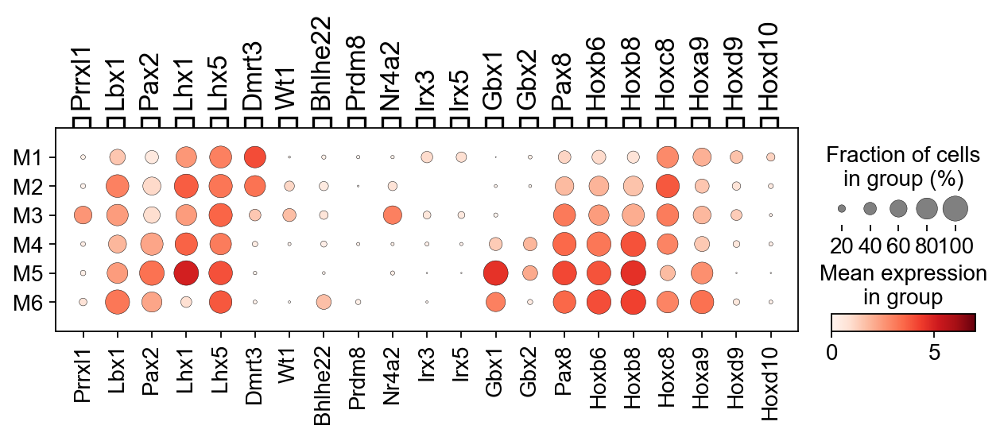

In [157]:
sc.pl.dotplot(adata_m_d, groupby="celltype", var_names=filter_dict(adata_m_d, tf_m), save="celltype_transcription_factor_mouse.pdf", **extra_plot_setting)

mitigated Gbx1 gene: gbx1


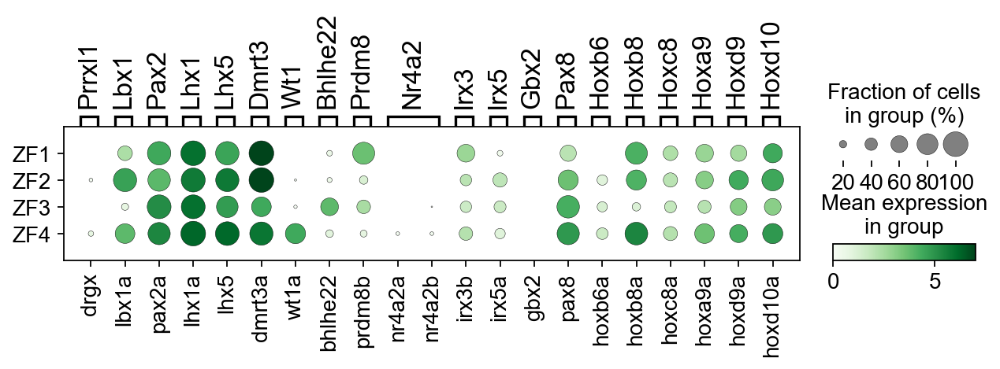

In [158]:
sc.pl.dotplot(adata_f_d, groupby="celltype", var_names=filter_dict(adata_f_d, tf_f), save="celltype_transcription_factor_fish.pdf", **extra_plot_setting, cmap="Greens")

## Functional

In [250]:
func = [
    "Hcn1", "Hcn3", "Hcn4",
    "Scn1a", "Scn2b", "Scn8a",
    "Kcnh2", "Kcnd2", "Kcnab2", "Cacng3", "Kcna6", "Kcnb1", "Kcnc1", "Cacnb4", "Kcnh3", "Kcna1",
    "Slc1a4",
    "Ank1",
    "Meis2",
    "Chn1",
    "Rac3",
    "Ets2",
    "Epha4",
    "Nkain1",
    "Atf6",
    "Cacna2d3",  "Cacng2",
    "Pde4b",
    "Chrm2",
    "Gpm6a",
    "Myt1l",
    "Mxi1",
    "Arf2",
    "Dtnbp1", "Lin7a", "Rims3", "Rph3a", "Stx1a", "Sv2a", "Syn2", "Syn3", "Syt1", "Trim9", "Vamp2",
        "Chrm2", "Gabar1", "Gabra2", "Gabra3", "Gabra5", "Gabrb2", "Gabrb3", "Gabrg1", "Gabrg2", 
                      "Gria2", "Gria4", "Grid1", "Grik1", "Grik2", "Grik4", "Grik5", "Grin1", "Grin3a", "Grip1", "Grm7", "Grm8",
         "Cachd1", "Cacna1b", "Cacna2d3", "Cacnb1", "Cacnb3", "Cacng2", "Cacng3", 
                          "Kcna6", "Kcnb1", "Kcnc1", "Kcnd2", "Kcnh2", "Kcnh7", "Kcnh8", 
                          "Kcnip1", "Kcnip2", "Kcnt1", "Scn2b", "Scn3b", "Scn4b", "Scn9a",
         "Gabarapl2", "Gabbr1", "Gabbr2", "Glrb", "Gria3", "Grm4"
]
test_f = {
    "FRmax":["Scn1a", "Limch1"],
    "Rin":["Cacnb4", "Nkain1"],
    "Vrest":["Hcn3", "Kcnh2"],
    "APamp":["Meis2", "Epha4"],
    "Voltage-gated ion channels": ["Cachd1", "Cacna1b", "Cacna2d3", "Cacnb1", "Cacnb3", "Cacnb4", "Cacng2", "Cacng3","Hcn1", "Hcn4",  
                          "Kcna6", "Kcnb1", "Kcnc1", "Kcnd2", "Kcnh2", "Kcnh7", 
                          "Kcnip1", "Kcnt1", "Scn3b", "Scn9a"]
    }

func_m = {v:[v] for v in func}
func_f = orth_var_names(func_m, "mmusculus", "drerio")
func_f

test_f_f = orth_var_names(test_f, "mmusculus", "drerio")
test_f_f

ConnectionError: HTTPSConnectionPool(host='biit.cs.ut.ee', port=443): Max retries exceeded with url: /gprofiler/api/orth/orth (Caused by NewConnectionError('<urllib3.connection.HTTPSConnection object at 0x000002A04190FCA0>: Failed to establish a new connection: [WinError 10060] A connection attempt failed because the connected party did not properly respond after a period of time, or established connection failed because connected host has failed to respond'))

In [257]:
test_f_f = {'FRmax': ['scn1a', 'limch1a'],
 'Rin': ['cacnb4b', 'nkain1'],
 'Vrest': ['hcn3', 'kcnh2a'],
 'APamp': ['meis2a','epha4a'],
 'Voltage-gated ion channels': [
    'cacna2d3',
    'cacna2d3',
    'cacnb3a',
    'cacnb3b',
    'cacnb4a',
    'cacnb4b',
    'cacng2a',
    'cacng3a',
    'cacng3b',
    'hcn1',
    'hcn4',
    'hcn4l',
    'kcnab2a',
    'kcnc1a',
    'kcnc1b',
    'kcnd1',
    'kcnh2',
    'kcnh7',
    'KCNIP1',
    'kcnip1b',
    'kcnt1',
    'kcnt1',
    'scn3b',
    'scn8ab']}

In [161]:
func_f = {'Hcn1': ['hcn1'],
 'Hcn2': ['CABZ01086574.1', 'hcn2b'],
 'Hcn4': ['hcn4l', 'hcn4'],
 'Scn2b': ['scn2b'],
 'Scn8a': ['scn8ab', 'scn8aa'],
 'Kcnh2': ['kcnh2a', 'KCNH2'],
 'Cacna1a': ['cacna1ab', 'cacna1aa'],
 'Cacna1d': ['cacna1db', 'cacna1da'],
 'Cacna2d3': ['CACNA2D3', 'cacna2d3'],
 'Cacnb4': ['cacnb4a'],
 'Pde4b': ['pde4bb', 'pde4ba'],
 'Drd2': ['drd2l'],
 'Chrm2': ['chrm2a', 'chrm2b'],
 'Ank1': ['ank1a', 'ank1b'],
 'Meis2': ['meis2a'],
 'Epha4': ['epha4l', 'epha4a'],
 'Chn1': ['chn1'],
 'Rac3': ['rac3a', 'rac3b'],
 'Kcnd2': ['kcnd2'],
 'Gabra1': ['gabra1'],
 'Kcnab2': ['kcnab2a', 'kcnab2b'],
 'Itpr1': ['itpr1a', 'itpr1b'],
 'Kcna1': ['kcna1b', 'kcna1a'],
 'Thy1': ['si:dkeyp-69c1.7', 'thy1'],
 'Atf6': ['atf6'],
 'Atp2a2': ['atp2a2b']}

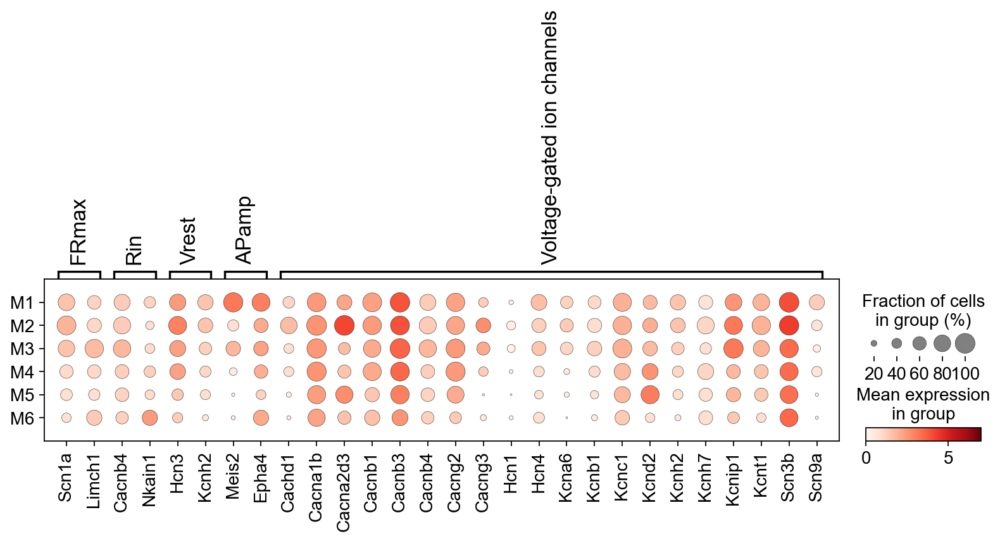

In [258]:
sc.pl.dotplot(adata_m_d, groupby="celltype", var_names=filter_dict(adata_m_d, test_f), save="celltype_functional_mouse.pdf", **extra_plot_setting)

mitigated Voltage-gated ion channels gene: cacng3a
mitigated Voltage-gated ion channels gene: kcnh2


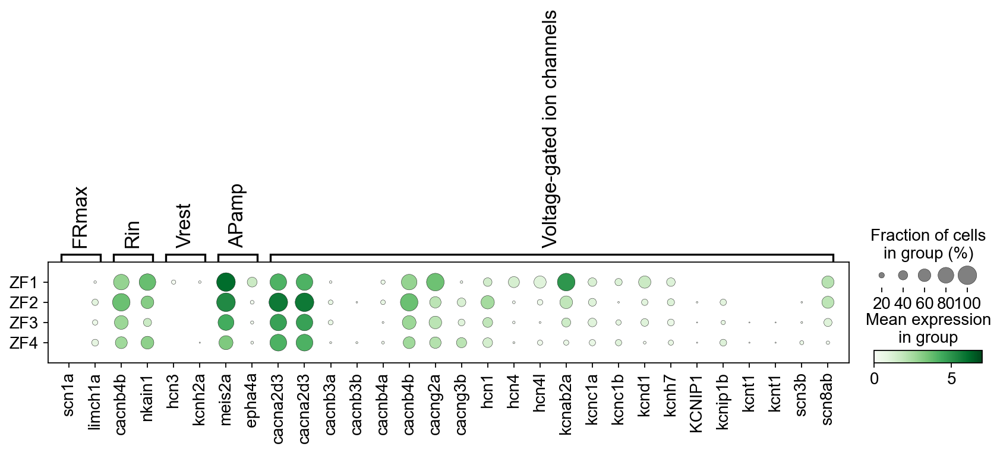

In [259]:
sc.pl.dotplot(adata_f_d, groupby="celltype", var_names=filter_dict(adata_f_d, test_f_f), save="celltype_functional_fish.pdf", **extra_plot_setting, cmap="Greens")

## Ligands and receptors using gene lists
here we will make a list of genes representing different ligands and receptors.


In [260]:
ligands_m = {
    "Glycine/GABA": ['Gad1', 'Gad2', 'Slc6a1', 'Slc6a5','Slc32a1'],
    "Glutamate": ['Slc17a6', 'Slc17a7', 'Slc17a8'], 
    "Neuropeptide Y": ['Npy'], 
    "Nociceptin": ['Pnoc'], 
    "BAM8-22": ['Penk'],  
    "Dynorphin B": ['Pdyn'],
    "β-endorphin": ['Pomc'],
    "Somatostatin": ['Sst'],
    #"Transport":["Dtnbp1", "Lin7a", "Rims3", "Rph3a", "Stx1a", "Sv2a", "Syn2", "Syn3", "Syt1", "Trim9", "Vamp2"]
}

ligands_f = orth_var_names(ligands_m, "mmusculus", "drerio")
ligands_f

ConnectionError: HTTPSConnectionPool(host='biit.cs.ut.ee', port=443): Max retries exceeded with url: /gprofiler/api/orth/orth (Caused by NewConnectionError('<urllib3.connection.HTTPSConnection object at 0x000002A03E68C760>: Failed to establish a new connection: [WinError 10060] A connection attempt failed because the connected party did not properly respond after a period of time, or established connection failed because connected host has failed to respond'))

In [261]:
ligands_f = {'Glycine/GABA': [
    'gad1a',
    'gad1b',
    'gad2',
    'slc6a1a',
    'slc6a1b',
    'slc6a5',
    'slc32a1',
  ],
 'Glutamate': ['slc17a6b', 'slc17a7b', 'slc17a6a', 'slc17a7a'],
 'Neuropeptide Y': ['npy'],
 'Nociceptin': ['pnoca', 'pnocb'],
 'BAM8-22': ['penka', 'penkb'],
 'Dynorphin B': ['pdyn'],
 'β-endorphin': ['pomcb', 'pomca'],
 'Somatostatin': ['sst1.1', 'sst1.2']}

mitigated Glutamate gene: Slc17a7


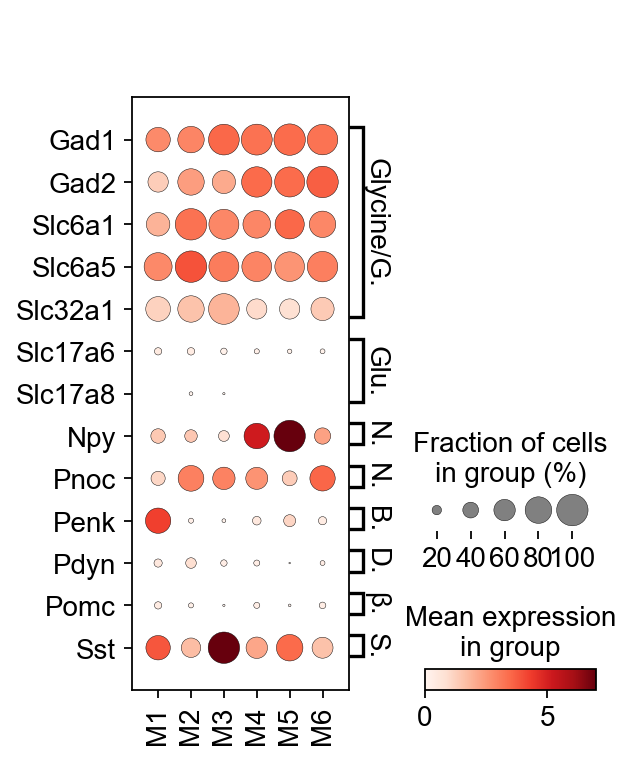

In [262]:
sc.pl.dotplot(adata_m_d, groupby="celltype", var_names=filter_dict(adata_m_d, ligands_m), save="celltype_ligands_mouse.pdf", **extra_plot_setting, swap_axes=True)

mitigated Glutamate gene: slc17a7a
mitigated BAM8-22 gene: penka
mitigated β-endorphin gene: pomcb
mitigated Somatostatin gene: sst1.2


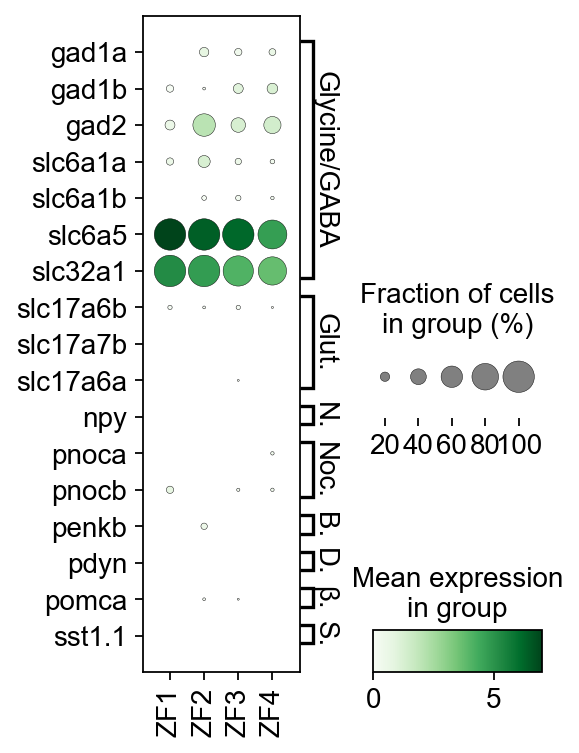

In [263]:
sc.pl.dotplot(adata_f_d, groupby="celltype", var_names=filter_dict(adata_f_d, ligands_f), save="celltype_ligands_fish.pdf", **extra_plot_setting, cmap="Greens", swap_axes=True, figsize=(3.2,5))

In [167]:
receptors_m = {
    "GABA": ['Gabbr1','Gabbr2', 'Gabra1', 'Gabra2', 'Gabra5', 'Gabrb3'],
    "Glycine": ['Glra1', 'Glra2', 'Glra3'],
    "Glutamate": ['Grm7', 'Grm8', "Gria3","Gria4", "Grid1", "Grik2"],
    "Serotonin": ['Htr7'],
    "Acetylcholine": ['Chrna5', 'Chrna6', 'Chrna7', 'Chrm2'],
    "Somatostatin": ['Sstr1'],
    "Adrenoceptor": ['Adra1a', 'Adra1b'],
    "RXFP2": ['Rxfp2'],
    "V2 receptor": ['Avpr2'],
    "L-Tyrosine hydroxylase": ['Th'],
    "Nuclear receptor related 1": ['Nr4a2'],
    "Opioid receptor": ['Oprd1', 'Oprk1', 'Oprm1'],
    "Gap junction": ['Gjd2']
}

receptors_f = orth_var_names(receptors_m, "mmusculus", "drerio")
receptors_f

{'GABA': ['gabra2a',
  'gabbr1b',
  'gabra5',
  'gabbr2',
  'gabbr1a',
  'LO018287.1',
  'gabrb1',
  'gabra1',
  'CR855311.6'],
 'Glycine': ['glra1', 'glra2', 'glra3'],
 'Glutamate': ['GRIK2',
  'gria4b',
  'grm8b',
  'grid1b',
  'CR974456.1',
  'grid1a',
  'grm8a',
  'GRM7'],
 'Serotonin': ['HTR7', 'htr7a'],
 'Acetylcholine': ['chrm2b',
  'chrm2a',
  'FO907089.1',
  'chrna7',
  'chrna5',
  'chrna6'],
 'Somatostatin': ['sstr1a'],
 'Adrenoceptor': ['adra1ba', 'adra1aa', 'adra1bb'],
 'RXFP2': ['rxfp2b', 'rxfp2a'],
 'V2 receptor': ['avpr2aa', 'avpr2ab'],
 'L-Tyrosine hydroxylase': ['th'],
 'Nuclear receptor related 1': ['nr4a2a', 'nr4a2b'],
 'Opioid receptor': ['oprd1b', 'oprk1', 'oprm1', 'oprd1a'],
 'Gap junction': ['gjd1a']}

In [168]:
receptors_f = {
    'GABA': ['gabbr1b', 'gabbr1a', 'CR855311.6', 'gabbr2','gabra1','gabra5','gabrb3'
             'gabrb1', 'LO018287.1', 'gabra2a'],
 'Glycine': ['glra1', 'glra2', 'glra3'],
 'Glutamate': ['GRM7','CR974456.1','grm8a','grm8b','gria4b',
  'grid1b', 'GRIK2','grid1a','chrm2b'],
 'Serotonin': ['htr7a', 'HTR7'],
 'Acetylcholine': ['chrna7',
  'chrm2a',
  'chrna6',
  'FO907089.1',
  'chrna5',
  'chrm2b'],
 'Somatostatin': ['sstr1a'],
 'Adrenoceptor': ['adra1bb', 'adra1ba', 'adra1aa'],
 'RXFP2': ['rxfp2b', 'rxfp2a'],
 'V2 receptor': ['avpr2ab', 'avpr2aa'],
 'L-Tyrosine hydroxylase': ['th'],
 'Nuclear receptor related 1': ['nr4a2b', 'nr4a2a'],
 'Opioid receptor': ['oprd1a','oprd1b', 'oprk1','oprm1' ],
 'Gap junction': ['gjd1a', 'gjd2b']
     }

mitigated Acetylcholine gene: Chrna6


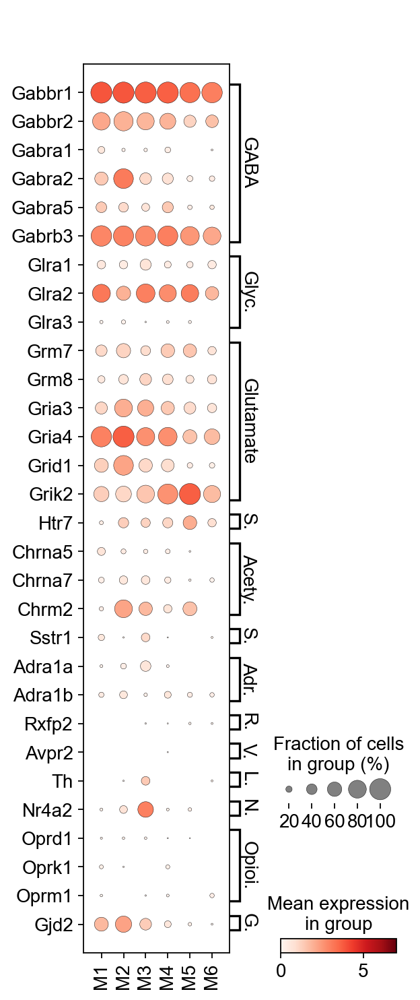

In [169]:
sc.pl.dotplot(adata_m_d, groupby="celltype", var_names=filter_dict(adata_m_d, receptors_m), save="celltype_receptors_mouse.pdf", **extra_plot_setting, swap_axes=True)

mitigated GABA gene: CR855311.6
mitigated GABA gene: gabrb3gabrb1
mitigated GABA gene: LO018287.1
mitigated GABA gene: gabra2a
mitigated Glutamate gene: GRM7
mitigated Glutamate gene: CR974456.1
mitigated Glutamate gene: GRIK2
mitigated Glutamate gene: chrm2b
mitigated Serotonin gene: htr7a
mitigated Serotonin gene: HTR7
mitigated Acetylcholine gene: FO907089.1
mitigated Acetylcholine gene: chrm2b
mitigated V2 receptor gene: avpr2ab
mitigated L-Tyrosine hydroxylase gene: th


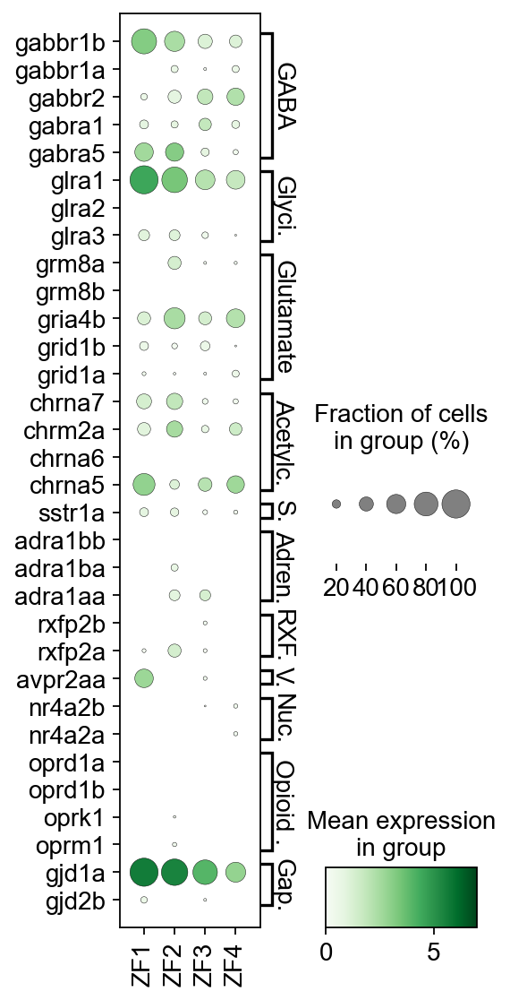

In [170]:
sc.pl.dotplot(adata_f_d, groupby="celltype", var_names=filter_dict(adata_f_d, receptors_f), save="celltype_receptors_fish.pdf", **extra_plot_setting, cmap="Greens", swap_axes=True, figsize=(3.2,8))